## Install libraries, and build modules

In [4]:
#Dependency List

# !pip install tensorflow
# !pip install graphtools
# !pip install igraph 
# !pip install cairocffi 
# !pip install icecream
# !pip install loguru
# !pip install POT
# !pip install pandas
# !pip install matplotlib
# !pip install seaborn
#!pip install matlabengine

  Using cached matlabengine-24.1.2-py3-none-any.whl


In [1]:
#Install the libraries

from sklearn.neighbors import NearestNeighbors, KNeighborsClassifier, kneighbors_graph
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.inspection import permutation_importance
from scipy.spatial.distance import pdist, squareform
import cairocffi
import graphtools
import random
import numpy as np
import pandas as pd
from sklearn.preprocessing import MinMaxScaler,OneHotEncoder
import matplotlib.pyplot as plt
import igraph as ig
from sklearn.manifold import MDS
import seaborn as sns
from sklearn import datasets
from mali import MALI
from nama import NAMA
from DTA_andres import DTA
#import tensorflow as tf
from phate import PHATE
import vne
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix, mean_squared_error

2024-06-14 12:37:54.957830: I external/local_tsl/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2024-06-14 12:37:54.963797: I external/local_tsl/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2024-06-14 12:37:55.066925: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-06-14 12:37:57.147742: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


In [2]:
def print_feature_importance(features, labels):
    # Splitting the dataset into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(features, labels, test_size=0.2, random_state=42)

    # Training the RandomForest Classifier
    clf = RandomForestClassifier(random_state=42)
    clf.fit(X_train, y_train)

    result = permutation_importance(clf, X_test, y_test, n_repeats=30, random_state=42)
    # Get the indices that would sort the importances
    sorted_idx = result.importances_mean.argsort()

    # Print the feature importance in ascending order
    for idx in sorted_idx:
        print(f"Feature {idx}, Importance: {result.importances_mean[idx]:.4f}")

In [3]:
#Instead of including the file, I just pasted the text so I can have it all on the Google Collab

def dataprep(data, label_col_idx = 0, transform = 'normalize', cat_to_numeric = True):

    # TODO: Fix cat_to_numeric; only apply to labels
    """
    This method normalizes (default) or standardizes all non-categorical variables in an array.
    All categorical variables are kept.

    If tranform = "normalize", categorical varibles are scaled from 0 to 1. The highest value
    is assigned the value of 1, the lowest value a will be assigned to 0.

    """

    data = data.copy()
    categorical_cols = []
    for col in data.columns:
        if data[col].dtype == 'object' or data[col].dtype == 'int64':
            categorical_cols.append(col)
            if cat_to_numeric:
                data[col] = pd.Categorical(data[col]).codes


    if label_col_idx is not None:
        label = data.columns[label_col_idx]
        y     = data.pop(label)
        x     = data


    if transform == 'standardize':
        for col in x.columns:
            # if col not in categorical_cols:
            if data[col].std() !=0:
                data[col] = (data[col] - data[col].mean()) / data[col].std()

    elif transform == 'normalize':
        for col in x.columns:
            # if col not in categorical_cols:
            if data[col].max() != data[col].min():
                data[col] = (data[col] - data[col].min()) / (data[col].max() - data[col].min())

    if label_col_idx is None:
        return np.array(x)
    else:
        return np.array(x), np.array(y) # Updated y to array

In [4]:
#If we want to use a different data set than the Iris dataset
def make_swiss_s(n_samples = 100, noise = 0, random_state = None, n_categories = 3, return_locs = False):
    x_swiss, t_swiss = datasets.make_swiss_roll(n_samples = n_samples,
                                                noise = noise,
                                                random_state = random_state)


    x_s, t_s = datasets.make_s_curve(n_samples = n_samples,
                                     noise = noise,
                                     random_state = random_state)


    scaler = MinMaxScaler()
    # t_swiss = scaler.fit_transform(t_swiss.reshape(-1, 1))
    # t_s = scaler.fit_transform(t_s.reshape(-1, 1))


    if n_categories is not None:

        # cuts_swiss = pd.cut(t_swiss.squeeze(), bins = n_categories)
        # mapper_swiss = {cuts_swiss.categories[i]: i for i in range(len(cuts_swiss.categories))}
        # categories_swiss = cuts_swiss.map(mapper_swiss)

        # cuts_s = pd.cut(t_s.squeeze(), bins = n_categories)
        # mapper_s = {cuts_s.categories[i]: i for i in range(len(cuts_s.categories))}
        # categories_s = cuts_s.map(mapper_s)

        categories_swiss = pd.qcut(t_swiss.squeeze(), labels = False, q = n_categories)
        categories_s = pd.qcut(t_s.squeeze(), labels = False, q = n_categories)

        if return_locs:
            return (x_swiss, x_s), (categories_swiss, categories_s), (t_swiss, t_s)


        return (x_swiss, x_s), (categories_swiss, categories_s)




    return (x_swiss, x_s), (pd.Series(t_swiss), pd.Series(t_s))

In [5]:
def FOSCTTM(Wxy): #Wxy should be just the parrallel matrix

    n1, n2 = np.shape(Wxy)
    if n1 != n2:
        raise AssertionError('FOSCTTM only works with a one-to-one correspondence. ')

    dists = Wxy

    nn = NearestNeighbors(n_neighbors = n1, metric = 'precomputed')
    nn.fit(dists)

    _, kneighbors = nn.kneighbors(dists)

    return np.mean([np.where(kneighbors[i, :] == i)[0] / n1 for i in range(n1)])

In [6]:
def cross_embedding_knn(embedding, Y, knn_args = {'n_neighbors': 1}):
    (y1, y2) = Y

    n1, n2 = len(y1), len(y2)

    knn = KNeighborsClassifier(**knn_args)
    knn.fit(embedding[:n1, :], y1)

    return knn.score(embedding[n1:, :], y2)

In [7]:
def normalize_0_to_1(value):
    return (value - value.min()) / (value.max() - value.min())

In [8]:
def drop_labels(y, pct_kept, drop_value = -1, require_all = False, random_state = None):

    y = np.copy(y)
    n = len(y)
    n_drop = int(((1 - pct_kept) * n))
    drop_bool = np.zeros(n).astype(bool)

    np.random.seed(random_state)
    drop_idx = np.random.choice(range(n), size = n_drop, replace = False)
    drop_bool[drop_idx] = 1

    print('type(y): ', type(y))
    y[drop_bool] = drop_value

    return y

In [9]:
def knn_classifier_test(features, labels, show_confusion=True, knn =5):   
    #Testing the Data against ML Models... We split the heart labels in half because we double it earlier
    X_train, X_test, y_train, y_test = train_test_split(features, labels, test_size=0.3, random_state=42) #NOTE: Should we be splitting this because it learns from the emb

    #Create a linear regression model
    LR_model = LogisticRegression()
    LR_model.fit(X_train, y_train)
    y_pred = LR_model.predict(X_test)
    print(f"Linear Regression R^2 score: {LR_model.score(X_test, y_test)}, and MSE score: {mean_squared_error(y_test, y_pred)}")

    #Create and fit KNN model
    knn_model = KNeighborsClassifier(n_neighbors=knn)
    knn_model.fit(X_train, y_train)
    y_pred = knn_model.predict(X_test)
    print(f"KNN accuracy score: {accuracy_score(y_test, y_pred)}")


    print("---------------------------------------------------")

    if show_confusion:
        #Grab unique labels
        tick_labels = range(labels.min(), labels.max() + 1)

        #Show Confusion matrix (Because they are bomb!)
        plt.figure(figsize=(10, 7))
        sns.heatmap(confusion_matrix(y_test, y_pred), fmt='d', annot = True, cmap='Blues', xticklabels=tick_labels, yticklabels=tick_labels)
        plt.title('KNN Confusion Matrix')
        plt.show()


In [10]:
def knn_classifier_test_with_data_split(X_train, X_test, y_train, y_test, show_confusion=True, knn =5):   
    #Create a linear regression model
    LR_model = LogisticRegression()
    LR_model.fit(X_train, y_train)
    y_pred = LR_model.predict(X_test)
    print(f"Linear Regression R^2 score: {LR_model.score(X_test, y_test)}, and MSE score: {mean_squared_error(y_test, y_pred)}")

    #Create and fit KNN model
    knn_model = KNeighborsClassifier(n_neighbors=knn)
    knn_model.fit(X_train, y_train)
    y_pred = knn_model.predict(X_test)
    print(f"KNN accuracy score: {accuracy_score(y_test, y_pred)}")


    print("---------------------------------------------------")

    if show_confusion:
        #Show Confusion matrix (Because they are bomb!)
        plt.figure(figsize=(10, 7))
        sns.heatmap(confusion_matrix(y_test, y_pred), fmt='d', annot = True, cmap='Blues')
        plt.title('KNN Confusion Matrix')
        plt.show()

In [11]:
def knn_classifier_test2(train_features, train_labels, test_features, test_labels, show_confusion=True, knn =5):   
    '''NOTE: Currently this does not fulfill its purpose
    Further tweaking is necessary'''
    
    #Create a linear regression model
    LR_model = LogisticRegression()
    LR_model.fit(train_features, train_labels)
    y_pred = LR_model.predict(test_features)
    print(f"Linear Regression R^2 score: {LR_model.score(test_features, test_labels)}, and MSE score: {mean_squared_error(test_labels, y_pred)}")

    #Create and fit KNN model
    knn_model = KNeighborsClassifier(n_neighbors=knn)
    knn_model.fit(train_features, train_labels)
    y_pred = knn_model.predict(test_features)
    print(f"KNN accuracy score: {accuracy_score(test_labels, y_pred)}")


    print("---------------------------------------------------")

    if show_confusion:
        #Grab unique labels
        tick_labels = range(train_labels.min(), train_labels.max() + 1)

        #Show Confusion matrix (Because they are bomb!)
        plt.figure(figsize=(10, 7))
        sns.heatmap(confusion_matrix(test_labels, y_pred), fmt='d', annot = True, cmap='Blues', xticklabels=tick_labels, yticklabels=tick_labels)
        plt.title('KNN Confusion Matrix')
        plt.show()

In [12]:
def neural_network_test(features, labels, data_shape = (4,)):
    # Split the dataset into training and test sets
    X_train, X_test, y_train, y_test = train_test_split(features, labels, test_size=0.2, random_state=42)

    # Define the model
    model = tf.keras.Sequential([
        tf.keras.layers.Dense(10, activation='relu', input_shape=data_shape),  # Input layer
        tf.keras.layers.Dense(10, activation='relu'),  # Hidden layer
        tf.keras.layers.Dense(3, activation='softmax')  # Output layer
    ])

    # Compile the model
    model.compile(optimizer='adam',
                loss='MSE',
                metrics=['accuracy'])

    # Train the model
    history = model.fit(X_train, y_train, epochs=50, verbose = None)

    # Evaluate the model
    loss, accuracy = model.evaluate(X_test, y_test)
    print(f"Test loss: {loss}, Test accuracy: {accuracy}")

    # Optionally, make predictions
    # predictions = model.predict(X_test)
    # print(predictions) # Uncomment to see predictions


In [14]:
#####DO NOT FORGET ABOUT THIS######
import warnings

# Ignore a specific RuntimeWarning by matching the message text
#warnings.filterwarnings("ignore", category=RuntimeWarning, message="Detected zero distance between samples*")
#warnings.filterwarnings("ignore", category=RuntimeWarning, module='graphtools')
warnings.filterwarnings("ignore", category=RuntimeWarning)

#This one is pretty safe all the time... just be aware of it
warnings.filterwarnings("ignore", category=FutureWarning,
                        message="The default value of `normalized_stress` will change to `'auto'` in version 1.4.*",
                        module=r'sklearn\.manifold\._mds')


In [15]:
mds = MDS(metric=True, dissimilarity = 'precomputed', random_state = 42, n_components=2)

### Prep Iris Data Set

In [16]:
labels1 = pd.read_csv("/yunity/arusty/Graph-Manifold-Alignment/CSV Files/iris.csv")["species"]
labels = np.concatenate([labels1, labels1])

In [17]:
#Create scalar
scaler = MinMaxScaler()

X, labels1 = dataprep(pd.read_csv("/yunity/arusty/Graph-Manifold-Alignment/CSV Files/iris.csv")) #Make sure to upload the file :)
#X = scaler.fit_transform(X)

#Make a second data set with noise and slight changes
Y, labels2 = X, labels1

# Add random noise to the copied dataset. Notice the labels remain unchagned
Y = Y + np.random.normal(scale = 0.05, size = np.shape(Y))

#n1 is the number of flowers (150). d1 is the number of measurements per flower (4)
n1, d1 = np.shape(X)

#For ease
labels = np.concatenate([labels1, labels2])

# Creating random anchor points
rand_ints = random.sample(range(n1), 15) #The second number here determines how many Known anchors we want
known_anchors = np.vstack([rand_ints, rand_ints]).T

/yunity/arusty/.local/lib/python3.10/site-packages/ot/bregman/_sinkhorn.py:531: UserWarning: Sinkhorn did not converge. You might want to increase the number of iterations `numItermax` or the regularization parameter `reg`.
  warnings.warn("Sinkhorn did not converge. You might want to "
ic| mali.py:174 in fit() at 08:21:50.789


optimal t:  19
optimal t:  20


/yunity/arusty/.local/lib/python3.10/site-packages/ot/bregman/_sinkhorn.py:531: UserWarning: Sinkhorn did not converge. You might want to increase the number of iterations `numItermax` or the regularization parameter `reg`.
  warnings.warn("Sinkhorn did not converge. You might want to "


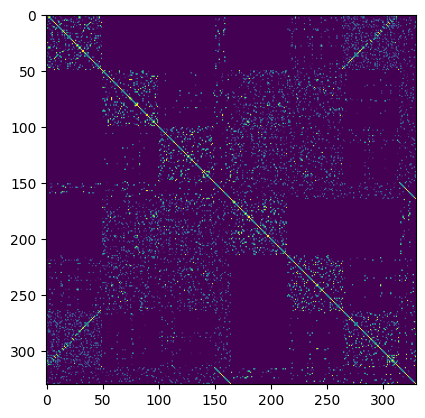

In [18]:
#For comparision, also fit the data to Nama and Mali
nama = NAMA(ot_reg = 0.001)
nama.fit(known_anchors, X, Y)

mali = MALI()
mali.fit((X, Y), (labels1, labels2))

"""#DTA by Prof
dta = DTA(met = 'mali')
dta_iris = dta.fit(X, Y, labels1 = labels1, labels2 = labels2)
"""

#DTA-Andres Prep
d_iris = DTA(knn=5,
             decay=40,
             knn_dist="euclidean",
             knn_max=None, #Could matter with MNist data
             distances="DPT",
             #entR = 0.001, #This did not help
             distance = 'cosine')

#Shared D1 needs to be a subset of X.. and SharedD2 needs to be a subset of Y
_sharedD1 = X[rand_ints]
_sharedD2 = Y[rand_ints]
_labelsh1 = labels1[rand_ints]
_labelsh2 = labels2[rand_ints]

#Fit the dta -> Note, I did edit the file a little bit
d_iris.fit( X, Y, sharedD1 = _sharedD1, sharedD2 = _sharedD2, 
            labels1 = None, labels2 = None, labelsh1 = None, labelsh2 = None) #Using the labels seems to break my computer -- its too difficult?

#Note that it is extra big? The random anchors are added to the matrix so it will be 300 + anchors by 300 by anchors
plt.imshow(d_iris.W)

In [19]:
print_feature_importance(X, labels1)

Feature 0, Importance: 0.0000
Feature 1, Importance: 0.0000
Feature 3, Importance: 0.2056
Feature 2, Importance: 0.2422


In [20]:
#Covariance is low
np.cov((X[1], X[0], X[2]))

array([[0.0292432 , 0.04602969, 0.03672265],
       [0.04602969, 0.07250947, 0.05802925],
       [0.03672265, 0.05802925, 0.04763171]])

In [21]:
#Creating the split set
iris_split_A = X[:, [2]]
iris_split_B = X[:, [3]]
pd.DataFrame(iris_split_B).head(10)

,0
0,0.041667
1,0.041667
2,0.041667
3,0.041667
4,0.041667
5,0.125000
6,0.083333
7,0.041667
8,0.041667
9,0.000000


In [22]:
# Initializing the nearest-neigbor graphs
Gx = graphtools.Graph(iris_split_A, knn = 5, decay = 40, thresh=1e-4) #Knn is the number of how many nearest neighbors it finds
Gy = graphtools.Graph(iris_split_B, knn = 5, decay = 40, thresh=1e-4) #Decay is the rate of alpha decay (Which means the farther it gets the less similar they are)

# sending to igraph objects for more functionality
gx = Gx.to_igraph()
gy = Gy.to_igraph()

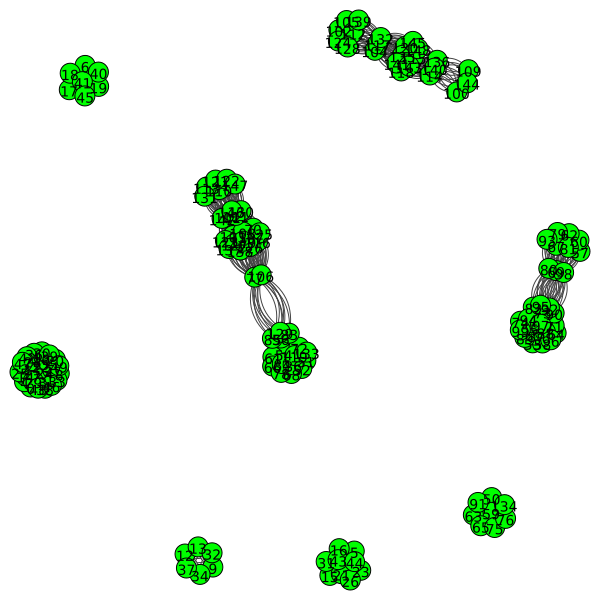

In [23]:
ig.plot(gy, vertex_color=['green'], vertex_label= list(range(150)))

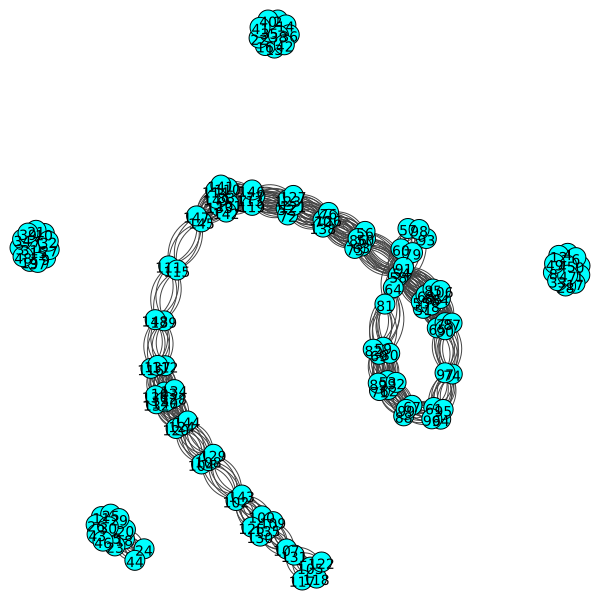

In [24]:
ig.plot(gx, vertex_color=['cyan'], vertex_label= list(range(150)))

### Prep S and curved roll dataset

In [19]:
SwissXY, Slabels = make_swiss_s(n_samples = 200, n_categories=3, random_state = 42) #1000 looks much better and we get a better visual on what the code does... however, it takes along time
SX, SY, labelX, labelY = SwissXY[0], SwissXY[1], Slabels[0], Slabels[1]

# Initializing the nearest-neigbor graphs
Sx = graphtools.Graph(SX, knn = 5, decay = 40) #Knn is the number of how many nearest neighbors it finds
Sy = graphtools.Graph(SY, knn = 5, decay = 40) #Decay is the rate of alpha decay (Which means the farther it gets the less similar they are)

# sending to igraph objects for more functionality
sx = Sx.to_igraph()
sy = Sy.to_igraph()

In [20]:
#n1 is the number of flowers (150). d1 is the number of measurements per flower (4)
n2, d2 = np.shape(SX)

# Creating random anchor points
s_rand_ints = random.sample(range(n2), 200) #The second number here determines how many Known anchors we want
s_known_anchors = np.vstack([s_rand_ints, s_rand_ints]).T

Slabels = np.concatenate([labelX, labelY])

ic| mali.py:174 in fit() at 12:39:20.924
/yunity/arusty/.local/lib/python3.10/site-packages/graphtools/base.py:165: RuntimeWarning: Cannot perform PCA to 100 dimensions on data with min(n_samples, n_features) = 3
  warnings.warn(


optimal t:  33
optimal t:  30


/yunity/arusty/.local/lib/python3.10/site-packages/graphtools/base.py:165: RuntimeWarning: Cannot perform PCA to 100 dimensions on data with min(n_samples, n_features) = 3
  warnings.warn(
/yunity/arusty/.local/lib/python3.10/site-packages/ot/bregman/_sinkhorn.py:531: UserWarning: Sinkhorn did not converge. You might want to increase the number of iterations `numItermax` or the regularization parameter `reg`.
  warnings.warn("Sinkhorn did not converge. You might want to "
/yunity/arusty/.local/lib/python3.10/site-packages/graphtools/graphs.py:290: RuntimeWarning: Detected zero distance between 200 pairs of samples. Consider removing duplicates to avoid errors in downstream processing.
  warnings.warn(
/yunity/arusty/.local/lib/python3.10/site-packages/graphtools/graphs.py:290: RuntimeWarning: Detected zero distance between 200 pairs of samples. Consider removing duplicates to avoid errors in downstream processing.
  warnings.warn(


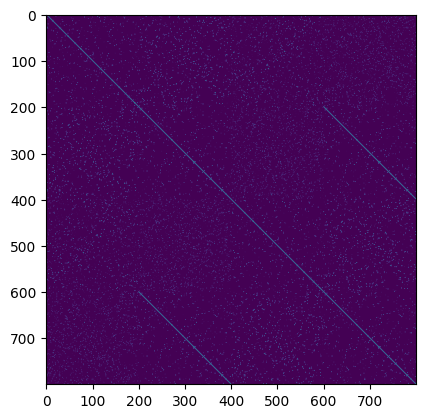

In [21]:
#Prepare NAMA and Mali and DTA
#For comparision, also fit the data to Nama and Mali
namaS = NAMA(ot_reg = 0.001)
namaS.fit(s_known_anchors, SX, SY)

maliS = MALI()
maliS.fit((SX, SY), (labelX, labelY))

#DTA-Andres Prep
d_Scurve = DTA(knn=5,
             decay=40,
             knn_dist="euclidean",
             knn_max=None, #Could matter with MNist data
             distances="DPT",
             distance = 'cosine')

#Shared D1 needs to be a subset of X.. and SharedD2 needs to be a subset of Y
s_sharedD1 = SX[s_rand_ints]
s_sharedD2 = SY[s_rand_ints]
s_labelsh1 = labelX[s_rand_ints]
s_labelsh2 = labelY[s_rand_ints]

#Fit the dta -> Note, I did edit the file a little bit
d_Scurve.fit(SX, SY, sharedD1 = s_sharedD1, sharedD2 = s_sharedD2, 
            labels1 = None, labels2 = None, labelsh1 = None, labelsh2 = None) #Using the labels seems to make the approach very akin to MALI

#Note that it is extra big? The random anchors are added to the matrix so it will be 300 + anchors by 300 by anchors
plt.imshow(d_Scurve.W)

<Axes: >

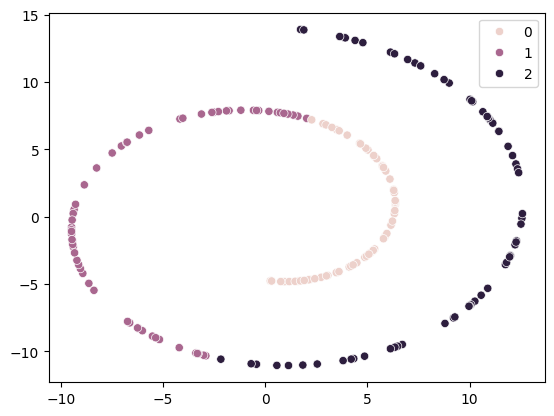

In [22]:
#This is made because the other labels become corrupted
sns.scatterplot(x=SX[:,0], y=SX[:,2], hue = labelX)

<Axes: >

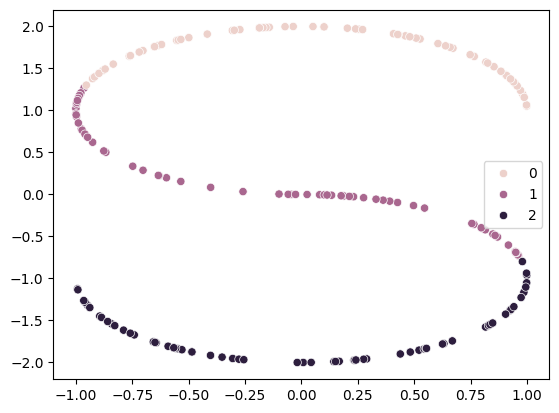

In [18]:
sns.scatterplot(x=SY[:,0], y=SY[:,2], hue = labelY)

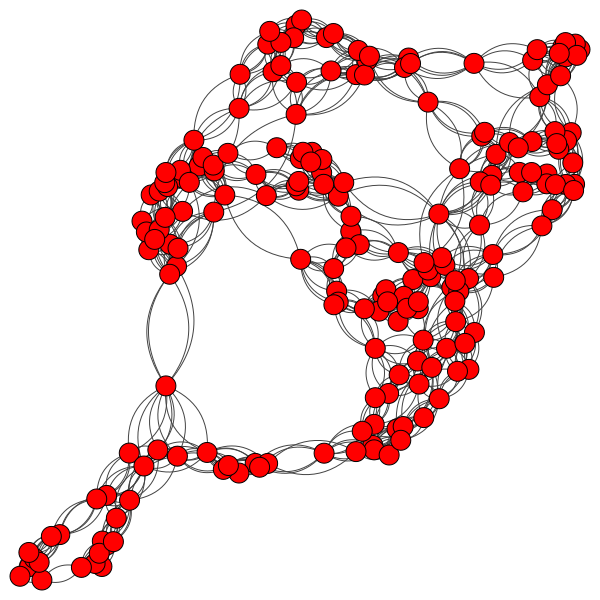

In [23]:
ig.plot(sx)

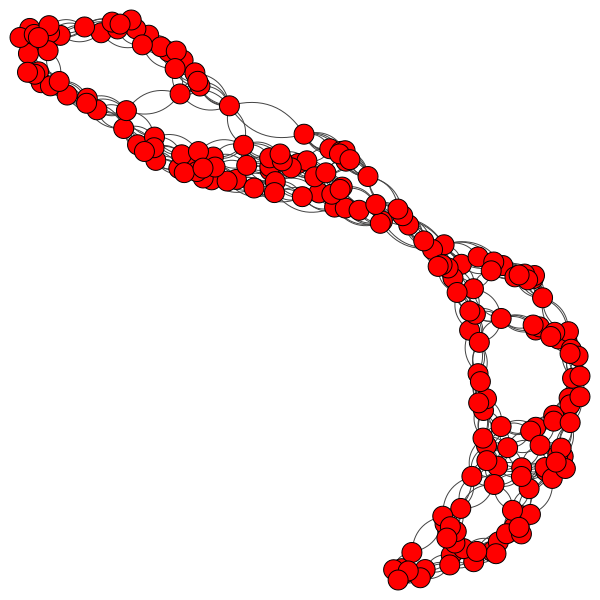

In [24]:
ig.plot(sy)

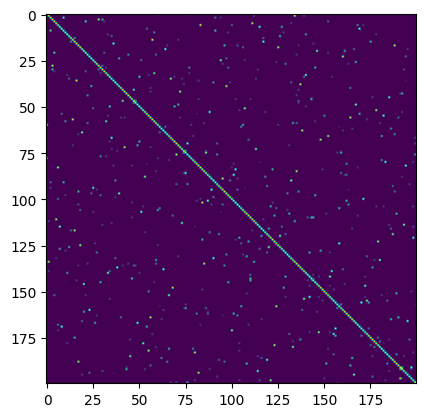

In [32]:
plt.imshow(Sx.K.toarray())

### Prep MNist Data

type(y):  <class 'numpy.ndarray'>


/tmp/ipykernel_2943586/1875510329.py:13: DeprecationWarning: NumPy will stop allowing conversion of out-of-bound Python integers to integer arrays.  The conversion of -1 to uint8 will fail in the future.
For the old behavior, usually:
    np.array(value).astype(dtype)
will give the desired result (the cast overflows).
  y[drop_bool] = drop_value


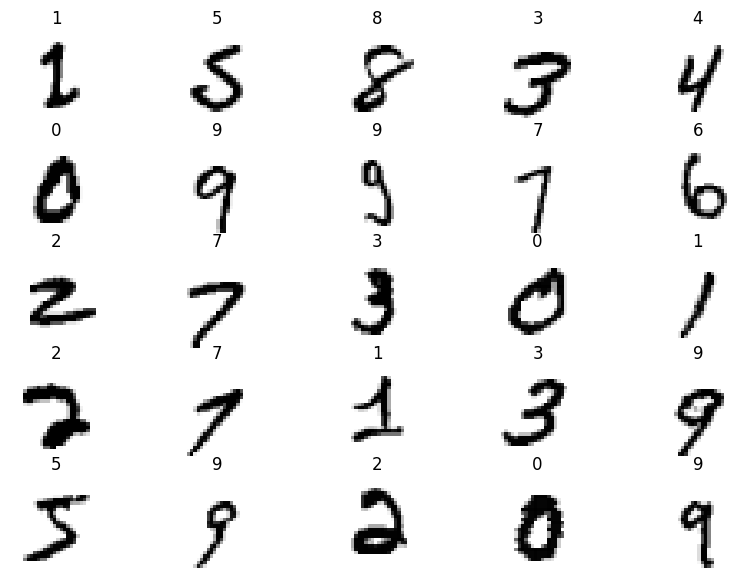

In [33]:
#Load in the data
import tensorflow as tf
mnist = tf.keras.datasets.mnist
(o1, p1), (o2, p2) = mnist.load_data() #NOTE, these are not the same size, as o1 is training data and o2 it test data

#Lets use a smaller sample
SIZE = 200
(o1, p1, o2, p2) = (o1[:SIZE], p1[:SIZE], o2[:SIZE], p2[:SIZE])

#This removes the labels
p2_miss = drop_labels(p2, pct_kept = .1, random_state = 0)

#Veiw Our data so we better understand what is going on :)
plt.figure(figsize = (10, 7))
for i in range(25):
  plt.subplot(5,5, i+1)
  rand_index = random.choice(range(len(o1)))
  plt.imshow(o1[rand_index], cmap=plt.cm.binary)
  plt.title(p1[rand_index])
  plt.axis(False)

#Reshape the graphs
o1 = o1.reshape(SIZE, -1)
o2 = o2.reshape(SIZE, -1)

#Distort graph two
###o2 = o2 + np.random.normal(scale = 0.05, size = np.shape(o2))

#For ease
labelsM = np.concatenate([p1, p2])

# Creating random anchor points

#Since the datasets share no values, we are instead calling anchor points if they have the same number
known_anchorsM = []
rand_index = random.sample(range(len(o1)), 200)#THIS DETERMINES HOW MANY ANCHOR POINTS WE WAnt

for i in rand_index: 
    value = i
    #Find a corresponding index in o2 that is the same label as the rand_index
    rand_index2 = i
    while p2[rand_index2] != p1[value]:
        if rand_index2 < len(p2)-1:
            rand_index2 += 1
        else:
            rand_index2 = 0
    #Add it to our list
    known_anchorsM.append([value, rand_index2])

known_anchorsM = np.array(known_anchorsM)
    


In [34]:
known_anchorsM

array([[130, 142],
       [ 30,  30],
       [ 28,  35],
       [197,  61],
       [191,   8],
       [186, 197],
       [ 40,  40],
       [ 87,  92],
       [136, 142],
       [ 43,  58],
       [ 57,  58],
       [ 21,  25],
       [ 35,  45],
       [ 44,  44],
       [ 90,  91],
       [158, 171],
       [116, 118],
       [149, 158],
       [ 98, 112],
       [165, 197],
       [ 96,  97],
       [167, 185],
       [ 17,  61],
       [100, 102],
       [ 45,  58],
       [190, 199],
       [161, 172],
       [ 62,  66],
       [140, 141],
       [176, 185],
       [108, 126],
       [  1,   3],
       [ 29,  34],
       [  5,  35],
       [ 27,  30],
       [ 46,  61],
       [ 72,  74],
       [148, 171],
       [124, 135],
       [101, 111],
       [ 55,  61],
       [ 18,  21],
       [ 76,  77],
       [104, 107],
       [133, 150],
       [ 74,  76],
       [111, 112],
       [160, 177],
       [139, 139],
       [105, 107],
       [144, 146],
       [ 16,  35],
       [ 36,

In [35]:
#Prep Phate
phate = PHATE(n_components = 9, random_state = 42, knn_dist = 'precomputed', verbose= False)

#Prep MDS
mdsM = MDS(metric=True, dissimilarity = 'precomputed', random_state = 42, n_components=9)

#Create Mali
maliM = MALI(ot = True, ot_reg = 0.001, transition_only = False, knn = 5, t = "DPT", graph_knn = 5,
             a = "uniform", b = "uniform", mu = .5, interclass_distance = 'cosine', normalize_M = True, graph_decay = 10, #Only 10?
            graph_distance = 'euclidean', n_pca = None)

#Fit the data, and transform it to a MDS
maliM.fit((o1, o1), (p1, p2_miss))

#Create Nama
namaM = NAMA(ot_reg = 0.001)
namaM.fit(known_anchorsM, o1, o2)



#DTA-Andres Prep
d_Mnist = DTA(knn=3,
             decay=40,
             knn_dist="euclidean",
             knn_max=3, #Could matter with MNist data
             distances="DPT",
             distance = 'cosine')

#Shared D1 needs to be a subset of X.. and SharedD2 needs to be a subset of Y
m_sharedD1 = o1[known_anchorsM.T[0]] #Note, these are different now
m_sharedD2 = o2[known_anchorsM.T[1]]
m_labelsh1 = p1[known_anchorsM.T[0]] 
m_labelsh2 = p2[known_anchorsM.T[1]]

#Fit the dta -> Note, I did edit the file a little bit
d_Mnist.fit(o1, o2, sharedD1 = m_sharedD1, sharedD2 = m_sharedD2, 
            labels1 = None, labels2 = None, labelsh1 = None, labelsh2 = None) #Using the labels seems to make the approach very akin to MALI

ic| mali.py:174 in fit() at 08:21:58.271
/yunity/arusty/.local/lib/python3.10/site-packages/graphtools/graphs.py:122: UserWarning: Building a kNNGraph on data of shape (200, 784) is expensive. Consider setting n_pca.
  warnings.warn(
/yunity/arusty/.local/lib/python3.10/site-packages/graphtools/graphs.py:122: UserWarning: Building a kNNGraph on data of shape (200, 784) is expensive. Consider setting n_pca.
  warnings.warn(
/yunity/arusty/.local/lib/python3.10/site-packages/ot/bregman/_sinkhorn.py:531: UserWarning: Sinkhorn did not converge. You might want to increase the number of iterations `numItermax` or the regularization parameter `reg`.
  warnings.warn("Sinkhorn did not converge. You might want to "


array([[2., 0., 0., ..., 0., 0., 0.],
       [0., 2., 0., ..., 0., 0., 0.],
       [0., 0., 2., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 2., 0., 0.],
       [0., 0., 0., ..., 0., 2., 0.],
       [0., 0., 0., ..., 0., 0., 2.]])

In [36]:
# Initializing the nearest-neigbor graphs
Mx = graphtools.Graph(o1, knn = 1, decay = 10, knn_max = 1) #Knn is the number of how many nearest neighbors it finds
My = graphtools.Graph(o2, knn = 1, decay = 10, knn_max = 1) #Decay is the rate of alpha decay (Which means the farther it gets the less similar they are)

# sending to igraph objects for more functionality
mx = Mx.to_igraph()
my = My.to_igraph()

/yunity/arusty/.local/lib/python3.10/site-packages/graphtools/graphs.py:122: UserWarning: Building a kNNGraph on data of shape (200, 784) is expensive. Consider setting n_pca.
  warnings.warn(
/yunity/arusty/.local/lib/python3.10/site-packages/graphtools/graphs.py:122: UserWarning: Building a kNNGraph on data of shape (200, 784) is expensive. Consider setting n_pca.
  warnings.warn(


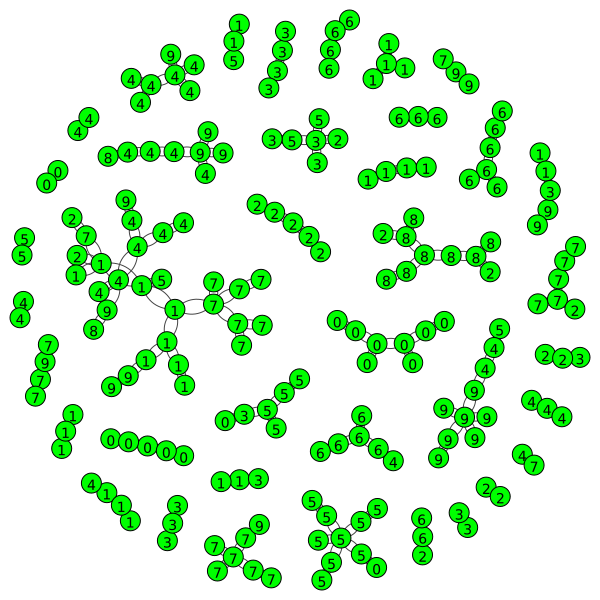

In [37]:
ig.plot(my, vertex_color=['green'], vertex_label= p2)

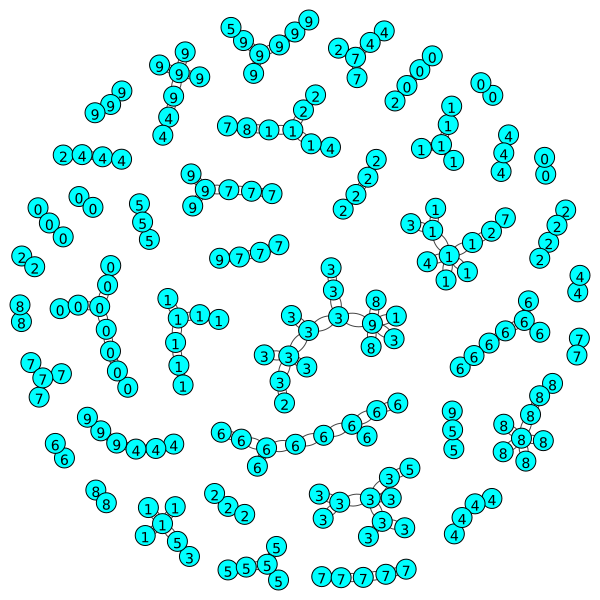

In [38]:
ig.plot(mx, vertex_color=['cyan'], vertex_label= p1)

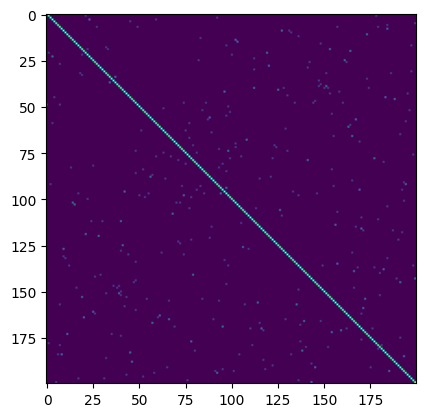

In [39]:
# pairwise similarities
plt.imshow(Mx.K.toarray())

### Prep Blobs Dataset

In [40]:
#Prep Phate
phateC = PHATE(n_components = 2, random_state = 42, knn_dist = 'precomputed', verbose= False)

def make_multivariate_data_set(Mean = [0,0], cov = [[0.5,0], [0,0.5]], amount = 500, adjust = 0):
    """Returns the a data set of three multivariate data blobs and the assiociated labels
    adjust is where we want to put the mover data set"""
    #Create the multivariate datasets function
    Mean = np.array(Mean) 

    # Draw 10 samples from the distribution
    dens_samples1 = np.random.multivariate_normal(Mean, cov, amount) #This is shaped (500, 2) where each point has X and Y
    dens_samples2 = np.random.multivariate_normal(Mean + 5, cov, amount) #Add five to the mean
    dens_samples3 = np.random.multivariate_normal(Mean + adjust, cov, amount) #Have this overlap with the first dataset

    #Now, we want to merge all of these dots into a single data set. Not too bad :)
    mv_data = np.array([dens_samples1, dens_samples2, dens_samples3])
    mv_data = mv_data.reshape(amount*3, 2)
    mv_labels = np.concatenate([np.repeat(0, amount), np.repeat(1, amount), np.repeat(2, amount)]) #We use numbers because thats what DTA needs

    return mv_data, mv_labels


#Create data
AMOUNT_C = 100
mv_data_A, mv_labels_A = make_multivariate_data_set(amount=AMOUNT_C)
mv_data_B, mv_labels_B = make_multivariate_data_set(amount=AMOUNT_C, adjust = 5)

#Establish anchors -> They can be any point here?
rand_intsC = random.sample(range(AMOUNT_C*3), 300) #The second number here determines how many Known anchors we want
known_anchorsC = np.vstack([rand_intsC, rand_intsC]).T

<Axes: >

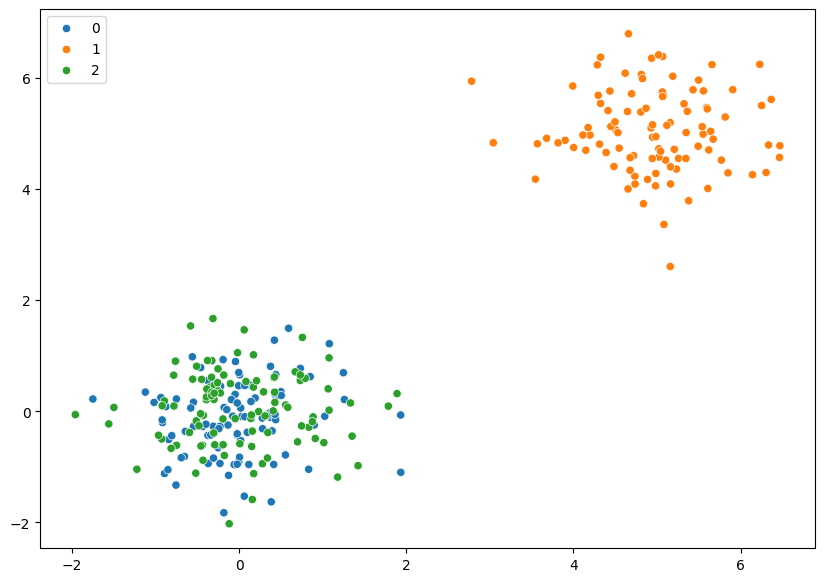

In [41]:
#View plots to see the data
plt.figure(figsize=(10, 7))
sns.scatterplot(x=mv_data_A[:,0], y = mv_data_A[:,1], hue = pd.Categorical(mv_labels_A))


<Axes: >

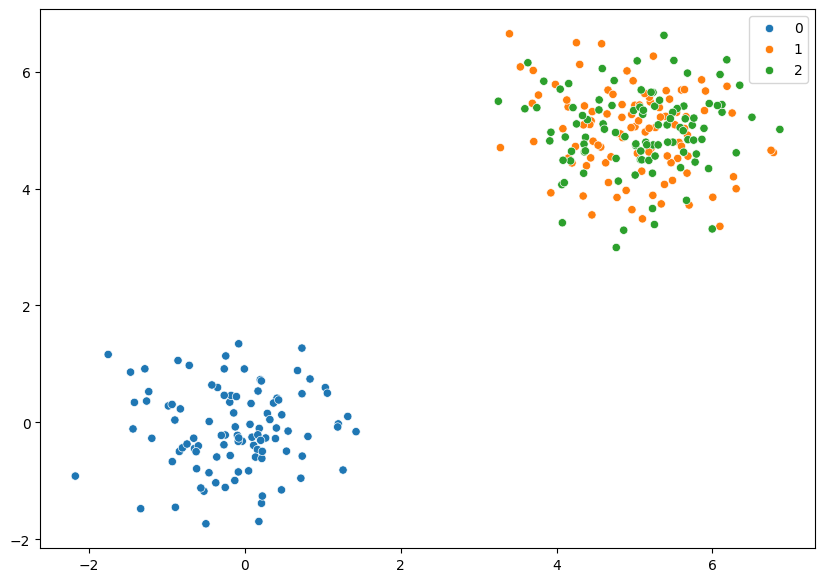

In [42]:
#View again just to see
plt.figure(figsize=(10, 7))
sns.scatterplot(x=mv_data_B[:,0], y = mv_data_B[:,1], hue = pd.Categorical(mv_labels_A))

### Prep wine data set
Note: Not for drinking

link to data: https://www.kaggle.com/datasets/uciml/red-wine-quality-cortez-et-al-2009?resource=download

We will use the qualities as the labels. They range from 3 to 8

In [43]:
#Read in data
wine_csv = pd.read_csv("/yunity/arusty/Graph-Manifold-Alignment/CSV Files/winequality-red.csv")
wine_csv.sample(frac=0.1).head(10)

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
45,4.6,0.520,0.15,2.1,0.054,8.0,65.0,0.99340,3.90,0.56,13.1,4
750,8.3,0.650,0.10,2.9,0.089,17.0,40.0,0.99803,3.29,0.55,9.5,5
1057,7.6,0.420,0.25,3.9,0.104,28.0,90.0,0.99784,3.15,0.57,9.1,5
536,9.9,0.630,0.24,2.4,0.077,6.0,33.0,0.99740,3.09,0.57,9.4,5
900,8.9,0.310,0.36,2.6,0.056,10.0,39.0,0.99562,3.40,0.69,11.8,5
240,8.9,0.635,0.37,1.7,0.263,5.0,62.0,0.99710,3.00,1.09,9.3,5
47,8.7,0.290,0.52,1.6,0.113,12.0,37.0,0.99690,3.25,0.58,9.5,5
483,10.6,0.360,0.60,2.2,0.152,7.0,18.0,0.99860,3.04,1.06,9.4,5
1282,7.9,0.765,0.00,2.0,0.084,9.0,22.0,0.99619,3.33,0.68,10.9,6
155,7.1,0.430,0.42,5.5,0.071,28.0,128.0,0.99730,3.42,0.71,10.5,5


In [44]:
wine_features, wine_labels = dataprep(wine_csv.sample(frac=0.15), label_col_idx=11) 
wine_features.shape, wine_labels.min(), wine_labels.max(), len(wine_features[1]), len(wine_labels)

((240, 11), 0, 4, 11, 240)

In [45]:
#Find out which features are most important
print_feature_importance(wine_features, wine_labels)

Feature 5, Importance: -0.0375
Feature 2, Importance: -0.0201
Feature 6, Importance: -0.0076
Feature 4, Importance: -0.0063
Feature 3, Importance: -0.0049
Feature 7, Importance: 0.0049
Feature 0, Importance: 0.0069
Feature 8, Importance: 0.0076
Feature 1, Importance: 0.0090
Feature 10, Importance: 0.0201
Feature 9, Importance: 0.0306


In [46]:
#Splitting the data sets so each have the same "importance" of data
wine_split_A = wine_features[:, [4,2,3,6,8,10]]
wine_split_B = wine_features[:, [1,5,0,7,9]]
wine_labels = np.concatenate([wine_labels, wine_labels])

#Generate anchors
rand_ints_wine = random.sample(range(240), 240) #The second number here determines how many Known anchors we want
wine_anchors = np.vstack([rand_ints_wine, rand_ints_wine]).T
wine_anchors[:10]

array([[ 77,  77],
       [205, 205],
       [130, 130],
       [112, 112],
       [ 66,  66],
       [ 83,  83],
       [ 81,  81],
       [181, 181],
       [225, 225],
       [ 95,  95]])

In [47]:
np.cov(wine_features[[0,1,2,3,4,5,6,7,8,9,10]])

array([[ 0.07494099,  0.02151667,  0.04928531,  0.00736011,  0.02025018,
         0.02995845,  0.03225811,  0.0205238 ,  0.0320512 ,  0.04185411,
         0.02699091],
       [ 0.02151667,  0.0431958 ,  0.00987077,  0.0164597 ,  0.04381345,
         0.01779631,  0.02691712,  0.02507995,  0.00150703,  0.02605834,
         0.03196373],
       [ 0.04928531,  0.00987077,  0.03859636,  0.01110747,  0.0145743 ,
         0.01693953,  0.0136368 ,  0.01112463,  0.02189004,  0.02238223,
         0.01659405],
       [ 0.00736011,  0.0164597 ,  0.01110747,  0.0421584 ,  0.03677455,
         0.02384355,  0.00783937,  0.01861094,  0.01211672,  0.01581787,
         0.02712971],
       [ 0.02025018,  0.04381345,  0.0145743 ,  0.03677455,  0.08345215,
         0.02971836,  0.03964726,  0.04038826, -0.01017617,  0.0369051 ,
         0.05859064],
       [ 0.02995845,  0.01779631,  0.01693953,  0.02384355,  0.02971836,
         0.04197801,  0.0282272 ,  0.02492523,  0.01445752,  0.0397313 ,
         0.030

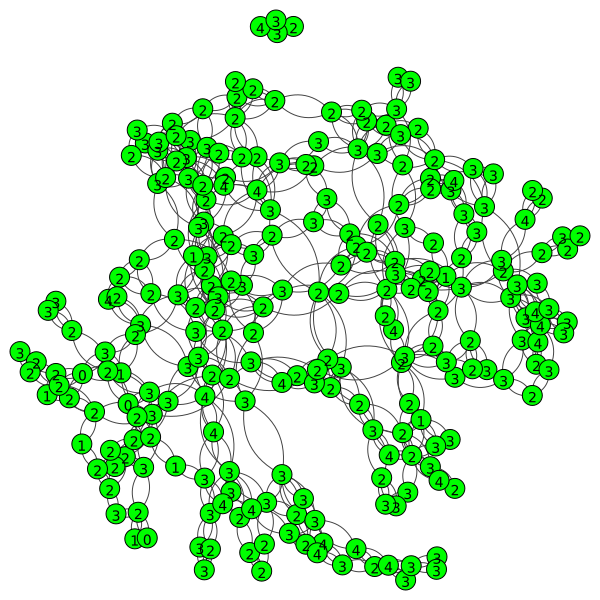

In [48]:
# Initializing the nearest-neigbor graphs
wine_graph_a = graphtools.Graph(wine_split_A, knn = 5, decay = 40, thresh=1e-4) #Knn is the number of how many nearest neighbors it finds
wine_graph_b = graphtools.Graph(wine_split_B, knn = 2, decay = 40, thresh=1e-4) #Decay is the rate of alpha decay (Which means the farther it gets the less similar they are)
wine_graph_ab = graphtools.Graph(wine_features, knn = 2, decay = 40, thresh=1e-4)

# sending to igraph objects for more functionality
wine_graph_a = wine_graph_a.to_igraph()
wine_graph_b = wine_graph_b.to_igraph()
wine_graph_ab = wine_graph_ab.to_igraph()

ig.plot(wine_graph_b, vertex_color=['green'], vertex_label= list(wine_labels))

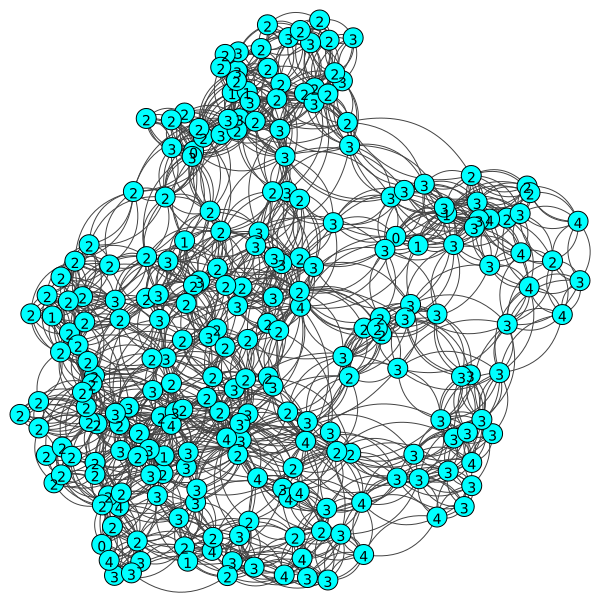

In [49]:
ig.plot(wine_graph_a, vertex_color=['cyan'], vertex_label= list(wine_labels))

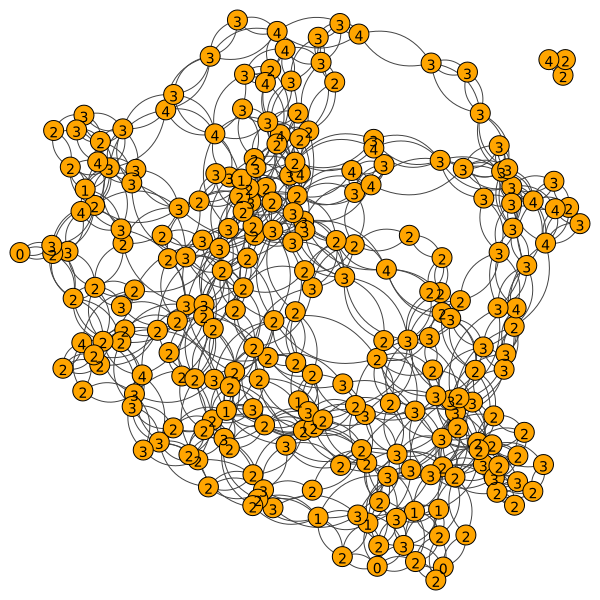

In [50]:
ig.plot(wine_graph_ab, vertex_color=['orange'], vertex_label= list(wine_labels))

### Prep Heart Data
Link to the data repository: https://www.kaggle.com/datasets/sukhmandeepsinghbrar/heart-attack-dataset?resource=download

In [51]:
#Read in the data
heart_csv = pd.read_csv("/yunity/arusty/Graph-Manifold-Alignment/CSV Files/Medicaldataset.csv")
heart_csv.sample(frac=0.1).head(10)

,Result,Age,Gender,Heart rate,Systolic blood pressure,Diastolic blood pressure,Blood sugar,CK-MB,Troponin
640,positive,58,1,69,148,72,169.0,3.210,1.290
994,positive,48,1,61,112,58,101.0,31.850,0.012
1028,positive,68,1,89,145,68,134.0,0.706,10.000
5,negative,52,0,61,112,58,87.0,1.830,0.004
258,negative,62,1,71,140,71,125.0,1.720,0.004
1116,positive,63,1,61,122,66,61.0,2.490,0.029
832,negative,83,1,61,117,78,122.0,1.620,0.010
475,positive,58,0,80,107,67,166.0,6.480,9.110
613,positive,69,1,89,160,67,96.0,33.870,0.021
807,positive,70,1,83,126,76,103.0,0.529,1.010


In [52]:
heart_features, heart_labels = dataprep(heart_csv.sample(frac=0.156), label_col_idx=8) 
heart_features.shape, heart_labels.min(), heart_labels.max() #O is negative I think

((206, 8), 0.001, 10.3)

In [53]:
np.cov(heart_features[[0,1,2,3,4,5,6,7]]).max()

0.15534967750629644

In [54]:
#Splitting the data sets so each have the same "importance" of data. We only use the ones that have significance
heart_split_A = heart_features[:, [7]]
heart_split_B = heart_features[:, [4,5,6]]
heart_labels = np.concatenate([heart_labels, heart_labels])

#Generate anchors
rand_ints_heart = random.sample(range(206), 206) #The second number here determines how many Known anchors we want
heart_anchors = np.vstack([rand_ints_heart, rand_ints_heart]).T
heart_anchors[:10]

array([[118, 118],
       [150, 150],
       [103, 103],
       [ 74,  74],
       [179, 179],
       [ 69,  69],
       [134, 134],
       [ 63,  63],
       [ 73,  73],
       [127, 127]])

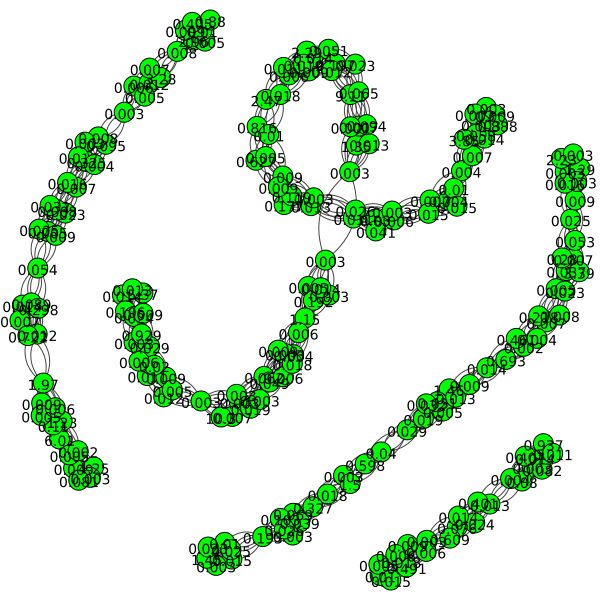

In [55]:
# Initializing the nearest-neigbor graphs
heart_graph_a = graphtools.Graph(heart_split_A, knn = 5, decay = 40, thresh=1e-4) #Knn is the number of how many nearest neighbors it finds

# sending to igraph objects for more functionality
heart_graph_a = heart_graph_a.to_igraph()

ig.plot(heart_graph_a, vertex_color=['green'], vertex_label= list(heart_labels))

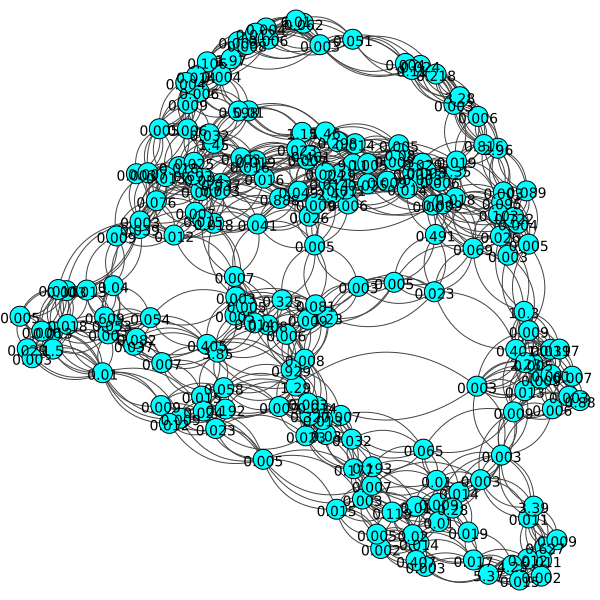

In [56]:
# Initializing the nearest-neigbor graphs
heart_graph_b = graphtools.Graph(heart_split_B, knn = 5, decay = 40, thresh=1e-4) #Knn is the number of how many nearest neighbors it finds

# sending to igraph objects for more functionality
heart_graph_b = heart_graph_b.to_igraph()

ig.plot(heart_graph_b, vertex_color=['cyan'], vertex_label= list(heart_labels))

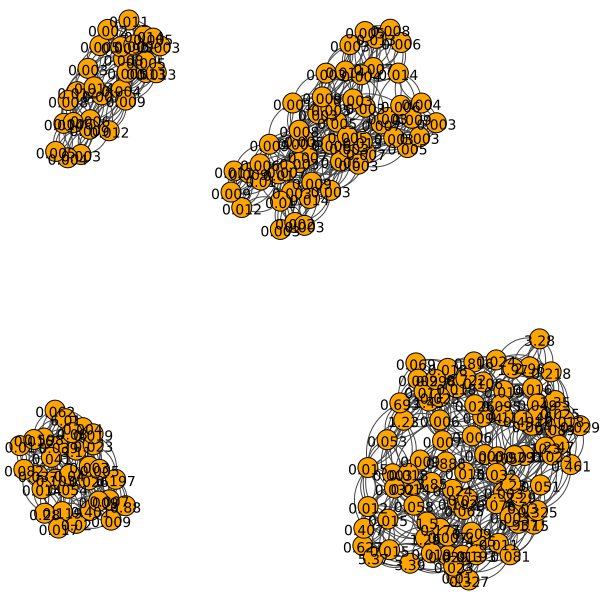

In [57]:
# Initializing the nearest-neigbor graphs
heart_graph_ab = graphtools.Graph(heart_features, knn = 5, decay = 40, thresh=1e-4) #Knn is the number of how many nearest neighbors it finds

# sending to igraph objects for more functionality
heart_graph_ab = heart_graph_ab.to_igraph()

ig.plot(heart_graph_ab, vertex_color=['orange'], vertex_label= list(heart_labels))

### Prep Abalone Dataset
Here is the link to the data: https://archive.ics.uci.edu/dataset/1/abalone


In [58]:
#pip install ucimlrepo

In [59]:
from ucimlrepo import fetch_ucirepo 
  
# fetch dataset 
abalone = fetch_ucirepo(id=1) 
  
# data (as pandas dataframes) 
abalone_data = abalone.data.features
abalone_data["Rings"] = abalone.data.targets
abalone_data = abalone_data[~abalone_data["Rings"].isin([0, 1, 2, 3, 4, 5, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30])]
abalone_data.sample(frac= 0.005)

,Sex,Length,Diameter,Height,Whole_weight,Shucked_weight,Viscera_weight,Shell_weight,Rings
444,F,0.410,0.325,0.105,0.3635,0.1590,0.0770,0.1200,10
959,M,0.500,0.385,0.135,0.6425,0.3195,0.1290,0.1535,7
519,F,0.345,0.250,0.090,0.2030,0.0780,0.0590,0.0550,6
3955,I,0.490,0.385,0.120,0.5910,0.2710,0.1125,0.1775,9
3620,F,0.640,0.500,0.170,1.2645,0.5650,0.3375,0.3150,9
1116,I,0.525,0.395,0.120,0.6080,0.2970,0.1395,0.1405,8
3948,F,0.530,0.400,0.165,0.7720,0.2855,0.1975,0.2300,12
3557,I,0.540,0.410,0.135,0.7025,0.3100,0.1770,0.2000,8
3209,I,0.430,0.340,0.125,0.3840,0.1375,0.0610,0.1460,14
2001,I,0.360,0.270,0.085,0.2185,0.1065,0.0380,0.0620,6


<Axes: ylabel='Count'>

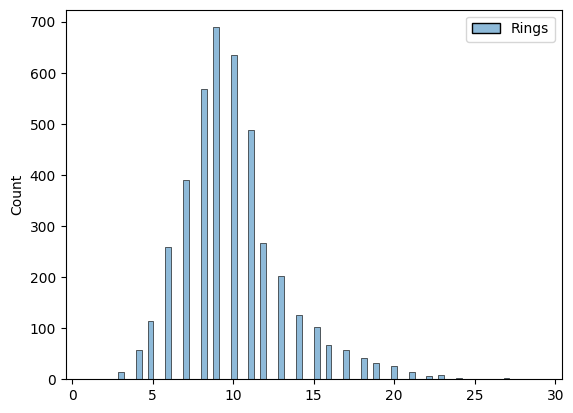

In [60]:
sns.histplot(abalone.data.targets)

In [61]:
abalone_features, abalone_labels = dataprep(abalone_data.sample(frac=0.136), label_col_idx=8) 
abalone_features.shape, abalone_labels.shape, abalone_labels.min(), abalone_labels.max() #O is negative I think

((507, 8), (507,), 0, 9)

In [62]:
pd.DataFrame(abalone_features).sample(frac= 0.04) #So is the male 1, female 0.5 and infant 0?

,0,1,2,3,4,5,6,7
379,1.0,0.417476,0.425287,0.675676,0.172400,0.129204,0.187005,0.222853
486,1.0,0.708738,0.689655,0.594595,0.424322,0.401559,0.380349,0.417342
386,0.5,0.271845,0.252874,0.216216,0.076285,0.066448,0.082409,0.097245
259,0.5,0.446602,0.528736,0.459459,0.196884,0.177194,0.195721,0.259319
185,1.0,0.728155,0.735632,0.540541,0.413193,0.375718,0.341521,0.486224
37,0.5,0.213592,0.195402,0.162162,0.045326,0.039787,0.042789,0.056726
72,0.0,0.815534,0.781609,0.540541,0.564346,0.487285,0.522979,0.640194
354,0.5,0.572816,0.563218,0.486486,0.285512,0.279327,0.254358,0.320908
102,0.5,0.611650,0.586207,0.513514,0.271550,0.253076,0.236926,0.322528
263,0.5,0.805825,0.689655,0.648649,0.474504,0.411403,0.493661,0.585089


In [63]:
#Find out which features are most important
print_feature_importance(abalone_features, abalone_labels)

Feature 6, Importance: 0.0065
Feature 4, Importance: 0.0199
Feature 2, Importance: 0.0245
Feature 1, Importance: 0.0301
Feature 0, Importance: 0.0330
Feature 3, Importance: 0.0379
Feature 7, Importance: 0.0497
Feature 5, Importance: 0.0938


In [64]:
#Splitting the data sets so each have the same "importance" of data. We only use the ones that have significance
abalone_split_B = abalone_features[:, [4, 7, 1, 5]]
abalone_split_A = abalone_features[:, [0, 2, 6, 3]]
abalone_labels = np.concatenate([abalone_labels, abalone_labels])

#Generate anchors
rand_ints_abalone = random.sample(range(abalone_features.shape[0]), abalone_features.shape[0]) #The second number here determines how many Known anchors we want
abalone_anchors = np.vstack([rand_ints_abalone, rand_ints_abalone]).T

abalone_split_A.shape, abalone_split_B.shape, abalone_labels.shape

((507, 4), (507, 4), (1014,))

In [65]:
np.unique(abalone_labels, return_counts = True) #Do we want to remove terms that have little representation?

(array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9], dtype=int8),
 array([ 70, 104, 152, 204, 148, 126,  62,  68,  40,  40]))

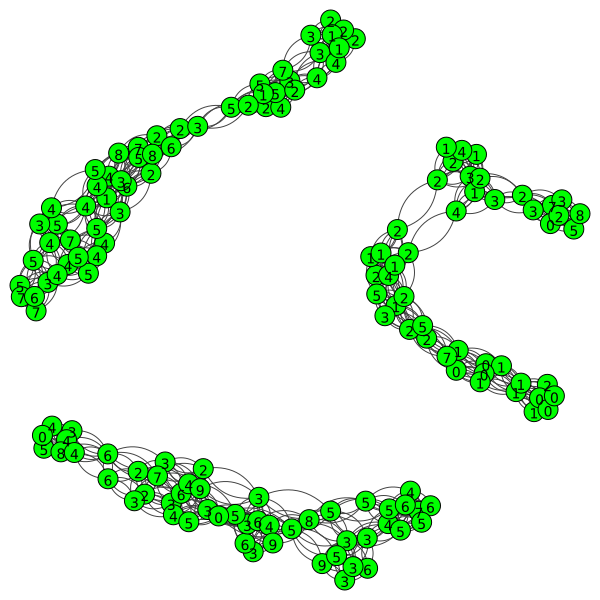

In [66]:
# Initializing the nearest-neigbor graphs
abalone_graph_a = graphtools.Graph(abalone_split_A[:150], knn = 5, decay = 40, thresh=1e-4) #Knn is the number of how many nearest neighbors it finds

# sending to igraph objects for more functionality
abalone_graph_a = abalone_graph_a.to_igraph()

ig.plot(abalone_graph_a, vertex_color=['green'], vertex_label= list(abalone_labels))

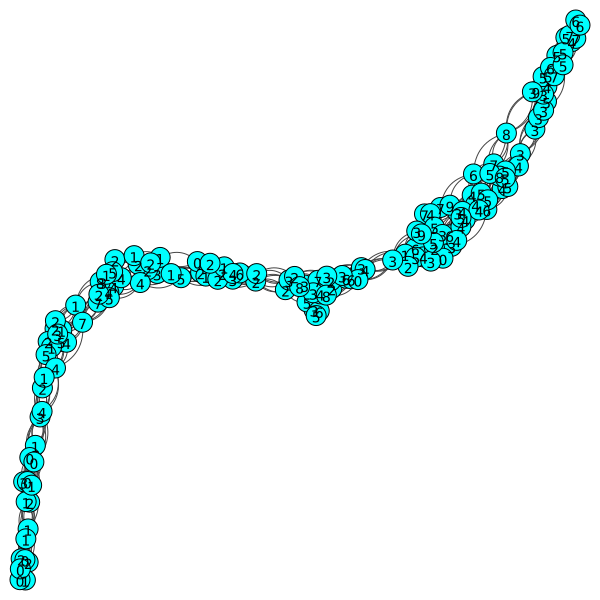

In [67]:
# Initializing the nearest-neigbor graphs
abalone_graph_b = graphtools.Graph(abalone_split_B[:150], knn = 5, decay = 40, thresh=1e-4) #Knn is the number of how many nearest neighbors it finds

# sending to igraph objects for more functionality
abalone_graph_b = abalone_graph_b.to_igraph()

ig.plot(abalone_graph_b, vertex_color=['cyan'], vertex_label= list(abalone_labels))

## Making it into a class!

In [68]:
class MP: #short for Manifold Prep
  def __init__(self, graphA, graphB, known_anchors, knn = 5, decay = 40, operation = "average", show = True, kind = "pure distance"):
        '''Known anchors should be a two dimension list. Shaped (n, 2) where n
        is the number of anchors. The corresponding anchors between data will be
        together"""

        Graph 1 and graph 2 should simply just be the data. We will convert it
        to Igraph. Same as nama or mali

        Knn states how many nearest neighbors we want to use in the graph. If
        Knn is set to "connect" then it will ensure connection in the graph.

        Operation is the way we want to calculate to the distances: can do
        average or abs (for the distance between the two nodes)

        Show is a boolean value. Set to True if you want to see the distance
        matrix.

        Kind is telling what kind of distance matrix you want.'''
        #Set the values
        self.decay = decay #We could maybe auto set decay to based off of the KNN
        self.operation = operation
        self.show = show
        self.kind = kind


        #Create Igraphs from the input.
        if knn == "connect": #TODO: implement the similarity function
          self.graphA = self.construct_connected_graph(graphA)
          self.graphB = self.construct_connected_graph(graphB)

        else:
          Gx = graphtools.Graph(graphA, knn = knn, decay = self.decay, knn_max= knn) #Knn is the number of how many nearest neighbors it finds
          Gy = graphtools.Graph(graphB, knn = knn, decay = self.decay, knn_max= knn) #Decay is the rate of alpha decay (Which means the farther it gets the less similar they are)

          #Create the igraph distances... Could this be the same as the above?
          self.graphA = Gx.to_igraph()
          self.graphB = Gy.to_igraph()


        #Create pure SGDM for graph 1 and graph 2
        self.pure_matrix_A, self.pure_matrix_B = self.get_pure_distance(graphA, graphB)
        self.pure_similar_A, self.pure_similar_B = self.get_pure_similarities(graphA, graphB)

        #Making our known Anchors
        known_anchors = np.array(known_anchors)
        self.known_anchors_A = known_anchors.T[0]
        self.known_anchors_B = known_anchors.T[1]

        #Create node paths and edge paths
        self.node_paths_A = self.make_node_paths(self.graphA, self.known_anchors_A)
        self.node_paths_B = self.make_node_paths(self.graphB, self.known_anchors_B)

        self.edge_paths_A = self.make_edge_paths(self.graphA, self.known_anchors_A)
        self.edge_paths_B = self.make_edge_paths(self.graphB, self.known_anchors_B)

        #All .matrix are distance matrix
        self.matrix_A, self.scales_A = self.get_SGDM_and_scale(self.graphA)
        self.matrix_B, self.scales_B = self.get_SGDM_and_scale(self.graphB)

        self.matrix_AB = self.get_DGDM()

        #Finally, get the block matrix
        self.block = self.get_block_matrix()

  def veiw_graphs(self):
    fig, axes = plt.subplots(1, 2, figsize = (13, 10))
    ig.plot(self.graphA, vertex_color=['green'], target=axes[0], vertex_label= list(range(self.graphA.vcount())))
    ig.plot(self.graphB, vertex_color=['cyan'], target=axes[1], vertex_label= list(range(self.graphB.vcount())))
    axes[0].set_title("Graph A")
    axes[1].set_title("Graph B")


  def construct_connected_graph(self, graphData, initial_knn=2):
    """This function is called forces the graph to be fully connected"""
    connected = False
    while not connected:
        # Construct a k-nearest neighbor graph
        G = graphtools.Graph(graphData, knn = initial_knn, decay = self.decay, knn_max = initial_knn)

        # Convert it to to an igraph graph
        g = G.to_igraph()

        # Check if the graph is connected
        connected = g.is_connected()

        if not connected:
            initial_knn += 1  # Increase knn for the next iteration
        else:
            print(f"Graph is connected with knn={initial_knn}.")

    return g



  def get_pure_distance(self, x, y):
    #Just using a normal distance matrix without Igraph
    x_dists = squareform(pdist(x))
    y_dists = squareform(pdist(y))

    #normalize it
    x_dists = x_dists / np.max(x_dists, axis = None)
    y_dists = y_dists / np.max(y_dists, axis = None)

    return x_dists, y_dists


  def get_pure_similarities(self, x, y):
    """This function creates graphs based on the similarity. These should be
    between all known points"""

    #Create graphs using the highest KNN possible
    similarity_graph_A = graphtools.Graph(x, knn = len(x)-2, decay = 1) #We do minus two because that is the max it allows
    similarity_graph_B = graphtools.Graph(y, knn = len(y)-2, decay = 1)

    #Return the similarity graph... note they aren't Igraphs... :)
    return (1- similarity_graph_A.K.toarray()), (1- similarity_graph_B.K.toarray())


  def make_node_paths(self, graph, anchors):
    """Will return all the node paths in a list"""

    #Create a blank list to append to the master one
    node_paths = []

    #For each node in graph get the shortest path
    for i in range(graph.vcount()):
      node_paths.append(graph.get_shortest_paths(i, to=anchors, algorithm = "dijkstra", weights=None, output="vpath"))

    return node_paths


  def make_edge_paths(self, graph, anchors):
    """Will return all the edge paths in a list"""

    #Create a blank list to append to the master one
    edge_paths = []

    #For each node in graph get the shortest path
    for i in range(graph.vcount()):
      edge_paths.append(graph.get_shortest_paths(i, to=anchors, weights=None, output="epath")) #It works without weights

    return edge_paths


  def get_SGDM_and_scale(self, graph):
    """Get Same Graph Distance Matrix. It will return a distance matrix for all
    nodes to each other node within the same graph.

    It also returns the scale (which is just the maximum value)."""

    #Get the entire distance matrix
    distance_matrix = np.array(graph.distances(weights = "weight")) #It seems when weights are set to none it made no difference.... :)
    inf_bool_matrix = np.isinf(distance_matrix)

    #Flatten both lists
    distance_matrix_flat = distance_matrix.flatten()
    inf_bool_matrix_flat = inf_bool_matrix.flatten()

    #Get the maximum
    scale = np.max(distance_matrix_flat[~inf_bool_matrix_flat])

    #Normalize it
    distance_matrix = (distance_matrix/scale) #- 0.5 #I read it that it could run best if the mean = 0.

    #Set inf values to 2... This will make it so when the DGDM runs it will use those two values -> this seems to help our models predictions
    distance_matrix[np.isinf(distance_matrix)] = 1 # Set to one because it 1 is the maximum distance... Maybe we should test 2 out

    return distance_matrix, scale


  def get_real_DM(self, nodePaths, pureDistanceMatrix): #NOTE: This is currently finding the path to its nearest anchor, and not necessarily the right anchor to connect with the other graph
    """Get Same Graph Distance Matrix by going through each node path and adding each distance.
    It returns all the anchor paths"""
    #Create an empty list to return
    node_distance_matrix = []

    #Loop through Node paths
    for node in nodePaths:
      node_distance_to_anchors = []
      #Loop through each path
      for path in node: #We could just select the one that has the least connections to save time and computing power -- it will be close to the actuall but not the same
        #Check to make sure the path isn't empty
        if len(path) > 0:
          distance_to_anchor = 0

          #Now loop through the connections
          for index in range(len(path)-1):
            distance_to_anchor += pureDistanceMatrix[path[index]][path[index+1]]

          #We want to use the shortest one
          node_distance_to_anchors.append(distance_to_anchor)
        else: #Path size is infintie
          node_distance_to_anchors.append(np.inf)

      node_distance_matrix.append(node_distance_to_anchors)

    #Convert to an array
    node_distance_matrix = np.array(node_distance_matrix) #Question: code might run faster if we start it as an array

    #Scale it
    node_distance_matrix = node_distance_matrix / np.max(node_distance_matrix[~np.isinf(node_distance_matrix)])

    #Reset inf values
    node_distance_matrix[np.isinf(node_distance_matrix)] = 1

    return node_distance_matrix


  def AvgTwoNodes(self, k, l):
    '''K should be the node we want in graphA, and L should be the node in
    graphB. It will find the shortest distance between the two.

    This will use already scaled values.
    '''

    #Get the distance from K to all anchors
    k_to_all_anchor_dist = self.matrix_A[k][self.known_anchors_A] #Note, this is already scaled

    #Get the distance from L to all anchors
    l_to_all_anchor_dist = self.matrix_B[l][self.known_anchors_B] #Note, this is already scaled


    #Average metric. Seems to do well, but points similar to each other end up far away but on similar places
    if self.operation == "average":
      average_array = (k_to_all_anchor_dist + l_to_all_anchor_dist) / 2

      #else we want the shortest distance
      return np.min(average_array)

    #Abs value metric -- I think this is the best
    elif self.operation == "abs":

      """This approach always uses which ever anchor point is closest to both nodes
      #Use the anchor point that is the closest to both anchors:
      combined_to_anchor_dist = k_to_all_anchor_dist + l_to_all_anchor_dist

      #Find which value it is
      min_index = np.argmin(combined_to_anchor_dist)

      #Return the absolute value
      return np.abs(k_to_all_anchor_dist[min_index] - l_to_all_anchor_dist[min_index])
      """

      #THIS WAY CHOOSES THE CLOSEST ANCHOR TO ONE POINT, AND THEN USES THAT ANCHOR (It compares both of them)
      #Beause we don't want both nodes to go to a far away anchor which might be a similar distance, we force it to closest ancor
      k_smallest_index = np.argmin(k_to_all_anchor_dist)

      #Get how different each of the values.
      """ USE THIS IF WE WANT TO TRY TO GET THE ANCHOR'S CLOSER. NOTE: Indent the following line to be part of the else statement
      if k_to_all_anchor_dist[k_smallest_index] == 0 or l_to_all_anchor_dist[k_smallest_index] == 0: #The purpose of this statement is to help place the anchors closer to each other
        abs_array = np.abs(k_to_all_anchor_dist[k_smallest_index] - l_to_all_anchor_dist[k_smallest_index])/2
      else:
      """

      abs_array = np.abs(k_to_all_anchor_dist[k_smallest_index] - l_to_all_anchor_dist[k_smallest_index])

      #This includes going the other direction too
      l_smallest_index = np.argmin(l_to_all_anchor_dist)


      """USE THIS IF WE WANT TO TRY TO GET THE ANCHOR'S CLOSER. THIS APPROACH IS A LITTLE BETTER BUT DOUBLES THE RUN TIME
      if k_to_all_anchor_dist[l_smallest_index] == 0 or l_to_all_anchor_dist[l_smallest_index] == 0:
        abs_array = np.append(abs_array, np.abs(k_to_all_anchor_dist[l_smallest_index] - l_to_all_anchor_dist[l_smallest_index])/2)
      else:"""

      abs_array = np.append(abs_array, np.abs(k_to_all_anchor_dist[l_smallest_index] - l_to_all_anchor_dist[l_smallest_index])) #Note: probably a faster appraoch than this



      return np.min(abs_array)


  def get_DGDM(self):
    """DGDM stands for Different graphs distance Matrix
    This gets the distance matrix between two graphs (or the same graph). Graph 1 should be the first
    graph and graph 2 should be the second that we want to compare distances too

    For each node in graph 1, it will find the distance to each node in graph 2"""

    """For each point, find the average distance from node x to node y"""
    #Create an array of 0s we can fill
    XY = np.zeros(shape=(self.graphA.vcount(), self.graphB.vcount()))

    #Depending on how we want to calculate
    if self.kind == "distance":
      #Create the nodes to anchor distances for each graph
      self.all_dist_to_anchors_A = self.get_real_DM(self.node_paths_A, self.pure_matrix_A)
      self.all_dist_to_anchors_B = self.get_real_DM(self.node_paths_B, self.pure_matrix_B)

      print(f"All distance to anchors: {np.min(self.all_dist_to_anchors_A, axis = 1)}")


      #Add each value together. A[:, np.newaxis, :] + B[np.newaxis, :, :]
      if self.operation == "average":
        all_anchors = (self.all_dist_to_anchors_A[:, np.newaxis, :] + self.all_dist_to_anchors_B[np.newaxis, :, :]) /2 #NOTE: I removed the /2 and it looks better -- Not too tested though
        return np.min(all_anchors, axis=2) #use the smallest distance

      elif self.operation == "abs": #The all method works... but the new approach here isn't as good
        #return (np.abs(self.all_dist_to_anchors_A[:, np.newaxis, :] - self.all_dist_to_anchors_B[np.newaxis, :, :])).min(axis=2)

        #Because we don't want to go through two far away nodes... so just do the closest one... if not we can just do this line: return np.abs(self.all_dist_to_anchors_A[:, np.newaxis, :] - self.all_dist_to_anchors_B[np.newaxis, :, :])
        A_smallest_index = self.all_dist_to_anchors_A.argmin(axis=1)
        B_smallest_index = self.all_dist_to_anchors_B.argmin(axis=1)

        #We want it to be in shape 150 by 150
        A_smallest_index = np.tile(A_smallest_index, (self.graphA.vcount(), 1))
        B_smallest_index = np.tile(B_smallest_index, (self.graphB.vcount(), 1)).T

        #Now do the actuall math and absolute value part. If we want to use all anchors, we can simply return this line.
        all_anchors = np.abs(self.all_dist_to_anchors_A[:, np.newaxis, :] - self.all_dist_to_anchors_B[np.newaxis, :, :])

        # Generate row and column index grids
        row_indices, col_indices = np.meshgrid(np.arange(self.graphA.vcount()), np.arange(self.graphB.vcount()), indexing='ij') #This might error if b != a

        #This line creates a third matrix with shape (150, 150) with the smallest of the two arrays
        return np.minimum(all_anchors[row_indices, col_indices, A_smallest_index], all_anchors[row_indices, col_indices, B_smallest_index])


    else: #This runs for both pure distance and similarity
      #Loop over each x
      for x_index in range(self.graphA.vcount()):
        #loop over each y
        for y_index in range(self.graphB.vcount()):
          #Do the math
          XY[x_index][y_index] = self.AvgTwoNodes(x_index, y_index)

      #Set inf values to 2... We are removing this for consistency, since the other graphs don't have it
      #####XY[np.isinf(XY)] = 2

      #Returns the matrix
      return XY


  #Note: We could add logic to block_matrix to choose between pure_matrix_A and matrix_A when the graph is best. Unsure how this would translate to other datasets
  def get_block_matrix(self):
    """Returns the block matrix."""

    if self.kind == "pure distance": #Great when KNN is low or around 5
      block_matrix = np.block([[self.pure_matrix_A, self.matrix_AB],
                               [self.matrix_AB.T, self.pure_matrix_B]]) #Note: if we just use matrix_A instead of pure, the results can vary for better or worse. This seems to be better most of the time

    elif self.kind == "similarity": #Litterally amazing :)
      block_matrix = np.block([[self.pure_similar_A, self.matrix_AB],
                               [self.matrix_AB.T, self.pure_similar_B]])

    elif self.kind == "distance":
      block_matrix = np.block([[self.pure_matrix_A, self.matrix_AB],
                               [self.matrix_AB.T, self.pure_matrix_B]])

    else:
      print(f"Did not understand your input for kind = {self.kind}. /n Please use 'pure distance', 'distance' or 'similarity'")
      return None

    #We will set the inf values to five... currently unneeded because we set the inf values for the SGDM. It seems to help
    #block_matrix[np.isinf(block_matrix)] = 5

    #Plot the block matrix
    if self.show:
      plt.figure(figsize=(10, 8))
      sns.heatmap(block_matrix, cmap='viridis', mask = (block_matrix > 4))
      plt.title('Block Matrix')
      plt.xlabel('Graph A Vertex')
      plt.ylabel('Graph B Vertex')
      plt.show()

    return block_matrix

  def graph_node_path(self, nodeP):
    '''NodeP should be a list equal to size of graphs. Each value represents
    which node you want to visualize.

    For example. If we want to graph both graphA and graphB, then
    NodeP = [[2,4], 3], it would plot the paths from node 2 to anchor value 4
    in gx, and node 3 to all anchor points in gy.
    '''


    #Loop over each graph
    for graph in [self.graphA, self.graphB]:
      #Create Flat node paths
      if graph == self.graphA:
        try:
          #This code will work if we are given a nested list. Else it will error
          flat_node_path = [item for sublist in self.node_paths_A[nodeP[0]] for item in sublist]
          flat_edge_path = [item for sublist in self.edge_paths_A[nodeP[0]] for item in sublist]

        except:
          #This code will run if we are given a single list
          flat_node_path = self.node_paths_A[nodeP[0][0]][nodeP[0][1]]
          flat_edge_path = self.edge_paths_A[nodeP[0][0]][nodeP[0][1]]

      else:
        try:
          flat_node_path = [item for sublist in self.node_paths_B[nodeP[1]] for item in sublist]
          flat_edge_path = [item for sublist in self.edge_paths_B[nodeP[1]] for item in sublist]

        except:
          flat_node_path = self.node_paths_B[nodeP[1][0]][nodeP[1][1]]
          flat_edge_path = self.edge_paths_B[nodeP[1][0]][nodeP[1][1]]

      #This hides what we dont want to see
      graph.vs["size"] = 0
      graph.vs["color"] = "white"
      graph.vs["label"] = None
      graph.es["color"] = "white"
      graph.es["width"] = 0

      #Change the label size
      graph.vs["label_size"] = 10

      #Chaning the values of nodes we do want to see
      colorChange = 0

      #Loops through each vertex to change it
      for v in flat_node_path:
          if v == flat_node_path[0]:
            colorChange = 0

          graph.vs[v]["size"] = 38

          if graph == self.graphA:
            graph.vs[v]["color"] = "rgb(0, " + str(colorChange) + ", 155)" #This has the original as pink, and the farther away the more green it gets
            graph.vs[v]["label"] = "A:" +str(v)
          else:
            graph.vs[v]["color"] = "rgb(200, " + str(colorChange) + ", 155)"
            graph.vs[v]["label"] = "B:" +str(v)


          if colorChange > 160:
            graph.vs[v]["label_color"] = "black"
          else:
            graph.vs[v]["label_color"] = "white"

          colorChange += 25

      #Now loops through each edge to change it's visual effect
      for e in flat_edge_path:
          graph.es[e]["color"] = "red"
          graph.es[e]["width"] = 2

    ###Now show the graphs###

    #Make it pretty
    plt.figure(figsize=(12, 12))
    plt.title('Connecting two Node paths together')

    #Putting them on the same graph
    layout = self.graphA.layout("kamada_kawai")

    ig.plot(self.graphA, autocurve=True, layout=layout, target=plt.gca())
    ig.plot(self.graphB, autocurve=True, layout=layout, target=plt.gca())

    #Finally veiw the graph
    plt.show()
    #plt.close()



# 1st Model. Nearest Neighbor Approach

### Trial Code -> Using the Iris Dataset

All distance to anchors: [0.03165944 0.10631437 0.08954642 0.05871659 0.04949865 0.09584746
 0.11017809 0.05114655 0.03417856 0.11749445 0.07195453 0.08171497
 0.0910812  0.04594791 0.         0.         0.10253568 0.
 0.09799703 0.03417856 0.08664066 0.07195453 0.12567892 0.09752561
 0.10079813 0.13240018 0.05579902 0.04017026 0.04949865 0.09752561
 0.09809492 0.07861155 0.10312387 0.09317713 0.11749445 0.12532178
 0.0910812  0.11749445 0.         0.04658856 0.02472507 0.22485882
 0.06331888 0.10064677 0.07417522 0.0910812  0.         0.07718185
 0.05431461 0.07387203 0.16945201 0.11701956 0.15851241 0.11259157
 0.08336522 0.08342276 0.1109282  0.21005708 0.05722399 0.11474852
 0.25429087 0.08906674 0.18394824 0.         0.20541432 0.09584746
 0.11749445 0.10253568 0.07699509 0.08121857 0.         0.08064914
 0.         0.07079266 0.         0.06286809 0.11523277 0.10079813
 0.04594791 0.13865543 0.10479662 0.12706451 0.09569714 0.
 0.15651314 0.09978337 0.12116725 0.11029462 0.137759

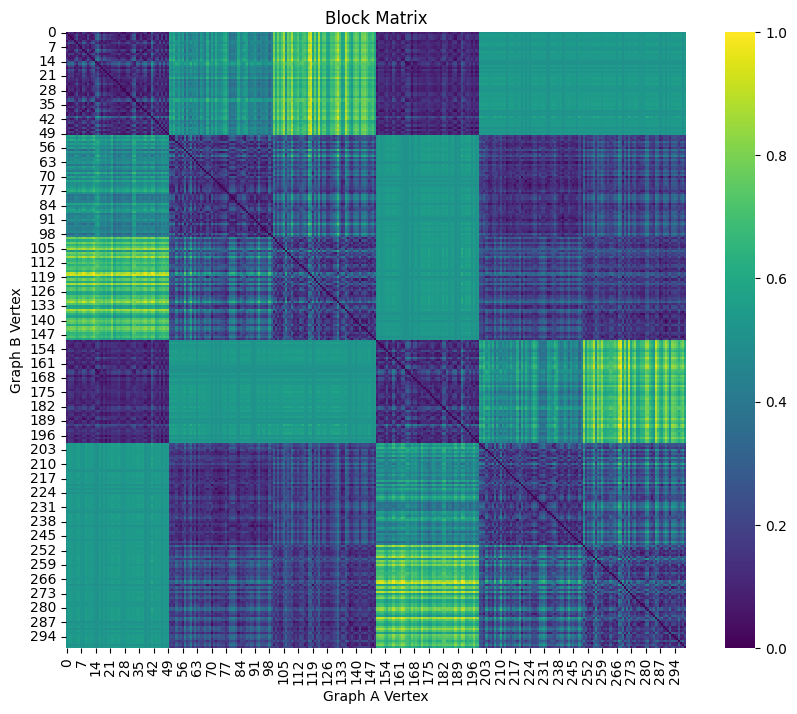

In [69]:
toy_class = MP(X, Y, known_anchors= known_anchors, knn=15, decay = 1, operation = "average", kind="distance")

In [70]:
#toy_class.veiw_graphs() #Note, this takes a second to run

In [71]:
toy_class.pure_matrix_A[0, 118], toy_class.pure_matrix_A[118, 1]

(0.9178478951981538, 0.9119318034454282)

In [72]:
#We see here that both parts of the node path are actually longer than just going straight to the anchor point 21... strange ... THIS PROBLEM IS CAUSED CAUSE WE USE WIEGHTS
toy_class.pure_matrix_A[0, 118] + toy_class.pure_matrix_A[118, 1], toy_class.pure_matrix_A[0, 1]

(1.829779698643582, 0.13058090034527783)

In [73]:
toy_class.node_paths_A[0][:15]

[[],
 [0, 46],
 [],
 [0, 4, 15],
 [0, 17],
 [],
 [],
 [],
 [0, 4, 14],
 [0, 7, 9, 38],
 [],
 [],
 [],
 [],
 []]

Text(0.5, 1.0, 'Matrix A')

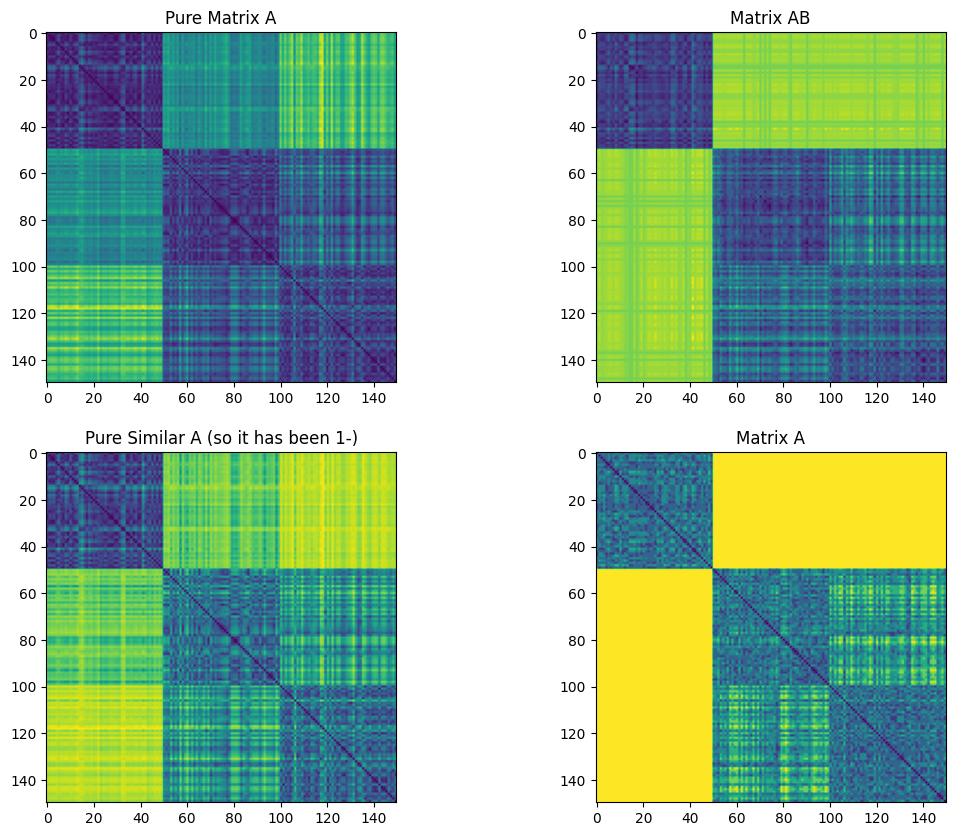

In [74]:
fig, axes = plt.subplots(2, 2, figsize = (13, 10))
axes[0, 0].imshow(toy_class.pure_matrix_A)
axes[0,0].set_title("Pure Matrix A")

#PUre similar A
axes[1, 0].imshow(toy_class.pure_similar_A)
axes[1,0].set_title("Pure Similar A (so it has been 1-)")

#1 - Matrix A
axes[0,1].imshow(toy_class.matrix_AB)
axes[0,1].set_title("Matrix AB")

#Matrix A
axes[1,1].imshow(toy_class.matrix_A)
axes[1,1].set_title("Matrix A")

Notes, about Similarity matrix
From above, we see that we want to use the matrix A

Observation. When the Knn is high (and the decay is reasonably low), Matrix A and Pure Similar A seem to be similar, but look almost inverse to each other (except both have the line of 0 through the middle) and hence the not-so-awesome results.

However, when Knn is low Matrix A and Pure Similar A seem to be exactly the same, and hence the awesome results. (Decay doesn't seem to matter here)

This begs the question... why ever set the Knn high? We want it low anyways!

P.S The Abs value function does a great job at reducing the negative effects of high Knn, where the average method seems to be a little better when the knn is lower (because of the kink where the anchors are outliers)


Continuing... We wouldn't ever want to set the KNN to be greater than what the "Connect" method does (usually about 17). But then again, don't we want class seperation, and therefore want to ensure unconnect graphs? So then, the highest we would want is "connect" -1, but the optimum is likely much lower.

The Pure Distance seems to be have higher extreme values (Going to one) than when we use similarity graph (going to 0.7).

There unfornately seems to be some variation based on the random factors.

---
DISTANCE GRAPH (I need a better name)
The problem before was that when node paths calculated the path somehow having weights on that causes issues. However, when its not there, then it's awesome. Decay now seems to have no effect.


All distance to anchors: [0.02617198 0.08788712 0.07402553 0.04853936 0.04091915 0.07923442
 0.09108115 0.04228143 0.02825446 0.09712938 0.0594828  0.06755148
 0.07529428 0.03798385 0.         0.         0.08476338 0.
 0.08101141 0.02825446 0.07162341 0.0594828  0.10389525 0.0806217
 0.083327   0.10945153 0.04612749 0.03320763 0.04091915 0.0806217
 0.08109233 0.06498597 0.08524962 0.07702693 0.09712938 0.08722112
 0.07529428 0.09712938 0.         0.03851346 0.02043953 0.18588451
 0.05234395 0.08320187 0.06131858 0.07529428 0.         0.06380408
 0.04490037 0.06106794 0.14008125 0.0967368  0.13103778 0.0930763
 0.0689157  0.06896327 0.09170124 0.17364832 0.04730548 0.0948594
 0.21021516 0.07362898 0.15206487 0.         0.12003355 0.07923442
 0.09712938 0.08476338 0.06364969 0.06714113 0.         0.06667039
 0.         0.05852232 0.         0.05197129 0.09525971 0.083327
 0.03798385 0.11462257 0.08663244 0.10504068 0.07911015 0.
 0.12938504 0.08248812 0.10016558 0.09117748 0.1138817  0.0

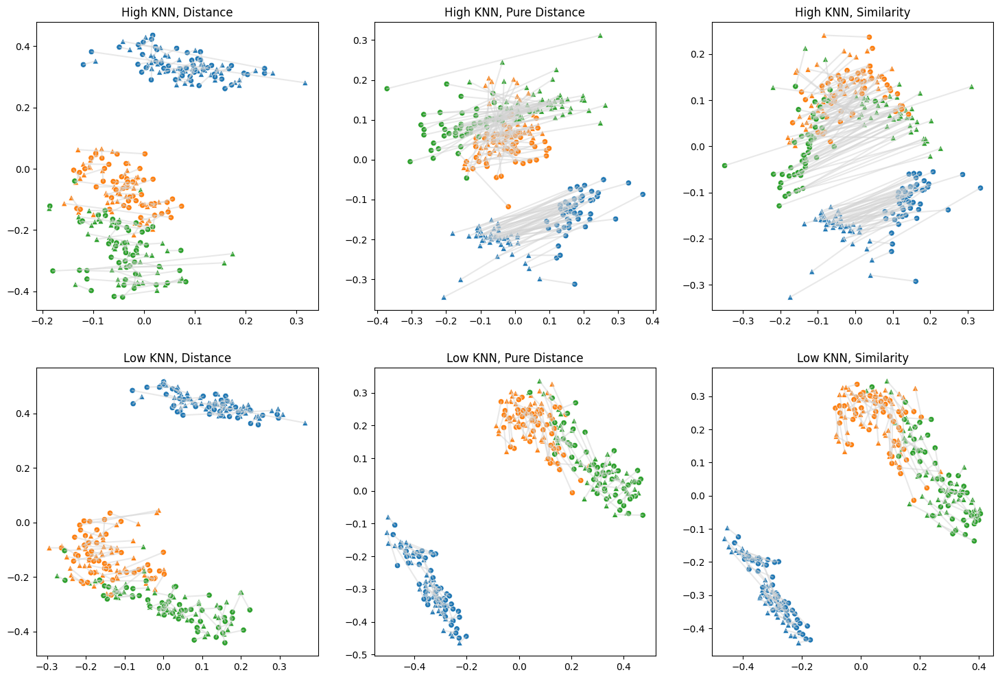

In [75]:
OPER = "abs"
#High KNN
toy_class1 = MP(X, Y, known_anchors, knn=148, decay = 1, operation = OPER, kind="distance", show = False)
toy_class2 = MP(X, Y, known_anchors, knn=148, decay = 1, operation = OPER, kind="pure distance", show = False)
toy_class3 = MP(X, Y, known_anchors, knn=148, decay = 1, operation = OPER, kind="similarity", show = False)

#Low KNN
toy_class4 = MP(X, Y, known_anchors, knn=5, decay = 40, operation = OPER, kind="distance", show = False)
toy_class5 = MP(X, Y, known_anchors, knn=5, decay = 40, operation = OPER, kind="pure distance", show = False)
toy_class6 = MP(X, Y, known_anchors, knn=5, decay = 40, operation = OPER, kind="similarity", show = False)

#Embed the data
emb1 = mds.fit_transform(toy_class1.block)
emb2 = mds.fit_transform(toy_class2.block)
emb3 = mds.fit_transform(toy_class3.block)
emb4 = mds.fit_transform(toy_class4.block)
emb5 = mds.fit_transform(toy_class5.block)
emb6 = mds.fit_transform(toy_class6.block)

#plot the data
styles = ['triangle' if i < len(emb1[:]) / 2 else 'circle' for i in range(len(emb1[:]))]
fig, axes = plt.subplots(2, 3, figsize = (18, 12))

#SNS plotting
sns.scatterplot(legend = False, x = emb1[:, 0], y = emb1[:, 1], hue = pd.Categorical(labels), ax = axes[0,0], style = styles, markers= {"triangle": "^", "circle" : "o"})
sns.scatterplot(legend = False, x = emb2[:, 0], y = emb2[:, 1], hue = pd.Categorical(labels), ax = axes[0,1], style = styles, markers= {"triangle": "^", "circle" : "o"})
sns.scatterplot(legend = False, x = emb3[:, 0], y = emb3[:, 1], hue = pd.Categorical(labels), ax = axes[0,2], style = styles, markers= {"triangle": "^", "circle" : "o"})
sns.scatterplot(legend = False, x = emb4[:, 0], y = emb4[:, 1], hue = pd.Categorical(labels), ax = axes[1,0], style = styles, markers= {"triangle": "^", "circle" : "o"})
sns.scatterplot(legend = False, x = emb5[:, 0], y = emb5[:, 1], hue = pd.Categorical(labels), ax = axes[1,1], style = styles, markers= {"triangle": "^", "circle" : "o"})
sns.scatterplot(legend = False, x = emb6[:, 0], y = emb6[:, 1], hue = pd.Categorical(labels), ax = axes[1,2], style = styles, markers= {"triangle": "^", "circle" : "o"})

#Set titles
axes[0,0].set_title("High KNN, Distance")
axes[0,1].set_title("High KNN, Pure Distance")
axes[0,2].set_title("High KNN, Similarity")
axes[1,0].set_title("Low KNN, Distance")
axes[1,1].set_title("Low KNN, Pure Distance")
axes[1,2].set_title("Low KNN, Similarity")

#Plot the lines
for i in range(n1):
    axes[0,0].plot([emb1[0 + i, 0], emb1[n1 + i, 0]], [emb1[0 + i, 1], emb1[n1 + i, 1]], color = 'lightgrey', alpha = .5)
    axes[0,1].plot([emb2[0 + i, 0], emb2[n1 + i, 0]], [emb2[0 + i, 1], emb2[n1 + i, 1]], color = 'lightgrey', alpha = .5)
    axes[0,2].plot([emb3[0 + i, 0], emb3[n1 + i, 0]], [emb3[0 + i, 1], emb3[n1 + i, 1]], color = 'lightgrey', alpha = .5)
    axes[1,0].plot([emb4[0 + i, 0], emb4[n1 + i, 0]], [emb4[0 + i, 1], emb4[n1 + i, 1]], color = 'lightgrey', alpha = .5)
    axes[1,1].plot([emb5[0 + i, 0], emb5[n1 + i, 0]], [emb5[0 + i, 1], emb5[n1 + i, 1]], color = 'lightgrey', alpha = .5)
    axes[1,2].plot([emb6[0 + i, 0], emb6[n1 + i, 0]], [emb6[0 + i, 1], emb6[n1 + i, 1]], color = 'lightgrey', alpha = .5)

print(f"Using {OPER} operation")


### Iris Dataset

All distance to anchors: [0.02735255 0.14496527 0.09042613 0.05072889 0.04276494 0.11025437
 0.12784433 0.06205812 0.02952897 0.14679716 0.06216597 0.09607588
 0.1120916  0.03969724 0.         0.         0.09583773 0.
 0.08466569 0.02952897 0.08543446 0.06216597 0.13243272 0.08425841
 0.11077321 0.13444604 0.04820822 0.03470557 0.04276494 0.08543446
 0.08885846 0.06791738 0.08909509 0.08050148 0.14679716 0.12361376
 0.09376351 0.14679716 0.         0.04025074 0.02136152 0.19426944
 0.0547051  0.08695497 0.06408456 0.10504452 0.         0.06668217
 0.04692575 0.08835253 0.16313051 0.11233752 0.14140137 0.09727482
 0.07202437 0.07207409 0.09583773 0.28811196 0.04943935 0.09913834
 0.31117421 0.07695026 0.20689248 0.         0.20001082 0.11703017
 0.14103483 0.14477584 0.06652082 0.07016975 0.         0.06967778
 0.         0.06116216 0.         0.05431563 0.13710895 0.08708573
 0.03969724 0.13189179 0.1623594  0.18998837 0.10005144 0.
 0.1668261  0.08620902 0.10856527 0.09529034 0.185399

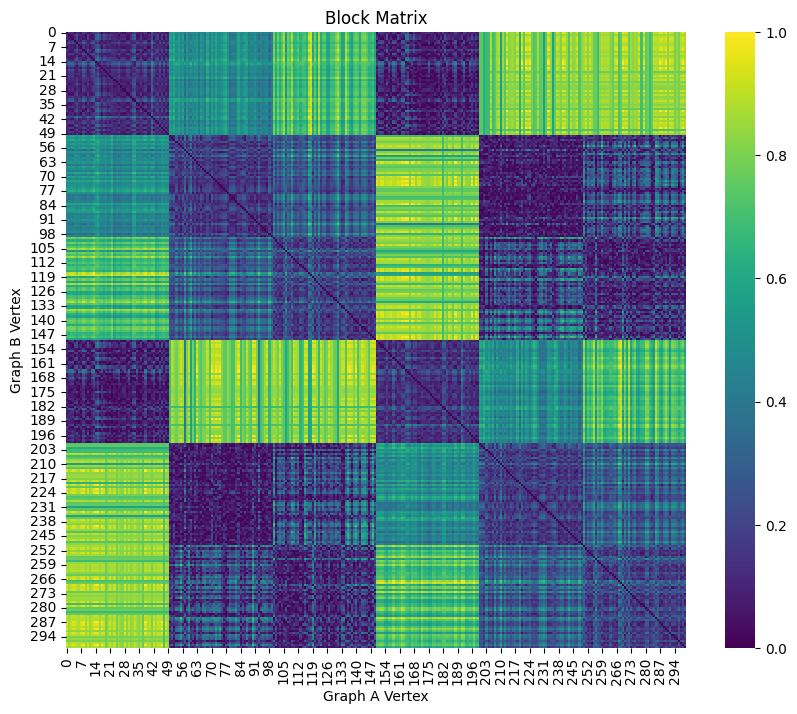

In [76]:
#Show prof this code... Matches very well: test_class = MP(X, Y, rand_ints, knn=5, decay = 1, operation = "average", kind="similarity")
test_class = MP(X, Y, known_anchors, knn=5, decay = 40, operation = "abs", kind="distance")

In [77]:
#Convert to a MDS
emb = mds.fit_transform(test_class.block)

#Stress is a value of how well the emd did. Lower the better.
print(f"Our New Model Stress: {mds.stress_}")
cross_embedding_knn(emb, (labels1, labels2), knn_args = {'n_neighbors': 5}), FOSCTTM(test_class.matrix_AB)

Our New Model Stress: 537.124066341544


(0.9666666666666667, 0.12057777777777777)

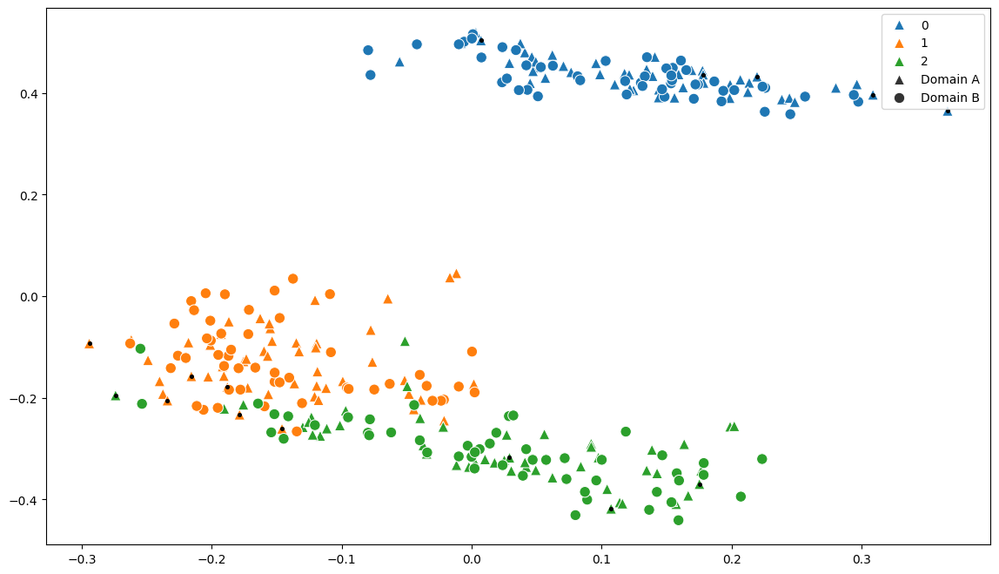

In [78]:
#Veiw the manifold. Those shown as Triangles are from GX
styles = ['Domain A' if i < len(emb[:]) / 2 else 'Domain B' for i in range(len(emb[:]))]

plt.figure(figsize=(14, 8))
ax = sns.scatterplot(x = emb[:, 0], y = emb[:, 1], style = styles, hue = pd.Categorical(labels), s=80, markers= {"Domain A": "^", "Domain B" : "o"})
ax.scatter(emb[test_class.known_anchors_A, 0], emb[test_class.known_anchors_A, 1], s = 7, color = 'black')

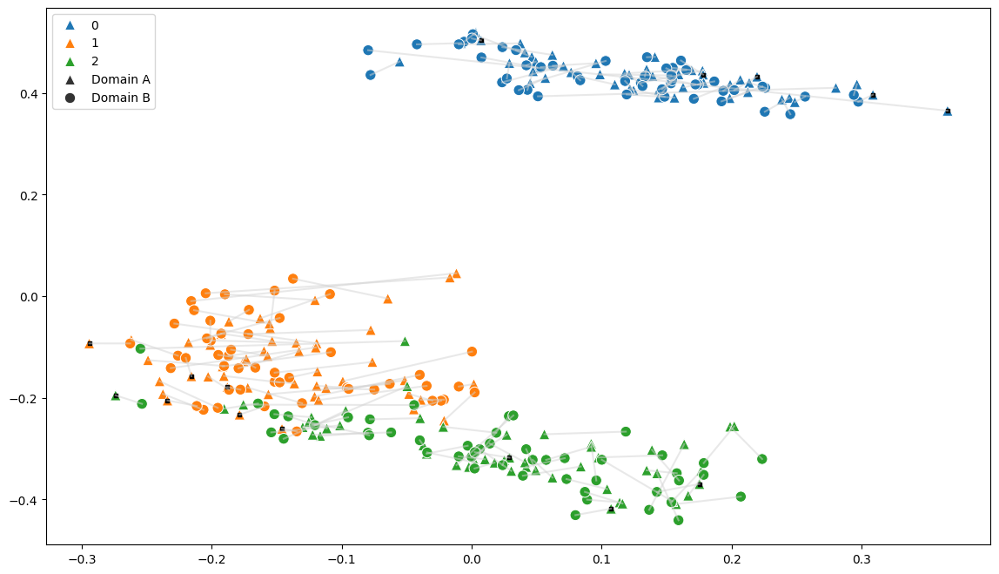

In [79]:
#Veiw it with the connections now:
plt.figure(figsize=(14, 8))
ax = sns.scatterplot(x = emb[:, 0], y = emb[:, 1], hue = pd.Categorical(labels), style = styles, s = 80, markers= {"Domain A": "^", "Domain B" : "o"})
for i in range(n1):
    ax.plot([emb[0 + i, 0], emb[n1 + i, 0]], [emb[0 + i, 1], emb[n1 + i, 1]], color = 'lightgrey', alpha = .5)

#Put black dots on the Anchors
ax.scatter(emb[test_class.known_anchors_A, 0], emb[test_class.known_anchors_A, 1], s = 10, color = 'black', marker="s")

plt.legend()

In [80]:
(1-d_iris.W).max()

1.0

Text(0.5, 1.0, 'Mali')

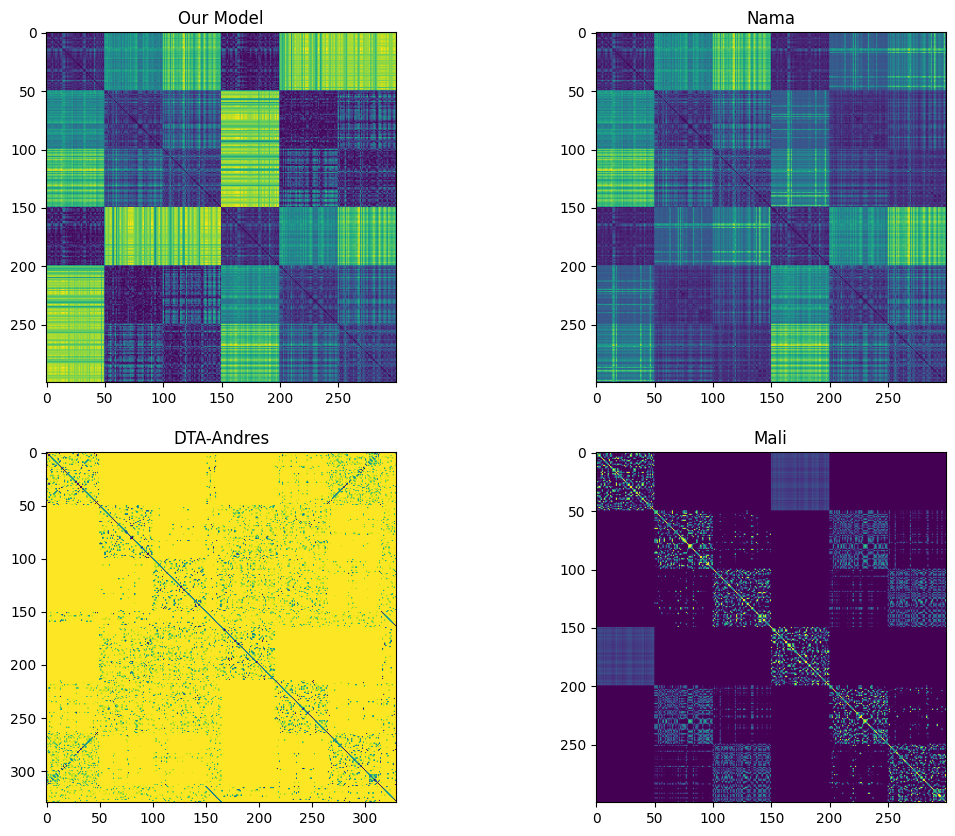

In [81]:
#Compare Heat maps
#Our model
fig, axes = plt.subplots(2, 2, figsize = (13, 10))
axes[0, 0].imshow(test_class.block)
axes[0,0].set_title("Our Model")

#DTA-Andres
axes[1, 0].imshow(2-d_iris.W)
axes[1,0].set_title("DTA-Andres")

#Nama
axes[0,1].imshow(nama.block)
axes[0,1].set_title("Nama")

#Mali
axes[1,1].imshow(mali.W.toarray())
axes[1,1].set_title("Mali")

In [82]:
#Print Our model stres
print(f"Our Model Stress: {mds.stress_}")

##Compare Mali and Nama
mds_nama = mds.fit_transform(nama.block)
print(f"Nama Stress: {mds.stress_}")

mds_mali = mds.fit_transform(np.max(mali.W.toarray())-mali.W.toarray())
print(f"Mali Stress: {mds.stress_}")

#Note: On this one it is normalized to two; It may be more correct to do (d_iris.W).max() - d_iris.W then -> but 1-d_iris.W has a better result 
mds_dta_iris = mds.fit_transform(d_iris.W) #There is also a W2, which seems to make it a little sparser
print(f"DTA-Andres Stress: {mds.stress_}")

""" DTA BY PROF
mds_dta_iris = mds.fit_transform(dta.W)
print(f"DTA Stress: {mds.stress_}")
"""


Our Model Stress: 537.124066341544
Nama Stress: 385.27119499503635
Mali Stress: 1291.2802267508378
DTA-Andres Stress: 4319.304718391446


' DTA BY PROF\nmds_dta_iris = mds.fit_transform(dta.W)\nprint(f"DTA Stress: {mds.stress_}")\n'

Text(0.5, 1.0, 'DTA')

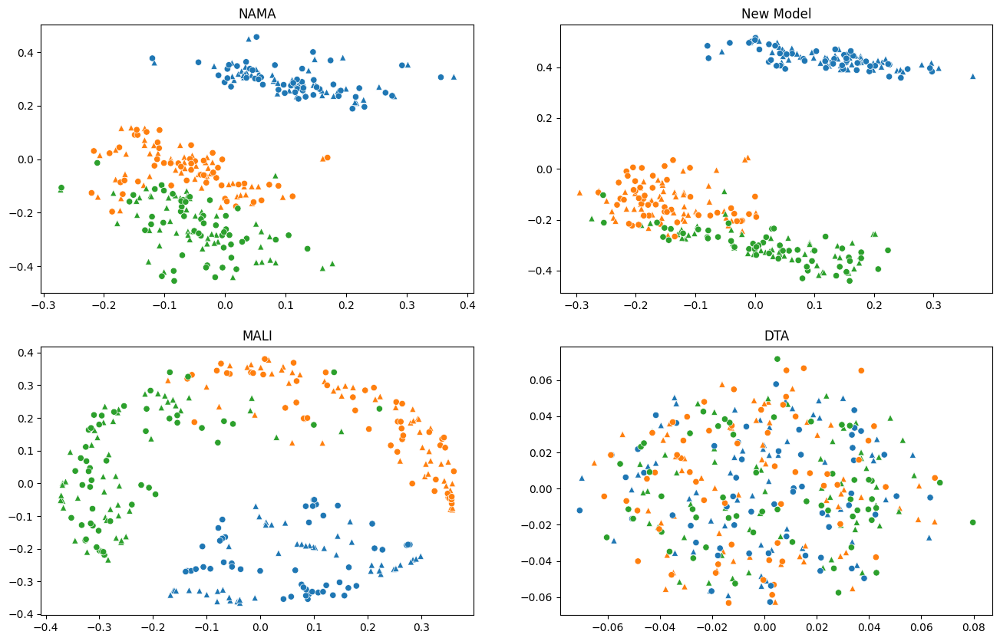

In [83]:
#Plot everything now
styles = ['triangle' if i < len(emb[:]) / 2 else 'circle' for i in range(len(emb[:]))]
fig, axes = plt.subplots(2, 2, figsize = (16, 10))
sns.scatterplot(legend = False, x = mds_nama[:, 0], y = mds_nama[:, 1], hue = pd.Categorical(labels), ax = axes[0,0], style = styles, markers= {"triangle": "^", "circle" : "o"})
axes[0,0].set_title("NAMA")
sns.scatterplot(legend = False, x = mds_mali[:, 0], y = mds_mali[:, 1], hue = pd.Categorical(labels), ax = axes[1,0], style = styles, markers= {"triangle": "^", "circle" : "o"})
axes[1,0].set_title("MALI")
sns.scatterplot(legend = False, x = emb[:, 0], y = emb[:, 1], hue = pd.Categorical(labels), ax = axes[0,1], style = styles, markers= {"triangle": "^", "circle" : "o"})
axes[0,1].set_title("New Model")

#Dta

#Note, we have to create a new styles because the random anchors add to its size
styles_dta = ['triangle' if i < len(mds_dta_iris[:]) / 2 else 'circle' for i in range(len(mds_dta_iris[:]))]

#We got to set the labels for the extened graph
labels1_dta = np.concatenate((labels1, _labelsh1))
labels2_dta = np.concatenate((labels2, _labelsh2))
con_labels_dta = np.concatenate((labels1_dta, labels2_dta))

sns.scatterplot(legend = False, hue = pd.Categorical(con_labels_dta), x = mds_dta_iris[:, 0], y = mds_dta_iris[:, 1], ax = axes[1,1], style = styles_dta, markers= {"triangle": "^", "circle" : "o"})
axes[1,1].set_title("DTA")

In [84]:
#Note: We only set the n neighbors for our model... the other ones don't seem to use KNN in the code, that I could find, so setting it doesn't make sense
print(f"Nama Cross Embedding: {cross_embedding_knn(mds_nama, (labels1, labels2), knn_args = {'n_neighbors': 5})}, Mali CE: {cross_embedding_knn(mds_mali, (labels1, labels2))}, New model CE: {cross_embedding_knn(emb, (labels1, labels2), knn_args = {'n_neighbors': 5})}, DTA-Andres CE: {cross_embedding_knn(mds_dta_iris, (labels1_dta, labels2_dta), knn_args = {'n_neighbors': 5})}")
print(f"Nama FOSCTTM: {FOSCTTM(nama.cross_domain_dists)}, Mali FOSCTTM: {FOSCTTM(np.asarray(1-mali.W_cross.todense()))}, New Model FOSCTTM: {FOSCTTM(test_class.matrix_AB)}, DTA-Andres FOSCTTM: {FOSCTTM((d_iris.W).max() - d_iris.W)}")

Nama Cross Embedding: 0.96, Mali CE: 0.9266666666666666, New model CE: 0.9666666666666667, DTA-Andres CE: 0.3333333333333333
Nama FOSCTTM: 0.09, Mali FOSCTTM: 0.0924, New Model FOSCTTM: 0.12057777777777777, DTA-Andres FOSCTTM: 0.001827364554637282


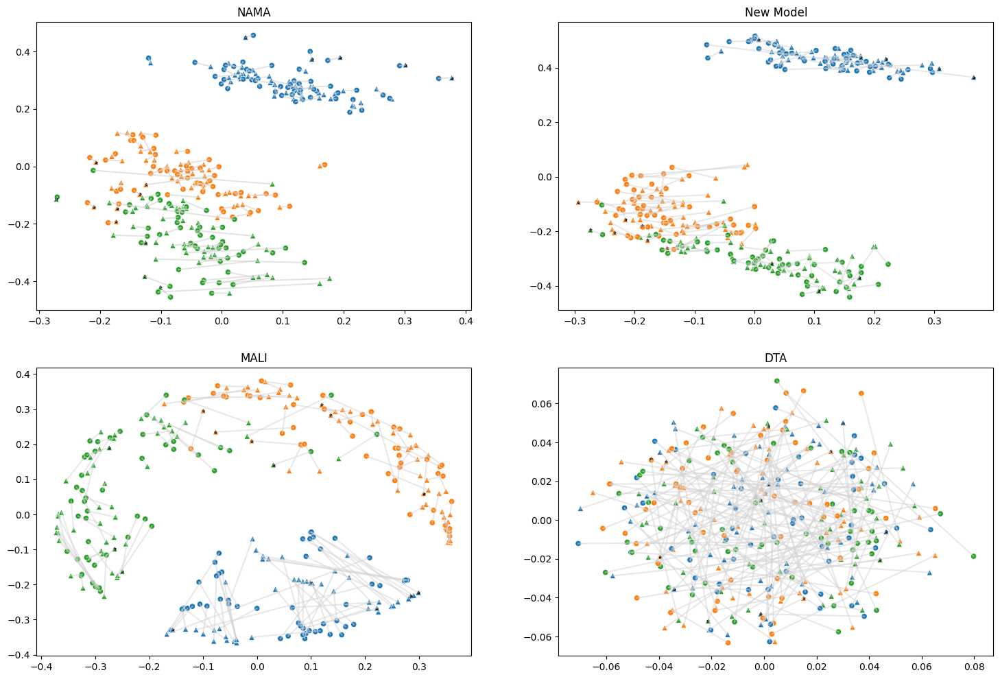

In [85]:
#Show the connections of values
fig, axes = plt.subplots(2, 2, figsize = (18, 12))

#Plot the stuff
sns.scatterplot(legend = False, x = mds_nama[:, 0], y = mds_nama[:, 1], hue = pd.Categorical(labels), ax = axes[0,0], style = styles, markers= {"triangle": "^", "circle" : "o"})
axes[0,0].set_title("NAMA")
sns.scatterplot(legend = False, x = mds_mali[:, 0], y = mds_mali[:, 1], hue = pd.Categorical(labels), ax = axes[1,0], style = styles, markers= {"triangle": "^", "circle" : "o"})
axes[1,0].set_title("MALI")
sns.scatterplot(legend = False, x = emb[:, 0], y = emb[:, 1], hue = pd.Categorical(labels), ax = axes[0,1], style = styles, markers= {"triangle": "^", "circle" : "o"})
axes[0,1].set_title("New Model")
sns.scatterplot(legend = False, hue = pd.Categorical(con_labels_dta), x = mds_dta_iris[:, 0], y = mds_dta_iris[:, 1], ax = axes[1,1], style = styles_dta, markers= {"triangle": "^", "circle" : "o"})
axes[1,1].set_title("DTA")

#Plot the lines
for i in range(n1):
    axes[0,0].plot([mds_nama[0 + i, 0], mds_nama[n1 + i, 0]], [mds_nama[0 + i, 1], mds_nama[n1 + i, 1]], color = 'lightgrey', alpha = .6)
    axes[1,0].plot([mds_mali[0 + i, 0], mds_mali[n1 + i, 0]], [mds_mali[0 + i, 1], mds_mali[n1 + i, 1]], color = 'lightgrey', alpha = .5)
    axes[0,1].plot([emb[0 + i, 0], emb[n1 + i, 0]], [emb[0 + i, 1], emb[n1 + i, 1]], color = 'lightgrey', alpha = .5)

#Cause its dimensions are different:
dta_n1 = int(d_iris.W.shape[0]/2)
for i in range(dta_n1):
    axes[1,1].plot([mds_dta_iris[0 + i, 0], mds_dta_iris[dta_n1 + i, 0]], [mds_dta_iris[0 + i, 1], mds_dta_iris[dta_n1 + i, 1]], color = 'lightgrey', alpha = .5)


#Anchors
axes[0,0].scatter(mds_nama[rand_ints, 0], mds_nama[rand_ints, 1], s = 5, color = 'black', marker="*")
axes[1,0].scatter(mds_mali[rand_ints, 0], mds_mali[rand_ints, 1], s = 5, color = 'black', marker="*")
axes[0,1].scatter(emb[rand_ints, 0], emb[rand_ints, 1], s = 5, color = 'black', marker="*")
axes[1,1].scatter(mds_dta_iris[rand_ints, 0], mds_dta_iris[rand_ints, 1], s = 5, color = 'black', marker="*") #This one might need to be adjusted

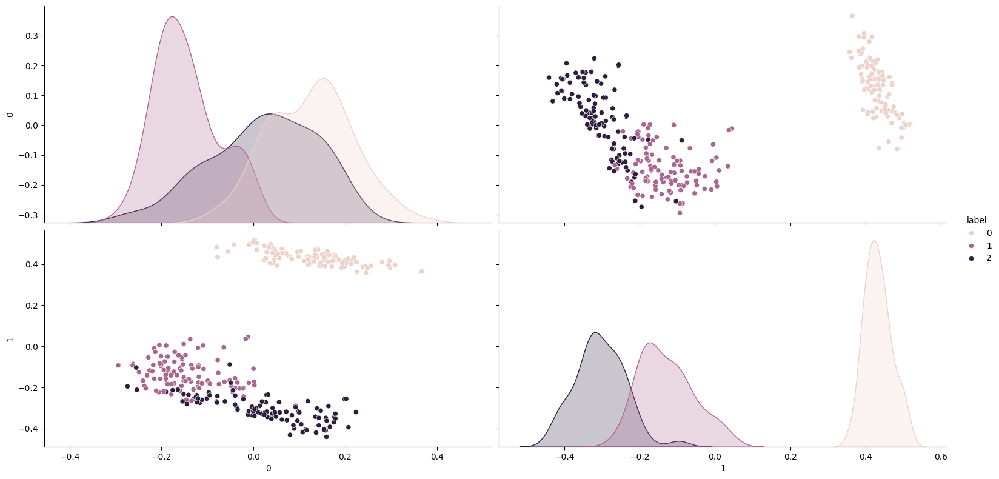

In [86]:
#Goal: find anothe way to visualize how well the model is doing
# Convert the embedding and labels into a DataFrame
df_emb = pd.DataFrame(emb)
df_emb['label'] = np.concatenate([labels1, labels2])

# Now, use seaborn's pairplot to visualize the multidimensional relationships
sns.pairplot(df_emb, hue='label', height=4, aspect=2)

In [87]:
#Veiw the difference between pure and not pure with fully connected graphs
"""
#Class 1
test_class = MP(X, Y, rand_ints[:2], knn=5)
XYblock = test_class.get_block_matrix(pure=True, show = False)
emb = mds.fit_transform(XYblock)

#Class 2
test_class2 = MP(X, Y, rand_ints[:2], knn="connect")
XYblock2 = test_class2.get_block_matrix(pure=True, show = False)
emb2 = mds.fit_transform(XYblock2)

#plot them
fig, axes = plt.subplots(1, 2, figsize = (16, 6), sharex=True, sharey=True)
fig.suptitle("Comparing Less Anchor point graphs using by not connected data (left) and fully connected data (Right)")
ax2 = sns.scatterplot(x = emb2[:, 0], y = emb2[:, 1], s = 60, hue = pd.Categorical(labels), ax = axes[1], style = styles, markers= {"triangle": "^", "circle" : "o"})
ax1 = sns.scatterplot(x = emb[:, 0], y = emb[:, 1], s = 60, hue = pd.Categorical(labels), ax = axes[0], style = styles, markers= {"triangle": "^", "circle" : "o"})

#Plot the anchors
ax1.scatter(emb[test_class.known_anchors, 0], emb[test_class.known_anchors, 1], s = 5, color = 'black', marker="s", alpha = 0.5)
ax2.scatter(emb2[test_class2.known_anchors, 0], emb2[test_class2.known_anchors, 1], s = 5, color = 'black', marker="s", alpha = 0.5)
"""

'\n#Class 1\ntest_class = MP(X, Y, rand_ints[:2], knn=5)\nXYblock = test_class.get_block_matrix(pure=True, show = False)\nemb = mds.fit_transform(XYblock)\n\n#Class 2\ntest_class2 = MP(X, Y, rand_ints[:2], knn="connect")\nXYblock2 = test_class2.get_block_matrix(pure=True, show = False)\nemb2 = mds.fit_transform(XYblock2)\n\n#plot them\nfig, axes = plt.subplots(1, 2, figsize = (16, 6), sharex=True, sharey=True)\nfig.suptitle("Comparing Less Anchor point graphs using by not connected data (left) and fully connected data (Right)")\nax2 = sns.scatterplot(x = emb2[:, 0], y = emb2[:, 1], s = 60, hue = pd.Categorical(labels), ax = axes[1], style = styles, markers= {"triangle": "^", "circle" : "o"})\nax1 = sns.scatterplot(x = emb[:, 0], y = emb[:, 1], s = 60, hue = pd.Categorical(labels), ax = axes[0], style = styles, markers= {"triangle": "^", "circle" : "o"})\n\n#Plot the anchors\nax1.scatter(emb[test_class.known_anchors, 0], emb[test_class.known_anchors, 1], s = 5, color = \'black\', marker

### S curve and Roll dataset

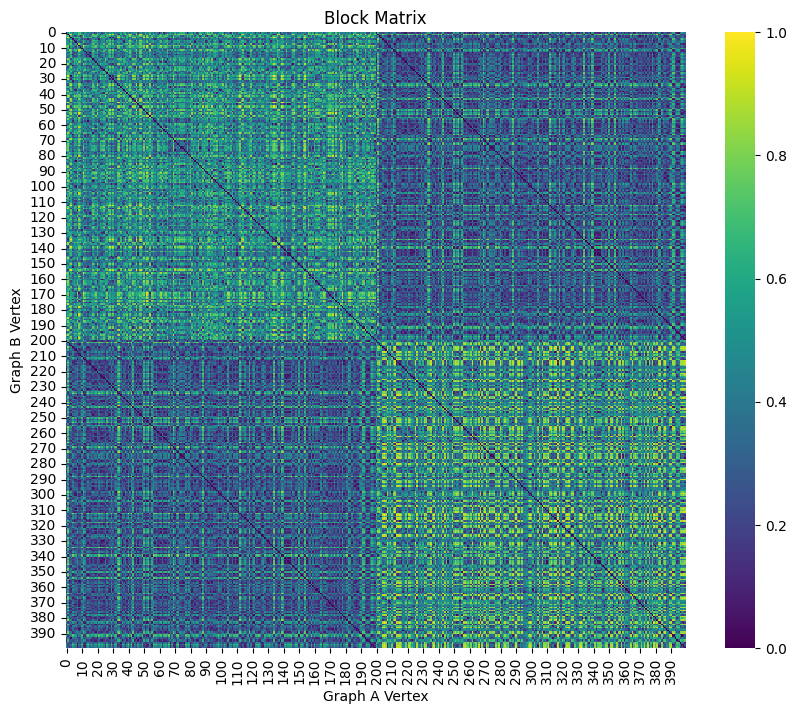

In [88]:
s_roll = MP(SX, SY, s_known_anchors, knn=5, decay = 1, operation = "abs", kind="pure distance")

In [89]:
#Convert to a MDS
embS = mds.fit_transform(s_roll.block)

#Stress is a value of how well the emd did. Lower the better.
print(f"Our New Model Stress: {mds.stress_}")

Our New Model Stress: 1822.2182979686363


<Axes: >

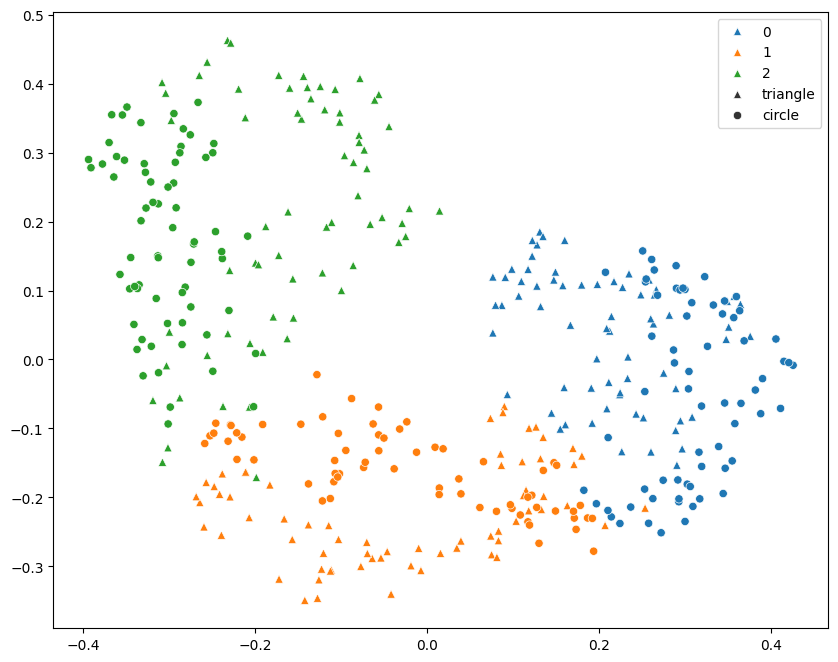

In [90]:
#Veiw the manifold. Those shown as Triangles are from GX
stylesS = ['triangle' if i < len(embS[:]) / 2 else 'circle' for i in range(len(embS[:]))]
plt.figure(figsize=(10, 8))
sns.scatterplot(x = embS[:, 0], y = embS[:, 1], hue = pd.Categorical(Slabels), style = stylesS, markers= {"triangle": "^", "circle" : "o"})

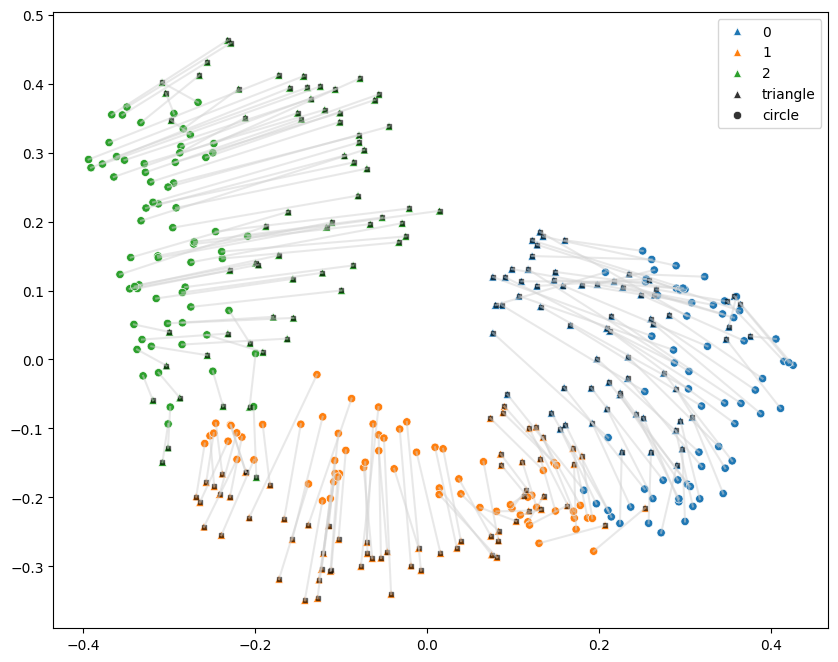

In [91]:
#Veiw it with the connections now:
plt.figure(figsize=(10, 8))
ax = sns.scatterplot(x = embS[:, 0], y = embS[:, 1], hue = pd.Categorical(Slabels), style = stylesS, markers= {"triangle": "^", "circle" : "o"})
for i in range(n2):
    ax.plot([embS[0 + i, 0], embS[n2 + i, 0]], [embS[0 + i, 1], embS[n2 + i, 1]], color = 'lightgrey', alpha = .5)

#Plot the anchors
ax.scatter(embS[s_roll.known_anchors_A, 0], embS[s_roll.known_anchors_A, 1], s = 5, color = 'black', marker="s", alpha = 0.5)

Text(0.5, 1.0, 'Mali')

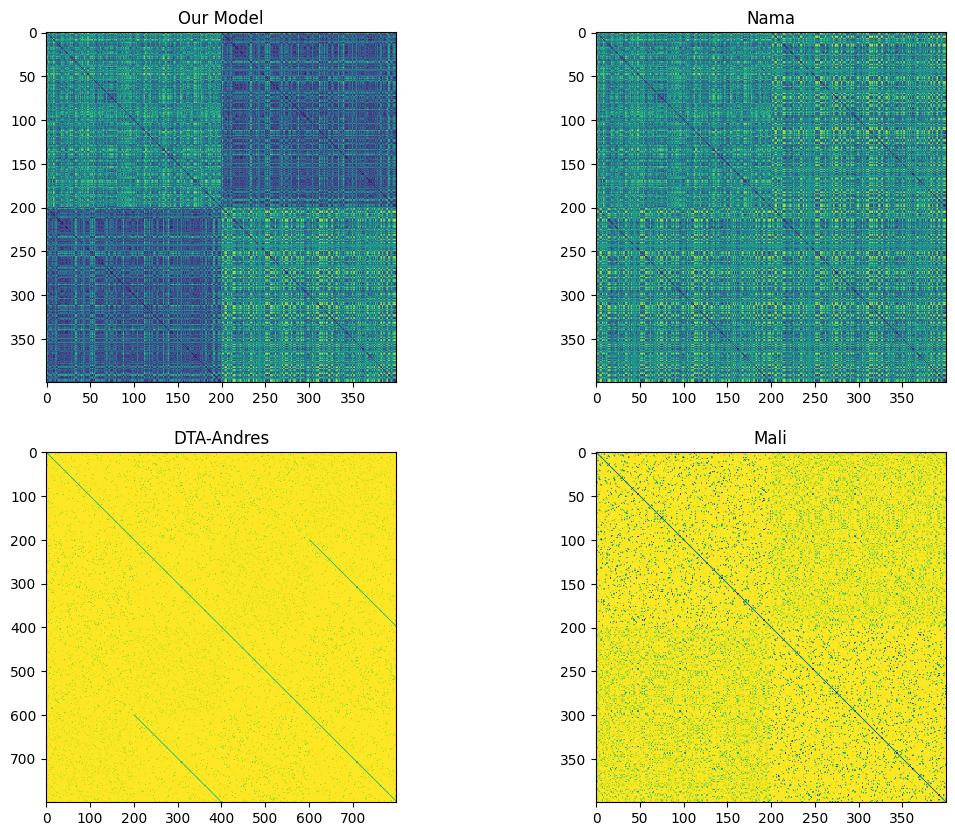

In [92]:
#Compare Heat maps
#Our model
fig, axes = plt.subplots(2, 2, figsize = (13, 10))
axes[0, 0].imshow(s_roll.block)
axes[0,0].set_title("Our Model")

#DTA-Andres
axes[1, 0].imshow(np.max(d_Scurve.W) - d_Scurve.W) #This is done because it returns a similarity graph
axes[1,0].set_title("DTA-Andres")

#Nama
axes[0,1].imshow(namaS.block)
axes[0,1].set_title("Nama")

#Mali
axes[1,1].imshow(np.max(maliS.W.toarray()) - maliS.W.toarray()) #This is done because it is showing a similarity graph
axes[1,1].set_title("Mali")

In [93]:
#Stress is a value of how well the emd did. Lower the better.
print(f"Our New Model Stress: {mds.stress_}")

##Compare Mali and Nama
mds_namaS = mds.fit_transform(namaS.block)
print(f"Nama Stress: {mds.stress_}")

mds_maliS = mds.fit_transform(np.max(maliS.W.toarray()) - maliS.W.toarray()) #Note, the maximum value for Mali is actually 0.5. Maybe that would be the more correct one to use
print(f"Mali Stress: {mds.stress_}")

#Note: On this one it is normalized to two; It may be more correct to do (d_iris.W).max() - d_iris.W then -> but 1-d_iris.W has a better result 
mds_dta_Scurve = mds.fit_transform(np.max(d_Scurve.W) - d_Scurve.W) #There is also a W2, which seems to make it a little sparser
print(f"DTA-Andres Stress: {mds.stress_}")


Our New Model Stress: 1822.2182979686363
Nama Stress: 1188.520835204316
Mali Stress: 2602.6494829509247
DTA-Andres Stress: 218078.43579948138


<Axes: title={'center': 'DTA'}>

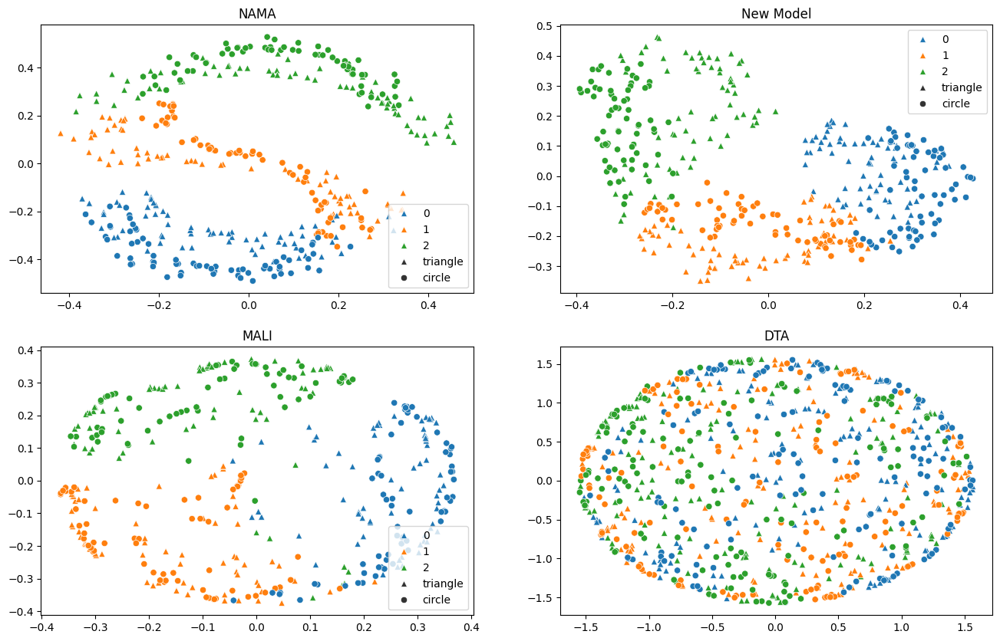

In [94]:
#PLOT them against each other
#Start plotting
fig, axes = plt.subplots(2, 2, figsize = (16, 10))
axes[0,0].set_title("NAMA")
axes[1,0].set_title("MALI")
axes[0,1].set_title("New Model")
axes[1,1].set_title("DTA")

sns.scatterplot(x = mds_namaS[:, 0], y = mds_namaS[:, 1], hue = pd.Categorical(Slabels), ax = axes[0, 0], style = stylesS, markers= {"triangle": "^", "circle" : "o"})
sns.scatterplot(x = mds_maliS[:, 0], y = mds_maliS[:, 1], hue = pd.Categorical(Slabels), ax = axes[1,0], style = stylesS, markers= {"triangle": "^", "circle" : "o"})
sns.scatterplot(x = embS[:, 0], y = embS[:, 1], hue = pd.Categorical(Slabels), ax = axes[0,1], style = stylesS, markers= {"triangle": "^", "circle" : "o"})

#Dta

#Note, we have to create a new styles because the random anchors add to its size
styles_dta_S = ['triangle' if i < len(mds_dta_Scurve[:]) / 2 else 'circle' for i in range(len(mds_dta_Scurve[:]))]

#We got to set the labels for the extened graph
labels1_dta_S = np.concatenate((labelX, s_labelsh1))
labels2_dta_S = np.concatenate((labelY, s_labelsh2))
con_labels_dta_S = np.concatenate((labels1_dta_S, labels2_dta_S))

sns.scatterplot(legend = False, hue = pd.Categorical(con_labels_dta_S), x = mds_dta_Scurve[:, 0], y = mds_dta_Scurve[:, 1], ax = axes[1,1], style = styles_dta_S, markers= {"triangle": "^", "circle" : "o"})

In [95]:
#Note: We only set the n neighbors for our model... the other ones don't seem to use KNN in the code, that I could find, so setting it doesn't make sense
print(f"Nama Cross Embedding: {cross_embedding_knn(mds_namaS, (labelX, labelY), knn_args = {'n_neighbors': 1})}, Mali CE: {cross_embedding_knn(mds_maliS, (labelX, labelY))}, New model CE: {cross_embedding_knn(embS, (labelX, labelY), knn_args = {'n_neighbors': 5})}, DTA-Andres CE: {cross_embedding_knn(mds_dta_Scurve, (labels1_dta_S, labels2_dta_S), knn_args = {'n_neighbors': 5})}")
print(f"Nama FOSCTTM: {FOSCTTM(namaS.cross_domain_dists)}, Mali FOSCTTM: {FOSCTTM(np.max(maliS.W.toarray()) - maliS.W.toarray())}, New Model FOSCTTM: {FOSCTTM(s_roll.matrix_AB)}, DTA-Andres FOSCTTM: {FOSCTTM(np.max(d_Scurve.W) - d_Scurve.W)}")

Nama Cross Embedding: 0.915, Mali CE: 0.91, New model CE: 0.91, DTA-Andres CE: 0.55
Nama FOSCTTM: 0.0, Mali FOSCTTM: 0.0, New Model FOSCTTM: 0.0, DTA-Andres FOSCTTM: 0.0014921874999999998


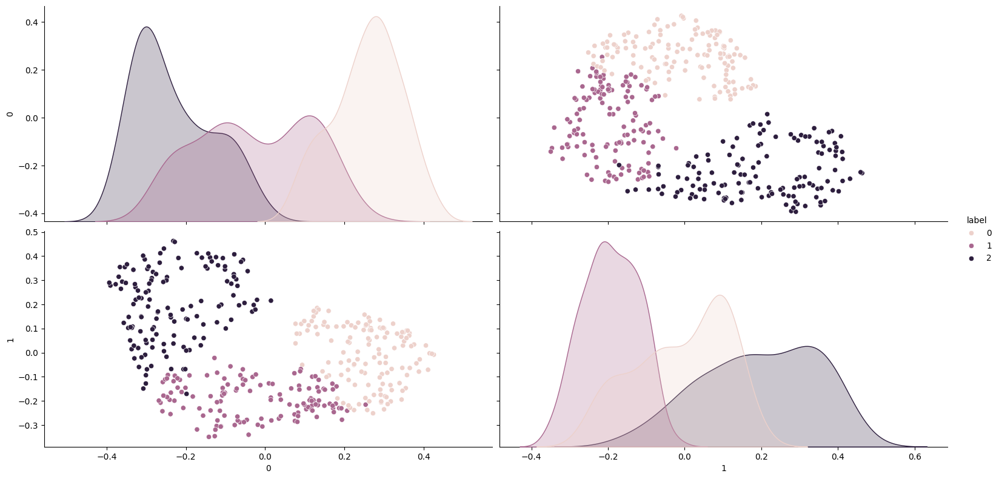

In [96]:
#Goal: find anothe way to visualize how well the model is doing
# Convert the embedding and labels into a DataFrame
df_embS = pd.DataFrame(embS)
df_embS['label'] = Slabels

# Now, use seaborn's pairplot to visualize the multidimensional relationships
sns.pairplot(df_embS, hue='label', height=4, aspect=2)

### M-Nist DataSet

/yunity/arusty/.local/lib/python3.10/site-packages/graphtools/graphs.py:122: UserWarning: Building a kNNGraph on data of shape (200, 784) is expensive. Consider setting n_pca.
  warnings.warn(
/yunity/arusty/.local/lib/python3.10/site-packages/graphtools/graphs.py:122: UserWarning: Building a kNNGraph on data of shape (200, 784) is expensive. Consider setting n_pca.
  warnings.warn(
/yunity/arusty/.local/lib/python3.10/site-packages/graphtools/graphs.py:122: UserWarning: Building a kNNGraph on data of shape (200, 784) is expensive. Consider setting n_pca.
  warnings.warn(
/yunity/arusty/.local/lib/python3.10/site-packages/graphtools/graphs.py:122: UserWarning: Building a kNNGraph on data of shape (200, 784) is expensive. Consider setting n_pca.
  warnings.warn(


All distance to anchors: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0.]


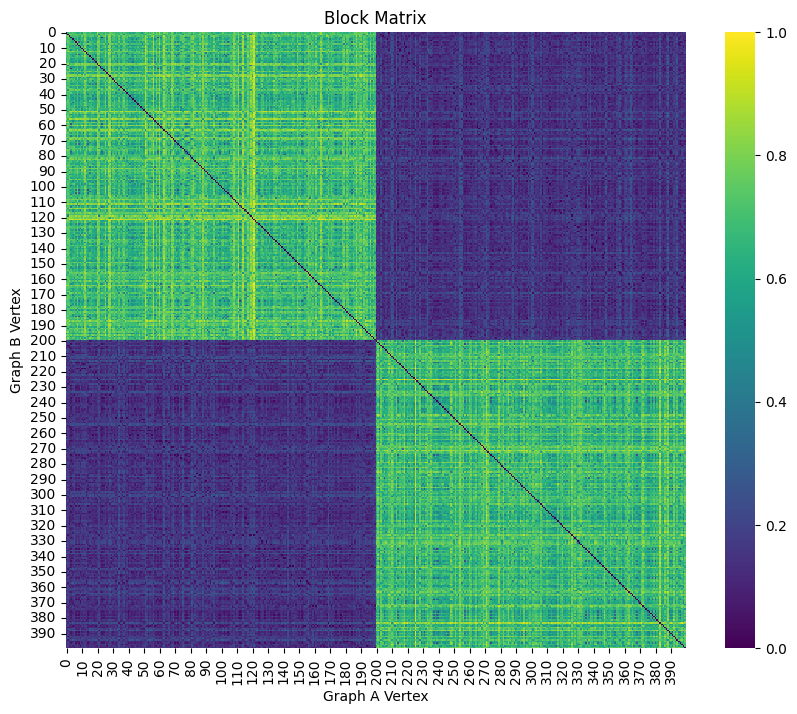

In [97]:
#Create a new class
MN_class = MP(o1, o2, known_anchorsM, knn=4, decay=15, operation = "average", kind="distance") #testing decay of 10

embM = phate.fit_transform(MN_class.block)

Text(0.5, 1.0, 'Graph B')

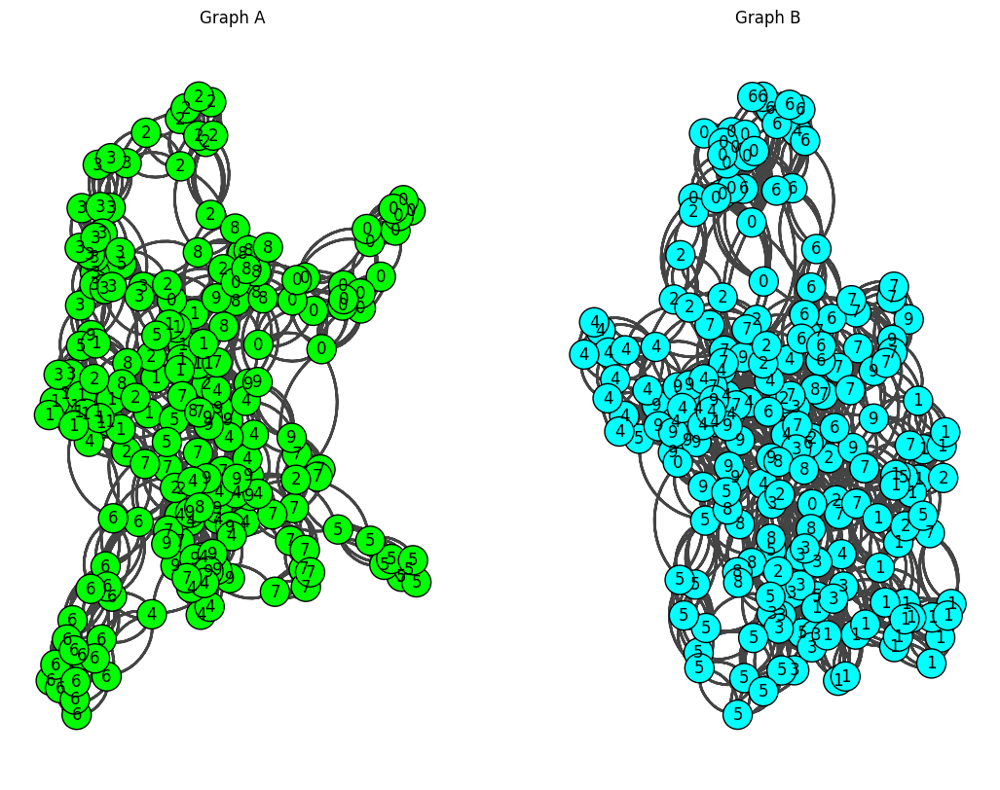

In [98]:
fig, axes = plt.subplots(1, 2, figsize = (13, 10))
ig.plot(MN_class.graphA, vertex_color=['green'], target=axes[0], vertex_label= p1)
ig.plot(MN_class.graphB, vertex_color=['cyan'], target=axes[1], vertex_label= p2)
axes[0].set_title("Graph A")
axes[1].set_title("Graph B")

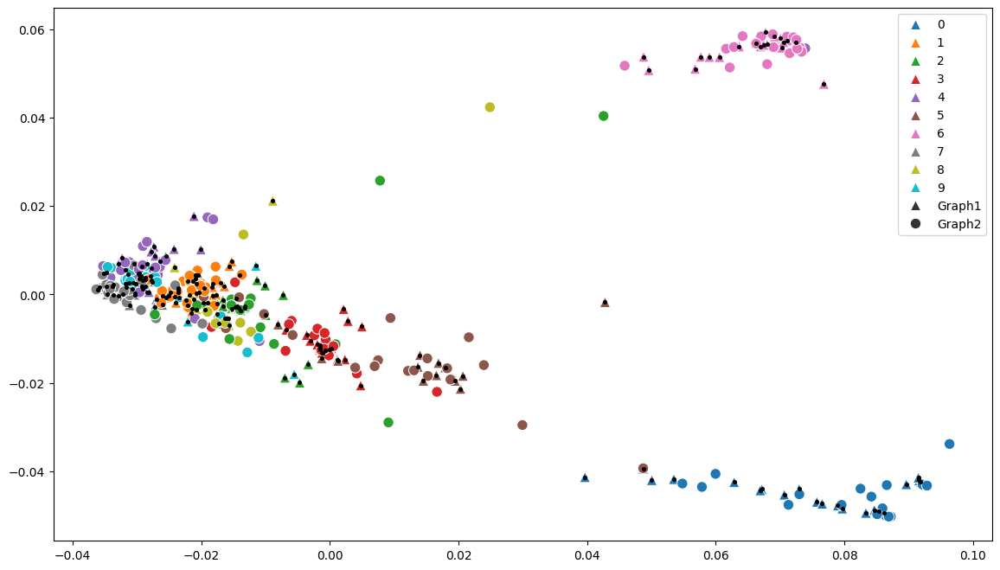

In [99]:
#Veiw the manifold. Those shown as Triangles are from GX
stylesM = ['Graph1' if i < len(embM[:]) / 2 else 'Graph2' for i in range(len(embM[:]))]

plt.figure(figsize=(14, 8))
ax = sns.scatterplot(x = embM[:, 0], y = embM[:, 1], style = stylesM, hue = pd.Categorical(labelsM), s=80, markers= {"Graph1": "^", "Graph2" : "o"})
ax.scatter(embM[MN_class.known_anchors_A, 0], embM[MN_class.known_anchors_A, 1], s = 7, color = 'black')

Text(0.5, 1.0, 'Mali')

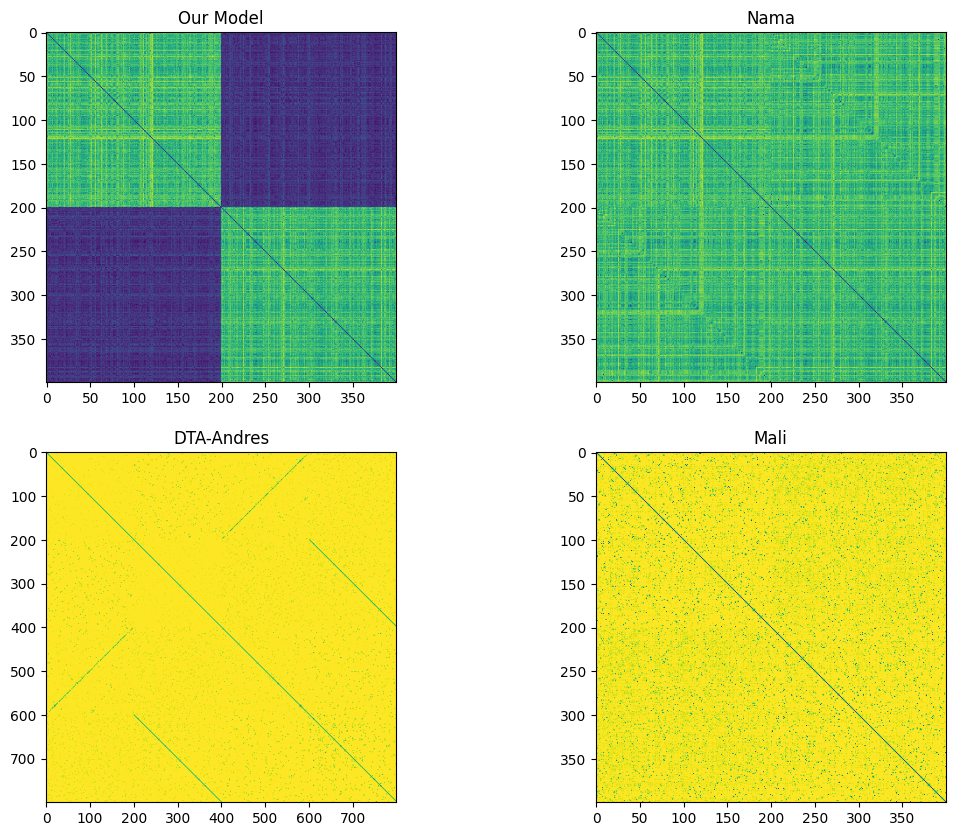

In [100]:
#Compare Heat maps
#Our model
fig, axes = plt.subplots(2, 2, figsize = (13, 10))
axes[0, 0].imshow(MN_class.block)
axes[0,0].set_title("Our Model")

#DTA-Andres
axes[1, 0].imshow(np.max(d_Mnist.W) - d_Mnist.W) #This is done because it returns a similarity graph
axes[1,0].set_title("DTA-Andres")

#Nama
axes[0,1].imshow(namaM.block)
axes[0,1].set_title("Nama")

#Mali
axes[1,1].imshow(np.max(maliM.W.toarray()) - maliM.W.toarray()) #This is done because it is showing a similarity graph
axes[1,1].set_title("Mali")

In [101]:
#Stress is a value of how well the emd did. Lower the better.
#print(f"Our New Model Stress: {mdsM.stress_}")

##Compare Mali and Nama
mds_namaM = phate.fit_transform(namaM.block)
#print(f"Nama Stress: {mdsM.stress_}")

mds_maliM = phate.fit_transform(np.max(maliM.W.toarray()) - maliM.W.toarray()) #Note, the maximum value for Mali is actually 0.5. Maybe that would be the more correct one to use
#print(f"Mali Stress: {mdsM.stress_}")

#Note: On this one it is normalized to two; It may be more correct to do (d_iris.W).max() - d_iris.W then -> but 1-d_iris.W has a better result 
mds_dta_Mnist = phate.fit_transform(np.max(d_Mnist.W) - d_Mnist.W) #There is also a W2, which seems to make it a little sparser
#print(f"DTA-Andres Stress: {mdsM.stress_}")

<Axes: title={'center': 'DTA'}>

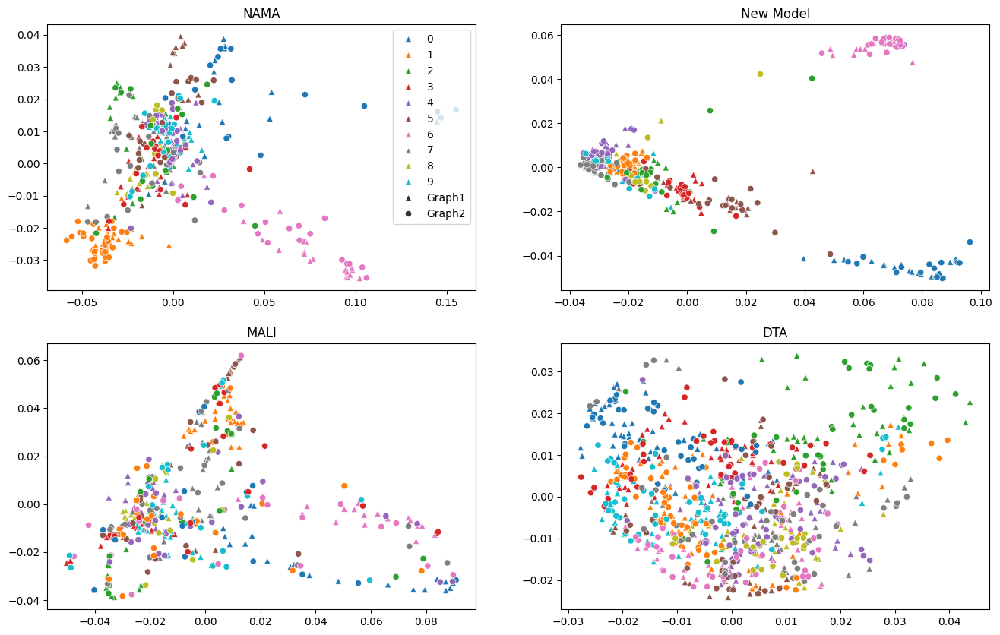

In [102]:
#Lets plot the Graphs together
fig, axes = plt.subplots(2, 2, figsize = (16, 10))
axes[0,0].set_title("NAMA")
axes[1,0].set_title("MALI")
axes[0,1].set_title("New Model")
axes[1,1].set_title("DTA")

#Now the plotting
sns.scatterplot(x = mds_namaM[:, 0], y = mds_namaM[:, 1], ax = axes[0,0], markers= {"Graph1": "^", "Graph2" : "o"}, style = stylesM, hue = pd.Categorical(np.hstack((p1, p2))))
sns.scatterplot(legend = False, x = mds_maliM[:, 0], y = mds_maliM[:, 1], ax = axes[1,0], markers= {"Graph1": "^", "Graph2" : "o"}, style = stylesM, hue = pd.Categorical(np.hstack((p1, p2))))
sns.scatterplot(legend = False, x = embM[:, 0], y = embM[:, 1], style = stylesM, ax = axes[0,1], hue = pd.Categorical(labelsM), markers= {"Graph1": "^", "Graph2" : "o"})

#Dta

#Note, we have to create a new styles because the random anchors add to its size
styles_dta_M = ['triangle' if i < len(mds_dta_Mnist[:]) / 2 else 'circle' for i in range(len(mds_dta_Mnist[:]))]

#We got to set the labels for the extened graph
labels1_dta_M = np.concatenate((p1, m_labelsh1))
labels2_dta_M = np.concatenate((p2, m_labelsh2))
con_labels_dta_M = np.concatenate((labels1_dta_M, labels2_dta_M))

sns.scatterplot(legend = False, hue = pd.Categorical(con_labels_dta_M), x = mds_dta_Mnist[:, 0], y = mds_dta_Mnist[:, 1], ax = axes[1,1], style = styles_dta_M, markers= {"triangle": "^", "circle" : "o"})

Interestingly, none of the models seem to do great with the MNist data. Maybe this is because the 2nd dataset is completely different, and the correlations are just to another value in the same class.

Mali and DTA seem to be the better of the two when the known correspondence is low. However, when the known-correspondce is high our model suddenly become very good. (However, in real application, we might not know that much correspondence)

/yunity/arusty/.local/lib/python3.10/site-packages/graphtools/graphs.py:122: UserWarning: Building a kNNGraph on data of shape (200, 784) is expensive. Consider setting n_pca.
  warnings.warn(
/yunity/arusty/.local/lib/python3.10/site-packages/graphtools/graphs.py:122: UserWarning: Building a kNNGraph on data of shape (200, 784) is expensive. Consider setting n_pca.
  warnings.warn(
/yunity/arusty/.local/lib/python3.10/site-packages/graphtools/graphs.py:122: UserWarning: Building a kNNGraph on data of shape (200, 784) is expensive. Consider setting n_pca.
  warnings.warn(
/yunity/arusty/.local/lib/python3.10/site-packages/graphtools/graphs.py:122: UserWarning: Building a kNNGraph on data of shape (200, 784) is expensive. Consider setting n_pca.
  warnings.warn(


All distance to anchors: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0.]


/yunity/arusty/.local/lib/python3.10/site-packages/graphtools/graphs.py:122: UserWarning: Building a kNNGraph on data of shape (200, 784) is expensive. Consider setting n_pca.
  warnings.warn(
/yunity/arusty/.local/lib/python3.10/site-packages/graphtools/graphs.py:122: UserWarning: Building a kNNGraph on data of shape (200, 784) is expensive. Consider setting n_pca.
  warnings.warn(
/yunity/arusty/.local/lib/python3.10/site-packages/graphtools/graphs.py:122: UserWarning: Building a kNNGraph on data of shape (200, 784) is expensive. Consider setting n_pca.
  warnings.warn(
/yunity/arusty/.local/lib/python3.10/site-packages/graphtools/graphs.py:122: UserWarning: Building a kNNGraph on data of shape (200, 784) is expensive. Consider setting n_pca.
  warnings.warn(
/yunity/arusty/.local/lib/python3.10/site-packages/graphtools/graphs.py:122: UserWarning: Building a kNNGraph on data of shape (200, 784) is expensive. Consider setting n_pca.
  warnings.warn(
/yunity/arusty/.local/lib/python3.1

All distance to anchors: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0.]


/yunity/arusty/.local/lib/python3.10/site-packages/graphtools/graphs.py:122: UserWarning: Building a kNNGraph on data of shape (200, 784) is expensive. Consider setting n_pca.
  warnings.warn(
/yunity/arusty/.local/lib/python3.10/site-packages/graphtools/graphs.py:122: UserWarning: Building a kNNGraph on data of shape (200, 784) is expensive. Consider setting n_pca.
  warnings.warn(
/yunity/arusty/.local/lib/python3.10/site-packages/graphtools/graphs.py:122: UserWarning: Building a kNNGraph on data of shape (200, 784) is expensive. Consider setting n_pca.
  warnings.warn(
/yunity/arusty/.local/lib/python3.10/site-packages/graphtools/graphs.py:122: UserWarning: Building a kNNGraph on data of shape (200, 784) is expensive. Consider setting n_pca.
  warnings.warn(
/yunity/arusty/.local/lib/python3.10/site-packages/graphtools/graphs.py:122: UserWarning: Building a kNNGraph on data of shape (200, 784) is expensive. Consider setting n_pca.
  warnings.warn(
/yunity/arusty/.local/lib/python3.1

Using average operation


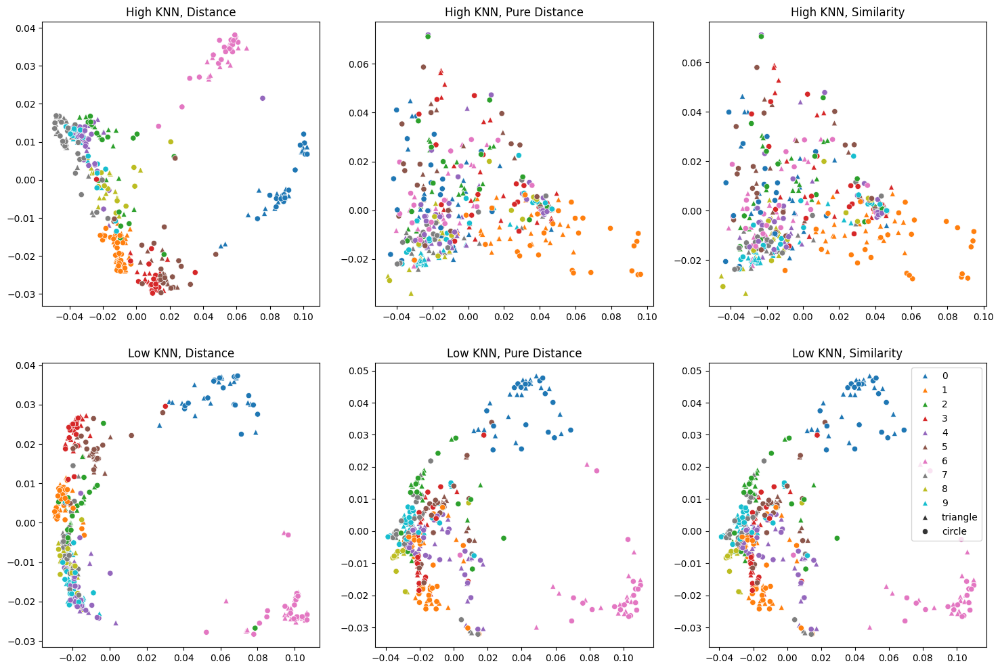

In [103]:
OPER = "average"
#High KNN
toy_class1 = MP(o1, o2, known_anchorsM, knn=SIZE-2, decay = 1, operation = OPER, kind="distance", show = False)
toy_class2 = MP(o1, o2, known_anchorsM, knn=SIZE-2, decay = 1, operation = OPER, kind="pure distance", show = False)
toy_class3 = MP(o1, o2, known_anchorsM, knn=SIZE-2, decay = 1, operation = OPER, kind="similarity", show = False)

#Low KNN
toy_class4 = MP(o1, o2, known_anchorsM, knn=2, decay = 40, operation = OPER, kind="distance", show = False)
toy_class5 = MP(o1, o2, known_anchorsM, knn=2, decay = 40, operation = OPER, kind="pure distance", show = False)
toy_class6 = MP(o1, o2, known_anchorsM, knn=2, decay = 40, operation = OPER, kind="similarity", show = False)

#Embed the data
emb1 = phate.fit_transform(toy_class1.block)
emb2 = phate.fit_transform(toy_class2.block)
emb3 = phate.fit_transform(toy_class3.block)
emb4 = phate.fit_transform(toy_class4.block)
emb5 = phate.fit_transform(toy_class5.block)
emb6 = phate.fit_transform(toy_class6.block)

#plot the data
styles = ['triangle' if i < len(emb1[:]) / 2 else 'circle' for i in range(len(emb1[:]))]
fig, axes = plt.subplots(2, 3, figsize = (18, 12))

#SNS plotting
sns.scatterplot(legend = False, x = emb1[:, 0], y = emb1[:, 1], hue = pd.Categorical(labelsM), ax = axes[0,0], style = styles, markers= {"triangle": "^", "circle" : "o"})
sns.scatterplot(legend = False, x = emb2[:, 0], y = emb2[:, 1], hue = pd.Categorical(labelsM), ax = axes[0,1], style = styles, markers= {"triangle": "^", "circle" : "o"})
sns.scatterplot(legend = False, x = emb3[:, 0], y = emb3[:, 1], hue = pd.Categorical(labelsM), ax = axes[0,2], style = styles, markers= {"triangle": "^", "circle" : "o"})
sns.scatterplot(legend = False, x = emb4[:, 0], y = emb4[:, 1], hue = pd.Categorical(labelsM), ax = axes[1,0], style = styles, markers= {"triangle": "^", "circle" : "o"})
sns.scatterplot(legend = False, x = emb5[:, 0], y = emb5[:, 1], hue = pd.Categorical(labelsM), ax = axes[1,1], style = styles, markers= {"triangle": "^", "circle" : "o"})
sns.scatterplot(legend = True, x = emb6[:, 0], y = emb6[:, 1], hue = pd.Categorical(labelsM), ax = axes[1,2], style = styles, markers= {"triangle": "^", "circle" : "o"})

#Set titles
axes[0,0].set_title("High KNN, Distance")
axes[0,1].set_title("High KNN, Pure Distance")
axes[0,2].set_title("High KNN, Similarity")
axes[1,0].set_title("Low KNN, Distance")
axes[1,1].set_title("Low KNN, Pure Distance")
axes[1,2].set_title("Low KNN, Similarity")

"""#Plot the lines
for i in range(n1):
    axes[0,0].plot([emb1[0 + i, 0], emb1[n1 + i, 0]], [emb1[0 + i, 1], emb1[n1 + i, 1]], color = 'lightgrey', alpha = .5)
    axes[0,1].plot([emb2[0 + i, 0], emb2[n1 + i, 0]], [emb2[0 + i, 1], emb2[n1 + i, 1]], color = 'lightgrey', alpha = .5)
    axes[0,2].plot([emb3[0 + i, 0], emb3[n1 + i, 0]], [emb3[0 + i, 1], emb3[n1 + i, 1]], color = 'lightgrey', alpha = .5)
    axes[1,0].plot([emb4[0 + i, 0], emb4[n1 + i, 0]], [emb4[0 + i, 1], emb4[n1 + i, 1]], color = 'lightgrey', alpha = .5)
    axes[1,1].plot([emb5[0 + i, 0], emb5[n1 + i, 0]], [emb5[0 + i, 1], emb5[n1 + i, 1]], color = 'lightgrey', alpha = .5)
    axes[1,2].plot([emb6[0 + i, 0], emb6[n1 + i, 0]], [emb6[0 + i, 1], emb6[n1 + i, 1]], color = 'lightgrey', alpha = .5)
"""

print(f"Using {OPER} operation")

### Observations and Notes
---
Observation 2
1. The GY/GX data seems to be more clustered with fewer anchor points. When you add more anchor points, the graph seems to be spread out more, but is typically still much tighter than the other methods.
2. The GY/GX data has the same behavior when you add more nearest neighbor connections, meaning the data will spread out more. Its accuracy seems higher actually with less neighbors. After testing, the sweet spot seems around 4-5.

Hypothesis
*   This is likely because each point follows a similar path to get to the anchor node, and thus has similar values. However, when we add more anchor points, each node can take a more independent route. If this is true, than the ideal amount of anchor points would be 1 for each class.
-> After testing, using only one anchor point per class doesn't seem to make a difference


---

Observation 4
1. The Stress of the MDS for our model is about double Mali and Nama.

Hypothesis:
1. Not sure why. This is an indication that the MDS on average is a lot farther away at representing the high data to low -- could be because our data types are changed.

---
List of Parameters that seem to make an impact:
1. Amount of nearest neighbors. This shouldn't change the graph too much, but the decay must be adjusted accordingly. The higher the KNN the smaller the decay should be.
2. Amount of anchors. See observation 2.
3. What value we set inf to. Surprisingly, if we set it to two (which ensures it will remain the highest value or equal to it) then we seem to get the best results. If it is too high, it splits the data within classes. --- TODO: This behavior may be different using the ABS value method.
4. Whether or not we use the actual distances versus the Igraph distances for our original distance matrix. Use the pure distance matrix.
5. Whether or not our graph is fully connected or not. (This also increases the knn). It doesn't seem to effect the graphs too much, however, points within the same class but from different graphs are closer to each other.



## DTA Transposing Data Tests

All distance to anchors: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


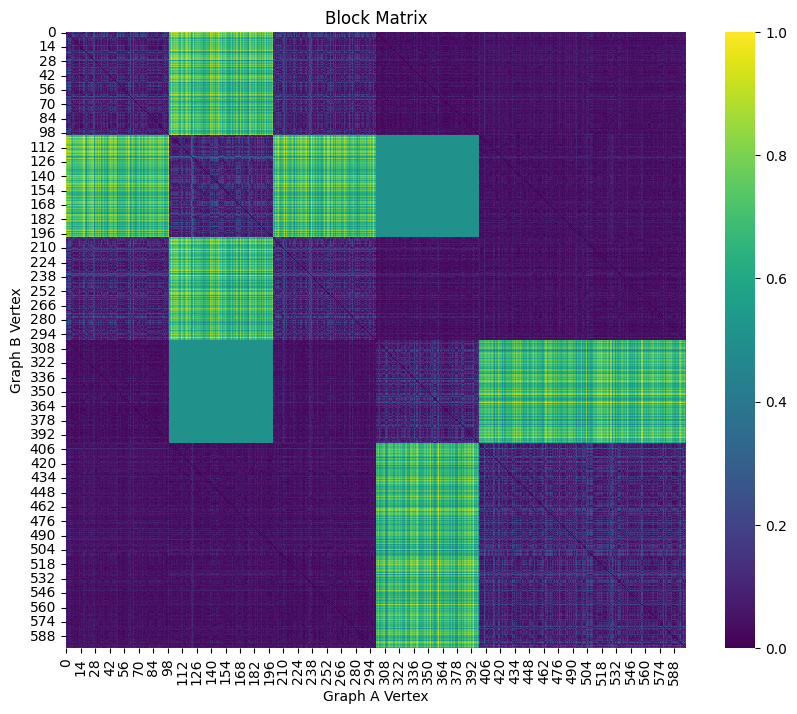

In [104]:
#Fit our model. Note, this takes our model 11 seconds, and nama at least 2 minutes (before I gave up)
multi_var_MP = MP(mv_data_A, mv_data_B, known_anchors= known_anchorsC, knn=5, decay = 40, operation = "average", kind="distance")

Note: Looking at the graph above, the values 200-300 and 500-600 is the values of the adjusted cluster. We would expect then on the cross diagonal for values 500-600 that intersect with 200-300 to be High, but they aren't. 

This is because these points remain close to each other, even though they are transposed. 

The only values that remain consistently far are cluster 1 and 2 (the ones that weren't transposed) because their distance remains constantly far

Ideas? Maybe we could fix this by adjusting how our average method works. We might be able to force it to use a certain anchor, which might give it the behavior we are looking for.

In [105]:
#multi_var_MP.veiw_graphs()

In [106]:
#Prep Nama, Mali, and DTA

#Nama takes a significatn time
namaC = NAMA(ot_reg = 0.001)
namaC.fit(known_anchorsC, mv_data_A, mv_data_B)


maliC = MALI()
maliC.fit((mv_data_A, mv_data_B), (mv_labels_A, mv_labels_B))


#DTA-Andres Prep
d_mv = DTA(knn=5,
             decay=40,
             knn_dist="euclidean",
             knn_max=None, 
             distances="DPT",
             #entR = 0.001,
             distance = 'cosine')

#The paper seems to like the labels in one hot encoding [0,1 0] style so it can calculate distance between them
oneHot_labels_A = np.eye(3)[mv_labels_A]
oneHot_labels_B = np.eye(3)[mv_labels_B]

#Shared D1 needs to be a subset of X.. and SharedD2 needs to be a subset of Y
c_sharedD1 = mv_data_A[rand_intsC]
c_sharedD2 = mv_data_B[rand_intsC]
c_labelsh1 = oneHot_labels_A[rand_intsC]
c_labelsh2 = oneHot_labels_B[rand_intsC]

#Fit the dta
d_mv.fit(mv_data_A, mv_data_B, sharedD1 = None, sharedD2 = None, 
            labels1 = oneHot_labels_A, labels2 = oneHot_labels_B, labelsh1 = None, labelsh2 = None) #If we remove the shared anchors we have to adjust the plotting function below, because it effects the graph size


/yunity/arusty/.local/lib/python3.10/site-packages/ot/bregman/_sinkhorn.py:531: UserWarning: Sinkhorn did not converge. You might want to increase the number of iterations `numItermax` or the regularization parameter `reg`.
  warnings.warn("Sinkhorn did not converge. You might want to "
ic| mali.py:174 in fit() at 08:25:07.814


optimal t:  26
optimal t:  30


/yunity/arusty/.local/lib/python3.10/site-packages/ot/bregman/_sinkhorn.py:531: UserWarning: Sinkhorn did not converge. You might want to increase the number of iterations `numItermax` or the regularization parameter `reg`.
  warnings.warn("Sinkhorn did not converge. You might want to "


array([[2.        , 0.        , 0.        , ..., 0.        , 0.41127645,
        2.        ],
       [0.        , 2.        , 0.        , ..., 2.        , 0.        ,
        0.        ],
       [0.        , 0.        , 2.        , ..., 0.        , 0.        ,
        0.        ],
       ...,
       [0.        , 2.        , 0.        , ..., 2.        , 0.        ,
        0.        ],
       [0.41127645, 0.        , 0.        , ..., 0.        , 2.        ,
        0.        ],
       [2.        , 0.        , 0.        , ..., 0.        , 0.        ,
        2.        ]])

Text(0.5, 1.0, 'Mali')

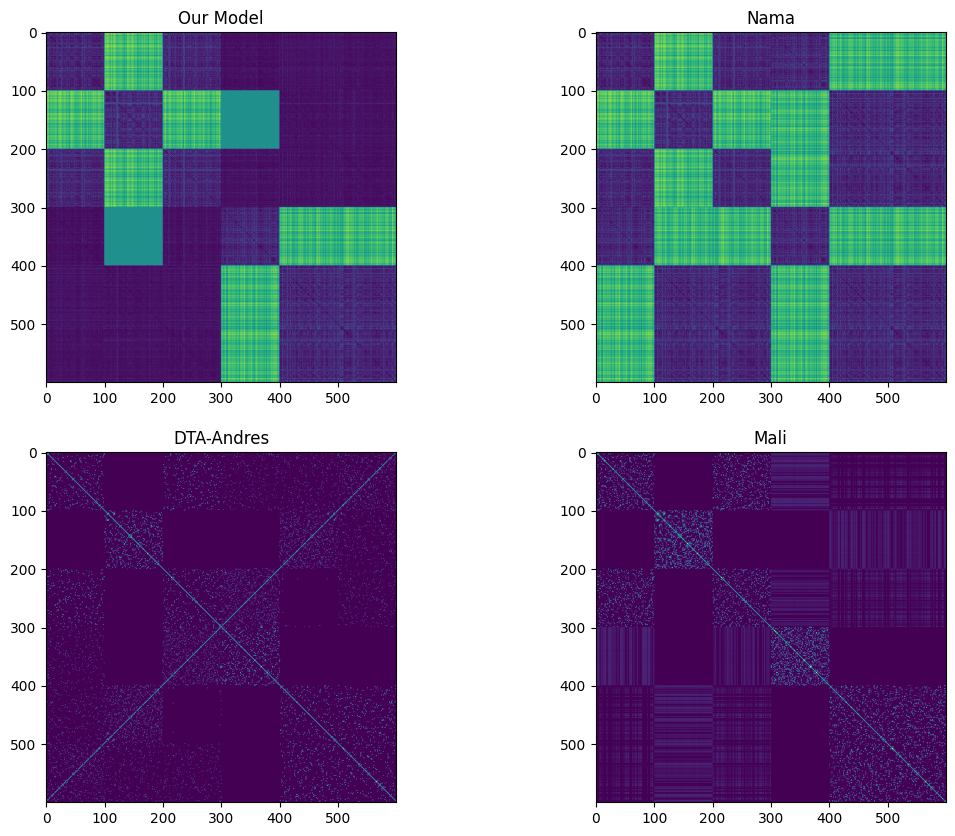

In [107]:
#Compare Heat maps
#Our model
fig, axes = plt.subplots(2, 2, figsize = (13, 10))
axes[0, 0].imshow(multi_var_MP.block)
axes[0,0].set_title("Our Model")

#DTA-Andres
axes[1, 0].imshow(d_mv.W)
axes[1,0].set_title("DTA-Andres")


axes[0,1].imshow(namaC.block)
axes[0,1].set_title("Nama")


#Mali
axes[1,1].imshow(maliC.W.toarray())
axes[1,1].set_title("Mali")

In [108]:
#Convert to embedding and print Our model stres
mds_mv = phateC.fit_transform(multi_var_MP.block) #Took 50 seconds, ran again with no change and took 2 min 30 seconds. Not sure why on the great variation.
#print(f"Our Model Stress: {mds.stress_}") 

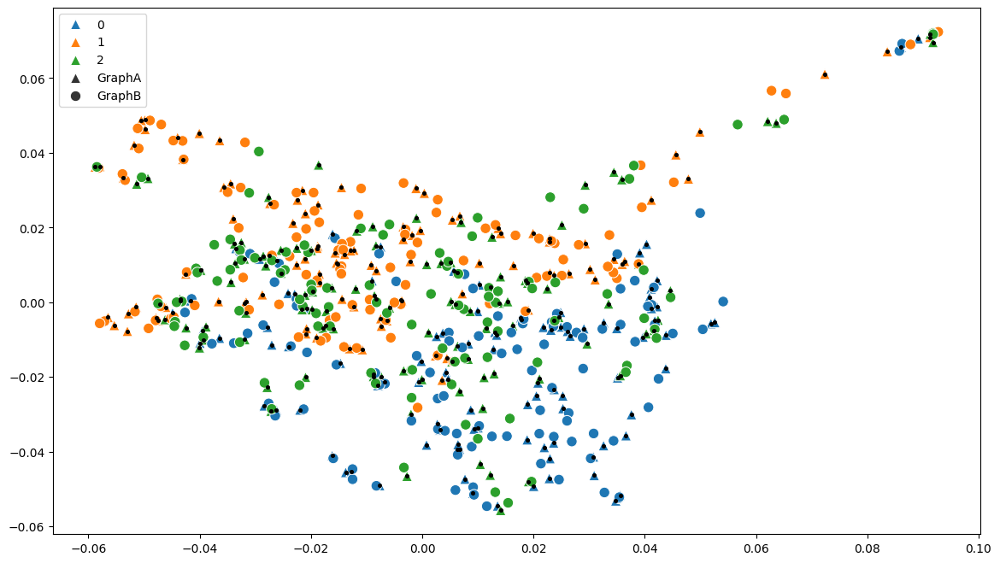

In [109]:
#Plot our model and see how it did! WOOT
stylesC = ['GraphA' if i < len(mds_mv) / 2 else 'GraphB' for i in range(len(mds_mv))]
combined_labels = np.concatenate([mv_labels_A, mv_labels_B])

plt.figure(figsize=(14, 8))
ax = sns.scatterplot(x = mds_mv[:, 0], y = mds_mv[:, 1], hue = pd.Categorical(combined_labels), style = stylesC, s=80, markers= {"GraphA": "^", "GraphB" : "o"})
ax.scatter(mds_mv[multi_var_MP.known_anchors_A, 0], mds_mv[multi_var_MP.known_anchors_A, 1], s = 7, color = 'black')

In [110]:
#Compare the other datasets
mds_namaC = phateC.fit_transform(namaC.block)
#print(f"Nama Stress: {mds.stress_}")

mds_maliC = mds.fit_transform(np.max(maliC.W.toarray())-maliC.W.toarray()) #Took over 3 minutes... so proceeded to give up
print(f"Mali Stress: {mds.stress_}")


Mali Stress: 6649.847955801505


In [111]:
#Note: On this one it is normalized to two; It may be more correct to do (d_iris.W).max() - d_iris.W then -> but 1-d_iris.W has a better result 
mds_dta_mv = phateC.fit_transform(d_mv.W) #There is also a W2, which seems to make it a little sparser
#print(f"DTA-Andres Stress: {mds.stress_}")


Text(0.5, 1.0, 'DTA')

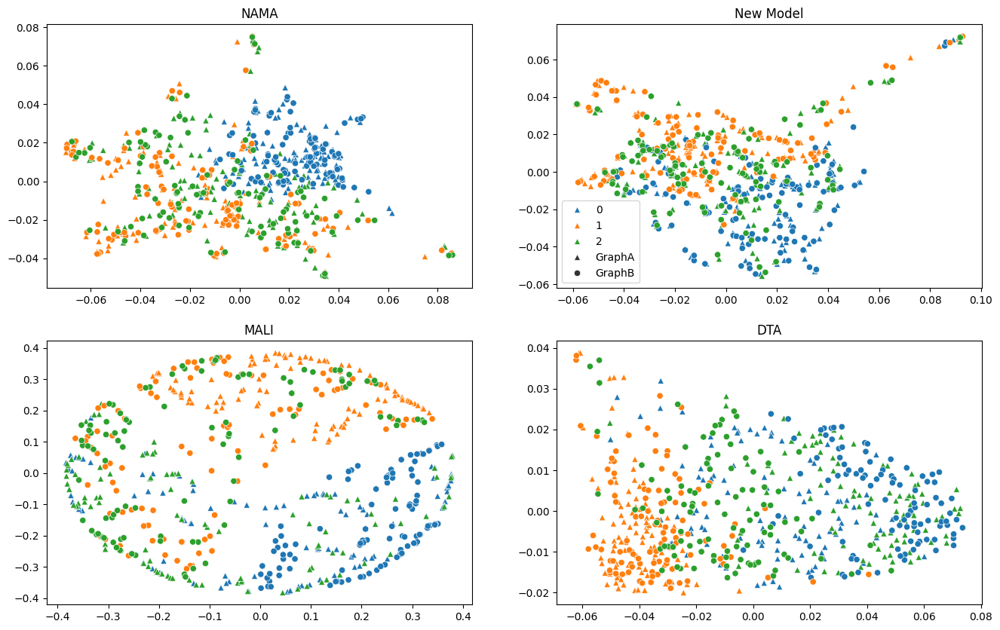

In [112]:
#Plot everything now
fig, axes = plt.subplots(2, 2, figsize = (16, 10))
stylesC = ['GraphA' if i < len(mds_mv) / 2 else 'GraphB' for i in range(len(mds_mv))]
combined_labels = np.concatenate([mv_labels_A, mv_labels_B])

sns.scatterplot(legend = False, x = mds_namaC[:, 0], y = mds_namaC[:, 1], hue = pd.Categorical(combined_labels), ax = axes[0,0], style = stylesC, markers= {"GraphA": "^", "GraphB" : "o"})
axes[0,0].set_title("NAMA")
sns.scatterplot(legend = False, x = mds_maliC[:, 0], y = mds_maliC[:, 1], hue = pd.Categorical(combined_labels), ax = axes[1,0], style = stylesC, markers= {"GraphA": "^", "GraphB" : "o"})
axes[1,0].set_title("MALI")
sns.scatterplot(x = mds_mv[:, 0], y = mds_mv[:, 1], hue = pd.Categorical(combined_labels), ax = axes[0,1], style = stylesC, markers= {"GraphA": "^", "GraphB" : "o"})
axes[0,1].set_title("New Model")

#Dta

#Note, we have to create a new styles because the random anchors add to its size
styles_dtaC = ['GraphA' if i < len(mds_dta_mv[:]) / 2 else 'GraphB' for i in range(len(mds_dta_mv[:]))]

#We got to set the labels for the extened graph
labels1_dtaC = np.concatenate((mv_labels_A, mv_labels_A[rand_intsC]))
labels2_dtaC = np.concatenate((mv_labels_B, mv_labels_A[rand_intsC]))
con_labels_dtaC = np.concatenate((labels1_dtaC, labels2_dtaC))

sns.scatterplot(legend = False, hue = pd.Categorical(combined_labels), x = mds_dta_mv[:, 0], y = mds_dta_mv[:, 1], ax = axes[1,1], style = styles_dtaC, markers= {"GraphA": "^", "GraphB" : "o"})
axes[1,1].set_title("DTA")

# 2nd Model. Early connectivity + Diffision

> Task List
1. Functionalize the entire process
    a. Apply the 20 datasets to it
    b. Write Files with the results
    c. Visualize the results
    D. Compare DTA, NAMA, SSMA, Shortest Graph Distance Model, and ECD

2. Work on comparing the predicted features to amputation 
    a. Compare it with RF-impute
    b. SKLEARN Mice (iterative Imputer)
    C. MAGIC (Find on Github)
    d. missforest 

3. Consider ways to solve the "Similarity Issue" (Note 3, on 4/3)

Potential Options for future
1. RF - GAP. Instead of using an alpha decay similarity matrix we will use Random Forests Similarity Measurement

 -------------------------------------------------------------------------------------------------------

> Notes 3/23:
 1. Using the negative log doesn't seem to change much for the iris, but helps with the S-curve
 2. Our model is nearly perfect at untangling data points (given there is a 100% known anchors or correspondonce)
 3. All three hyperparameters seem to make a huge differance.
    (A) As Anchors go up, the embedding is much better (to almost perfect)
    (B) There seems to be a sweet spot for t. Somewhere between 3-30
    (C) Knn has a high effect, though its different for data types. Mnist likes a lower one, where as S curve would be higher

> Notes 3/30:
 1. The optimal T does a good job at finding a reasonable T value, although on the S curve a t value of ten is about 5% better on CE metrics (both do nearly perfect with FOSCTTM)


> Notes 4/3:
1. On the projection embeddings, we can use the actual data and have mds compute it rather than having it precomputed
2. Based on our models, when we combine the split data sets the combination usually is an average off the two. Sometimes, its better than both of them, or can be worse
3. With split features, we are assuming that instances within the same class are similar to one another. Yet, when we divide a set by its features, this may cause those similarities to be lost, and so in each graph we might have a "wrong sense" of similarities, or instances that are similar to each other don't belong to the same class. This may be due to the fact that its a combination of features that explain the class similarity (if there even existed such in the first place) rather than just a subset of those features independently. How do we overcome this??

> Notes 4/11
1. Using Page ranking helps both the FOSCTTM and CE (making the FOSCTTM often 0, and increases the CE by like 0.05). It does the best with just the off-diagonal, but the full thing also helps. 

> Notes 4/22 -- Concerning missing features values between important dataset and non-important set
1. We can predict fairly confidently the values of the missing labels (assuming the other dataset has complete labels, and there is a decent covariance between the features in each domain)
2. Because all of the process is done unsupervised, it doesn't seem to matter that much of the features are missing
 -------------------------------------------------------------------------------------------------------

> Questions: 
1. I am thinking it would be great to create some table of all the results of each of the following parameters tested against each dataset
    - No Page Rank, vs Full Page Rank, vs Off-diagonal Page Rank
    - Optimal T values, vs t value of 3, 5, 10, 15, 25, 35
    - Testing predicted values for the knn classifier tests


## Create our Class

In [113]:
class ECD:
    def __init__(self, dataA, dataB, known_anchors, t = -1, knn = 5, link = "None"):
        """Graph A is the first graph. Graph B is the second one. 
        
        Known Anchors should be in an array shape (n, 2), where n is the number of
        corresponding points and 2 is the node in graph A and graph B
        
        t is the power to which we want to raise our diffusion matrix. If set to negative 1, it will find the best t"""
        #Scale data
        self.dataA = self.normalize_0_to_1(dataA)
        self.dataB = self.normalize_0_to_1(dataB)

        #Create graphs with graphtools
        self.graph_a = graphtools.Graph(self.dataA, knn = knn, knn_max = knn, decay = 40) #The Knn max stops additional connections
        self.graph_b  = graphtools.Graph(self.dataB, knn = knn, knn_max = knn, decay = 40)

        #Normalize the graphs
        self.kernalsA  = np.array(self.graph_a.K.toarray())
        self.kernalsB = np.array(self.graph_b.K.toarray())

        self.known_anchors = known_anchors

        #Connect the graphs
        self.graphAB = self.merge_graphs()
        
        #Get Similarity matrix and distance matricies
        self.similarity_matrix = self.get_pure_matricies(self.graphAB)

        #Get Diffusion Matrix
        self.sim_diffusion_matrix, self.projectionAB, self.projectionBA = self.get_diffusion(self.similarity_matrix, t, link = link)

        #Try doing diffusion the empy block way
        self.empty_block = self.get_zeros_and_ones_block()
        self.empty_diffused, __, __ = self.get_diffusion(self.empty_block, t, link = link) #NOTE: We currently do not store these projections

    def normalize_0_to_1(self, value):
        return (value - value.min()) / (value.max() - value.min())

    def apply_page_rank(self, matrix, alpha = 0.95):
        """
        Applies the PageRank modifications to the normalized matrix.

        Parameters:
        - matrix: The row-normalized adjacency matrix.
        - Alpha: the alpha value.

        Returns:
        - The modified matrix incorporating the damping factor and teleportation.
        """
        #Get the shape
        N, M = matrix.shape

        # Apply the damping factor and add the teleportation matrix
        return alpha * matrix + (1 - alpha) * np.ones((N, M)) / N

    def get_zeros_and_ones_block(self):
        """This creates off-diagonal blocks with known anchor points set to 1, and all other values set to 0. It returns a block matrix"""
        #Fill with zeros
        off_diagonal_block = np.zeros(shape=(self.len_A, self.len_B))

        #Set the anchors to 1
        off_diagonal_block[self.known_anchors[:, 0], self.known_anchors[:, 1]] = 1

        #Create block matrix
        block = np.block([[self.normalize_0_to_1(self.kernalsA), off_diagonal_block],
                         [off_diagonal_block.T, self.normalize_0_to_1(self.kernalsB)]])

        return block
    
    def merge_graphs(self): #NOTE: This process takes a significantly longer with more KNN (O(N) complexity)
        """Creates a new graph from A and B using the known_anchors
        and by merging them together"""

        graphA = self.graph_a.to_igraph()
        graphB = self.graph_b.to_igraph()

        #This stores the length of graph A and B
        self.len_A = graphA.vcount()
        self.len_B = graphB.vcount()

        #Merge the two graphs together
        merged = graphA.disjoint_union(graphB) #Note: The distances between graphs may not be the same. It this is the case, would we want to scale the data first?

        #Change known_anchors to correspond between the new indexes
        self.known_anchors_adjusted = np.vstack([self.known_anchors.T[0], self.known_anchors.T[1] + self.len_A]).T


        """ This is old code below that has been made greatly faster. However, this may be a slightly more accurate version, as some of weights may be compromised (Though it seems to better)
        #Now conenct the anchors together. NOTE This method can be made faster by implementing get.eids and add_edges but is more complex
        for anchor in self.known_anchors_adjusted: #Note: Since we overloaded the others, we could just set the remaining ones to 0
            neighborsA = set(merged.neighbors(anchor[0], mode="all"))
            neighborsB = set(merged.neighbors(anchor[1], mode="all"))

            #Now add the edges and weights
            for neighbor in neighborsB:
                merged.add_edge(anchor[0], neighbor, weight = merged.es[merged.get_eid(anchor[1], neighbor)]['weight'])
            
            for neighbor in neighborsA:
                merged.add_edge(anchor[1], neighbor, weight = merged.es[merged.get_eid(anchor[0], neighbor)]['weight'])
            

            #Now add the edges between anchors
            merged.add_edge(anchor[0], anchor[1], weight = 1)

        """

        #Now conenct the anchors together.
        for anchor in self.known_anchors: 
            neighborsA = tuple(set(graphA.neighbors(anchor[0], mode="out"))) #Anchor 0 applies to the graph A
            neighborsB = tuple(set(graphB.neighbors(anchor[1], mode="out")))

            #We add the edges first to a list so we can bulk add them later... NOTE: Since we are taking the weights from the kernal and not the graph object, it may be slightly different. It looks worse when we test the Projections, but the FOSCTTM score seems to be higher
            weights_to_add = self.kernalsB[neighborsB, np.repeat(anchor[1], len(neighborsB))]
            weights_to_add = np.append(weights_to_add, self.kernalsA[neighborsA, np.repeat(anchor[0], len(neighborsA))])

            #Bulk add the Edges
            edges_to_add = list(zip(np.full_like(neighborsB, anchor[0]), np.array(neighborsB) + self.len_A)) + list(zip(np.full_like(neighborsA, anchor[1]) + self.len_A, neighborsA)) #The self.len_A is to get it to correlate with the point in the domain B
            merged.add_edges(edges_to_add)
            
            #Add the weights
            merged.es[-len(weights_to_add):]["weight"] = weights_to_add

        #Now add the edges between anchors
        merged.add_edges(list(zip(self.known_anchors_adjusted[:, 0], self.known_anchors_adjusted[:, 1])))
        merged.es[-len(self.known_anchors_adjusted):]["weight"] = np.repeat(1, len(self.known_anchors_adjusted))

        #Convert back to graphtools
        merged_graphtools = graphtools.api.from_igraph(merged)

        return merged_graphtools
    
    def get_pure_matricies(self, graph):
        """ Returns the similarity matrix"""

        matrix = graph.K.toarray()
        
        #Normalize the matrix
        matrix = self.normalize_0_to_1(matrix)

        return matrix
    
    def row_normalize_matrix(self, matrix):
        """This row normalizes the matrix """
        # Normalize the matrix so that each row sums to 1
        row_sums = matrix.sum(axis=1)
        return matrix / row_sums[:, np.newaxis]

    def get_diffusion(self, matrix, t = -1, link = "None"): 
        """Returns the diffision matrix from the given matrix, to t steps. If t is -1, it will auto find the best one

        Also returns the projection matricies (the first one is the top right, and the second one is the bottom left)
        """
        #Find best T value
        if t == -1:
            t = vne.find_optimal_t(matrix) #NOTE: Try checking the off diagonal with the entropy
            print(f"Using optimal t value of {t}")

        # Normalize the matrix
        normalized_matrix = self.row_normalize_matrix(matrix)

        #Create small conections between all values 
        if link == "full":
            print("Applying Page Ranking against the full matrix")
            normalized_matrix = self.apply_page_rank(normalized_matrix)
            normalized_matrix = self.row_normalize_matrix(normalized_matrix)
        elif link == "off-diagonal":
            #Get off-Diagonal blocks and apply the transformation
            print("Applying Rage Ranking against the off-diagonal parts of the matrix")
            normalized_matrix[:self.len_A, self.len_A:] = self.apply_page_rank(normalized_matrix[:self.len_A, self.len_A:]) #Top right
            normalized_matrix[self.len_A:, :self.len_A] = self.apply_page_rank(normalized_matrix[self.len_A:, :self.len_A]) #Bottom left
            normalized_matrix = self.row_normalize_matrix(normalized_matrix)
            

        #Raise the normalized matrix to the t power
        diffusion_matrix = np.linalg.matrix_power(normalized_matrix, t)

        #Prepare the Projection Matricies by normalizing each domain by itself
        domainBA = diffusion_matrix[:self.len_A, self.len_A:] #Bottom Left
        domainAB = diffusion_matrix[self.len_A:, :self.len_A] #Top right
        domainBA = self.row_normalize_matrix(domainBA)
        domainAB = self.row_normalize_matrix(domainAB)
        
        #Squareform it :)
        diffused = (squareform(pdist((-np.log(0.00001+diffusion_matrix))))) #We can drop the -log and the 0.00001, but we seem to like it
    

        return diffused, domainBA, domainAB

    def plot_graphs(self):
        fig, axes = plt.subplots(2, 3, figsize = (13, 9))
        axes[0, 0].imshow(self.kernalsA)
        axes[0,0].set_title("Graph A Similarities")

        #Graph B
        axes[1, 0].imshow(self.empty_block)
        axes[1,0].set_title("Empty Block")

        #Similarity matrix
        axes[0,1].imshow(self.similarity_matrix)
        axes[0,1].set_title("Similarity Matrix")


        #Distance matrix
        axes[1,2].imshow(self.projectionAB)
        axes[1,2].set_title("Projection AB")

        #Diffusion matrix
        axes[0,2].imshow(self.sim_diffusion_matrix)
        axes[0,2].set_title("Similarities Diffusion Matrix")

        #Distance diffusion matrix
        axes[1,1].imshow(self.empty_diffused)
        axes[1,1].set_title("Empty diffused")

        plt.show()

    def plot_emb(self, labels, block, n_comp = 2, show_lines = True, show_anchors = True, use_phate = False, **kwargs): 
        #Convert to a MDS
        if use_phate:
            phate = PHATE(metric=True, dissimilarity = 'precomputed', random_state = 42, n_components= n_comp)
            self.emb = phate.fit_transform(block)
        else:
            mds = MDS(metric=True, dissimilarity = 'precomputed', random_state = 42, n_components= n_comp)
            self.emb = mds.fit_transform(block) #Later we should implent this to just be the block

        #Stress is a value of how well the emd did. Lower the better.
        print(f"Model Stress: {mds.stress_}")

        #Print the evaluation metrics as well
        first_labels = labels[:self.len_A]
        second_labels = labels[self.len_A:]
        try: #Will fail if the domains shapes aren't equal
            print(f"ECD Cross Embedding: {cross_embedding_knn(self.emb, (first_labels, second_labels), knn_args = {'n_neighbors': 5})}")
        except:
            print("Can't calculate the Cross embedding")

        try:    
            print(f"ECD FOSCTTM: {FOSCTTM(block[self.len_A:, :self.len_A])}") #This gets the off-diagonal part
        except: #This will run if the domains are different shapes
            print("Can't compute FOSCTTM with different domain shapes.")

        #Veiw the manifold. Those shown as Triangles are from GX
        styles = ['graph 1' if i < self.len_A else 'graph 2' for i in range(len(self.emb[:]))]
        plt.figure(figsize=(14, 8))

        #Now plot the points
        ax = sns.scatterplot(x = self.emb[:, 0], y = self.emb[:, 1], style = styles, hue = pd.Categorical(labels), s=80, markers= {"graph 1": "^", "graph 2" : "o"}, **kwargs)

        #To plot line connections
        if show_lines:
            for i in range(self.len_B):
                ax.plot([self.emb[0 + i, 0], self.emb[self.len_A + i, 0]], [self.emb[0 + i, 1], self.emb[self.len_A + i, 1]], color = 'lightgrey', alpha = .5)

        #Put black dots on the Anchors
        if show_anchors:
            ax.scatter(self.emb[self.known_anchors, 0], self.emb[self.known_anchors, 1], s = 10, color = 'black', marker="s")
        
        #Show plot
        plt.show()

    def test_projection(self, labels, n_comp = 2, use_phate = False, use_original_data = False):
        """Plots the data in both Domain A and Domain B
        
        Matrix should be the union of the two graphs. """
        #Seperate domains from matrix
        domainA = self.similarity_matrix[:self.len_A, :self.len_A]
        domainB = self.similarity_matrix[self.len_A:, self.len_A:]

        #Create the Emb
        if use_phate:
            phate = PHATE(metric=True, dissimilarity = 'precomputed', random_state = 42, n_components= n_comp)
            embA = phate.fit_transform(domainA)
            embB = phate.fit_transform(domainB)
        else: #The first section is using similarities and the second is without it being precomputed
            if use_original_data:
                mds = MDS(metric=True, random_state = 42, n_components= n_comp) #Note, we could also compute this using the original data
                embA = mds.fit_transform(self.dataA)
                embB = mds.fit_transform(self.dataB)
            else:
                mds = MDS(metric=True, dissimilarity = 'precomputed', random_state = 42, n_components= n_comp) #Note, we could also compute this using the original data
                embA = mds.fit_transform(1 - domainA)
                embB = mds.fit_transform(1 - domainB)  



        #Multiply our embeddings across the projections
        projectedA = (embA[:, None, :] * self.projectionAB[:, :, None]).sum(axis=0)
        projectedB = (embB[:, None, :] * self.projectionBA[:, :, None]).sum(axis=0)

        #Add the projected points to each embedding
        embA = np.vstack((embA, projectedB)) #The domains may not be equal to the original
        embB = np.vstack((projectedA, embB))

        #Plot the two graphs
        fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15, 7))

        #Create custom styles for each graph
        styles = ['Domain A' if i < self.len_A else 'Domain B' for i in range(len(embA[:]))]
        labelsA = np.concatenate([labels[:self.len_A], labels[:self.len_A]])
        axes[0].set_title("Domain A")
        sns.scatterplot(x = embA[:, 0], y = embA[:, 1], style = styles, hue = pd.Categorical(labelsA), ax = axes[0], s=80, markers= {"Domain A": "^", "Domain B" : "o"})

        styles = ['Domain A' if i < self.len_B else 'Domain B' for i in range(len(embB[:]))]
        labelsB = np.concatenate([labels[self.len_A:], labels[self.len_A:]])
        axes[1].set_title("Domain B")
        sns.scatterplot(x = embB[:, 0], y = embB[:, 1], style = styles, hue = pd.Categorical(labelsB), ax = axes[1], s=80, markers= {"Domain A": "^", "Domain B" : "o"})

        #Show plot
        plt.show()

    def plot_t_grid(self, block, rate = 3):
        """Returns the best T value according to its FOSCTTM score"""
        fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(20, 16)) # Creates a grid of 2x5 for the subplots
        F_scores = np.array([])
        for i in range(0, 10):
            # Calculate the row and column index for the current subplot
            row = (i) // 5
            col = (i) % 5
            
            # Perform the diffusion operation
            a = i * rate
            diffused_array, projectionAB, projectionBA = self.get_diffusion(block, a)

            #Add Foscttm score
            F_scores = np.append(F_scores, FOSCTTM(diffused_array))
            
            # Plotting the diffused array
            ax = axes[row, col]
            if i == 0:
                ax.imshow(1-block)
            else:
                ax.imshow(diffused_array)
            ax.set_title(f'T value: {a}')
            ax.axis('off') # Hide the axes ticks

            #Plotting the associated Projections
            ax = axes[row+2, col]
            ax.imshow(projectionAB)
            ax.set_title(f'ProjectionAB: T value {a}')
            ax.axis('off')
            

        plt.tight_layout()

        print(f"The best T value is {(F_scores.argmin() +1) * rate} with a FOSCTTM of {(F_scores.min()):.4g}")
        
    def predict_feature(self, predict = "A"):
        """Embedding should be the embedding wanted.
        
        predict should be which graph you want to use. 'A' for graph A. 
        'B' to predict graph B features. 
        
        Note: This should only be used if the data do not all share the same features."""
        #TODO: Add code that can predict all the missing features or just the ones specified. This will help in the case where maybe not all of the values are missing
        #NOTE: This function currently only changes numerical values in the positive direction. However, in reality some may need to be cast in a negative way, or even somewhere inbetween

        if predict == "A":
            known_features = self.dataA
            projection_matrix = self.projectionBA #Bottom Left
        elif predict == "B":
            known_features = self.dataB
            projection_matrix = self.projectionAB #Top Right
        else:
            print("Please specify which features you want to predict. Graph 'A' or Graph 'B'")
            return None
        
        
        predicted_features = (projection_matrix[:, :, np.newaxis] * known_features[np.newaxis, :, :]).sum(axis = 1)
        
        return predicted_features
    
    def get_merged_data_set(self):
        """Adds the predicted features to the datasets with the missing features. 
        Returns a combined dataset that includes the predicted features"""

        #Add the predicted features to each data set
        full_data_A = np.hstack([self.predict_feature(predict = 'A'), self.dataB])
        full_data_B = np.hstack([self.dataA, self.predict_feature(predict = 'B')])

        #Combine the datasets
        completeData = np.vstack([full_data_A, full_data_B])

        return completeData



## Testing the code on Iris Data
1. The optimal t does well
2. Knn = 4 does well. However, as we increase the knn, the CE goes up for the non-empty (to about 15) and goes down with the empty. 
3. With only 3 anchors (0r 2 percent) it does great

- Applying Page Rank seems to increase the metrics (slightly) but the graph points look actually farther away from each other. 

In [114]:
dummyArray = np.array([[1,1], [76, 76], [28,28], [52, 52], [96,96], [48, 48], [64,64], [18, 18], [36, 36]])
test_ECD = ECD(X, Y, dummyArray, t = -1, knn = 10, link = "None")

Using optimal t value of 18
Using optimal t value of 10


The best T value is 1 with a FOSCTTM of 0


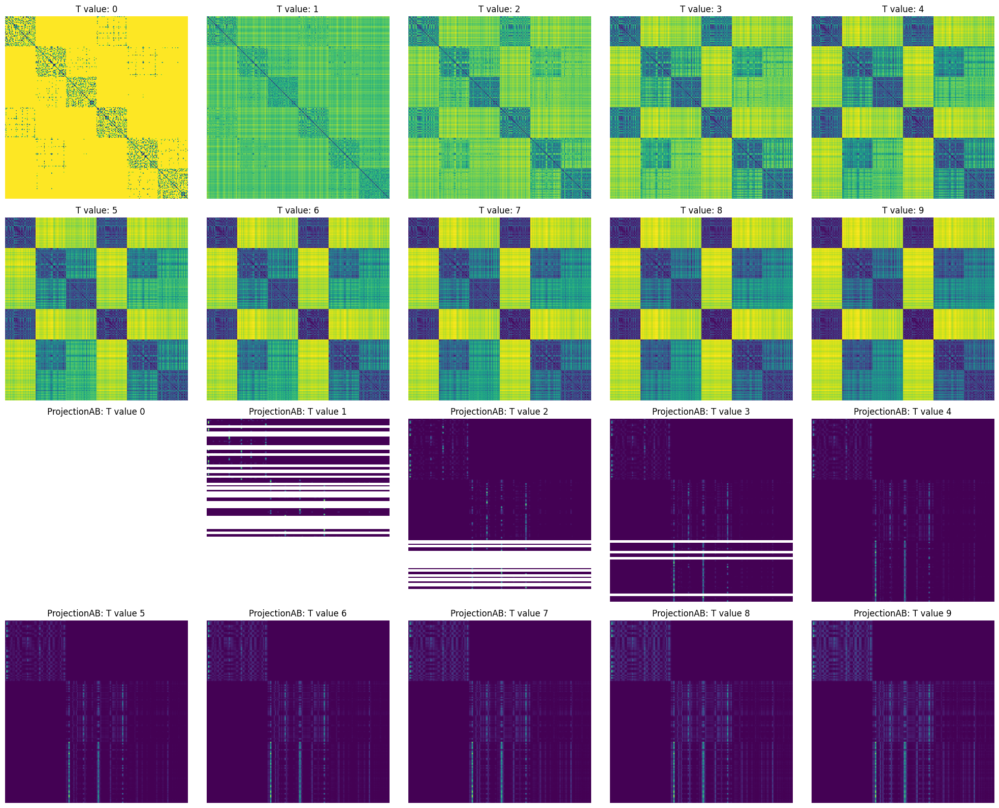

In [115]:
test_ECD.plot_t_grid(test_ECD.similarity_matrix, rate = 1)

In [122]:
test_ECD2 = ECD(X, Y[:100], dummyArray, t = -1, knn = 10, link = "full")
test_ECD3 = ECD(X, Y[:100], dummyArray, t = -1, knn = 10, link = "off-diagonal")

Using optimal t value of 17
Applying Page Ranking against the full matrix
Using optimal t value of 12
Applying Page Ranking against the full matrix
Using optimal t value of 17
Applying Rage Ranking against the off-diagonal parts of the matrix
Using optimal t value of 12
Applying Rage Ranking against the off-diagonal parts of the matrix


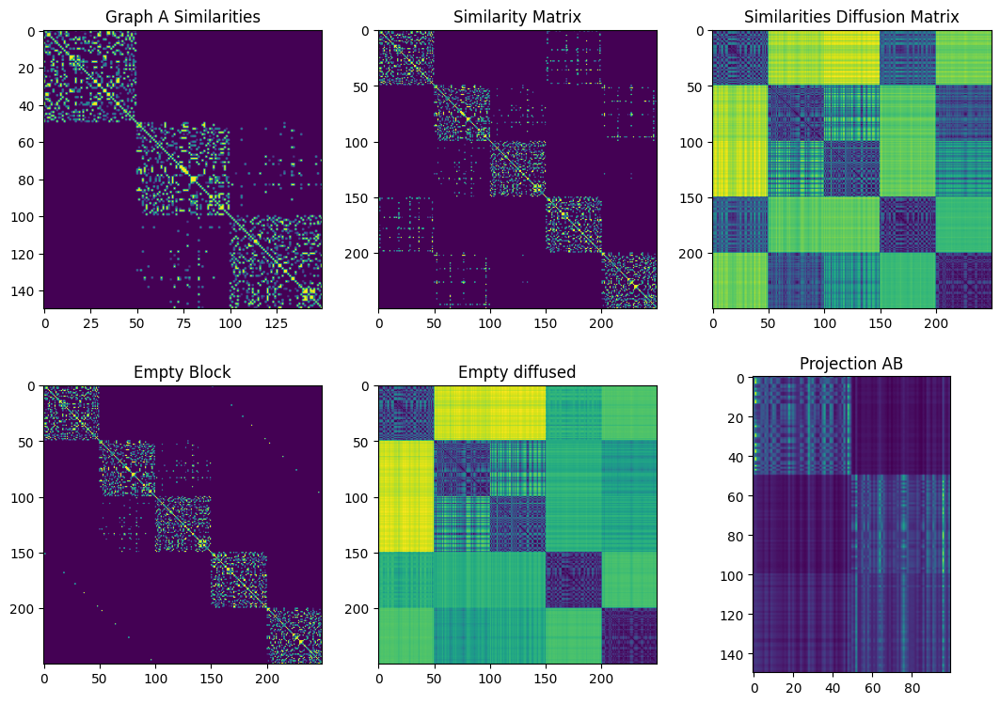

In [123]:
test_ECD3.plot_graphs()

No Page Rank applied
Model Stress: 653148.0586244094
ECD Cross Embedding: 0.6666666666666666
ECD FOSCTTM: 0.20639999999999994


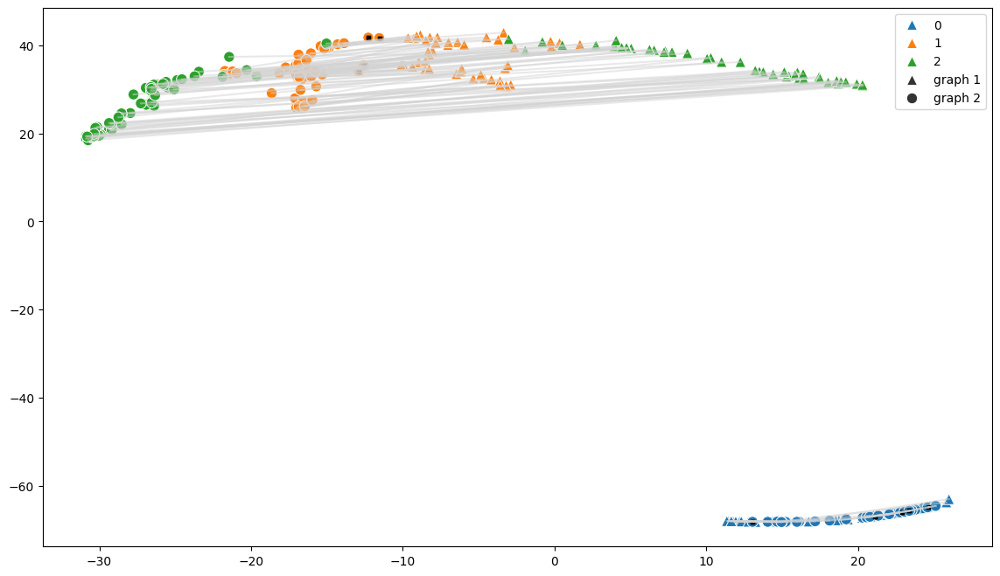

Full Page rank applied
Model Stress: 29504.850399527826
ECD Cross Embedding: 1.0
Can't compute FOSCTTM with different domain shapes.


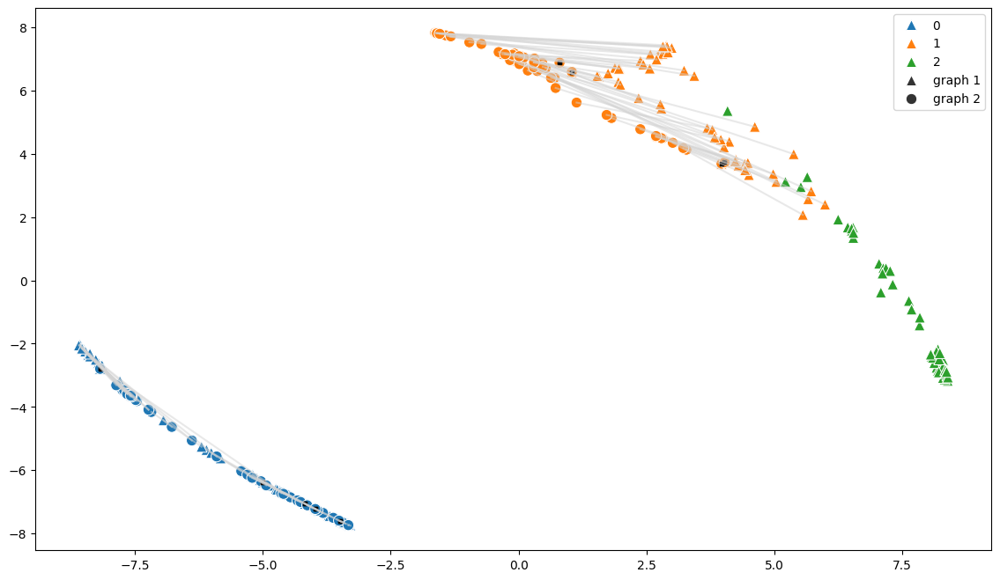

off-diagonal page rank applied
Model Stress: 25277.00433471775
ECD Cross Embedding: 1.0
Can't compute FOSCTTM with different domain shapes.


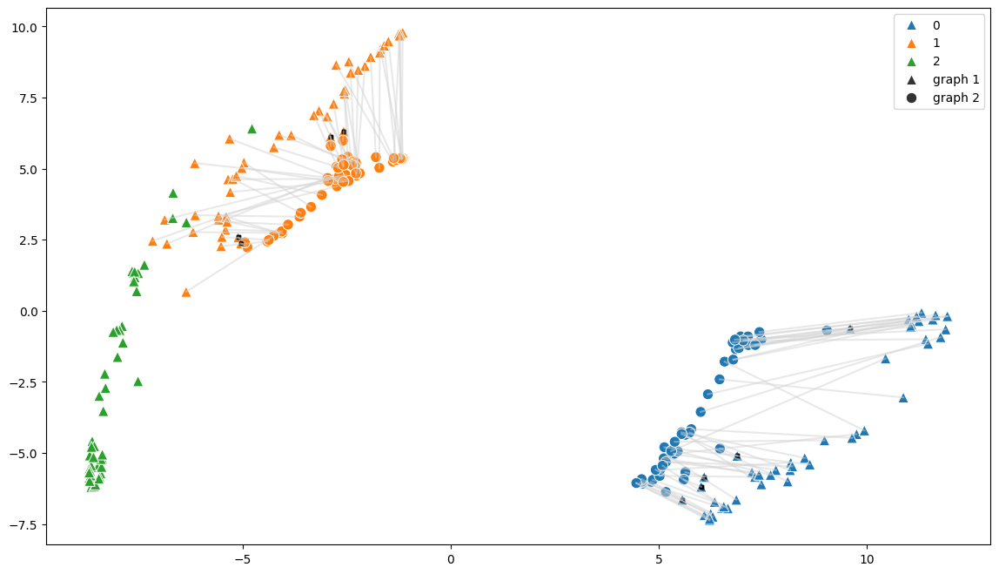

In [125]:
print("No Page Rank applied")
test_ECD.plot_emb(labels, test_ECD.sim_diffusion_matrix, use_phate = False)
print("Full Page rank applied")
test_ECD2.plot_emb(labels[:250], test_ECD2.sim_diffusion_matrix, use_phate = False)
print("off-diagonal page rank applied")
test_ECD3.plot_emb(labels[:250], test_ECD3.sim_diffusion_matrix, use_phate = False)

## S curve Data
1. Optimal KNN seems to be about 5
2. Auto t does well
3. Anchors needed is very low (Does great with 5%)

Page Rank Seems not Helpful for this (When alpha is set to 0.85)

In [126]:
scurve_ECD = ECD(SX, SY, s_known_anchors[:10], t = -1, knn = 5, link = "None")

Using optimal t value of 13
Using optimal t value of 53


In [127]:
scurve_ECD2 = ECD(SX, SY, s_known_anchors[:10], t = -1, knn = 5, link = "full")

Using optimal t value of 13
Applying Page Ranking against the full matrix
Using optimal t value of 53
Applying Page Ranking against the full matrix


In [128]:
scurve_ECD3 = ECD(SX, SY, s_known_anchors[:10], t = -1, knn = 5, link = "off-diagonal")

Using optimal t value of 13
Applying Rage Ranking against the off-diagonal parts of the matrix
Using optimal t value of 53
Applying Rage Ranking against the off-diagonal parts of the matrix


In [129]:
#scurve_ECD.plot_Igraph()

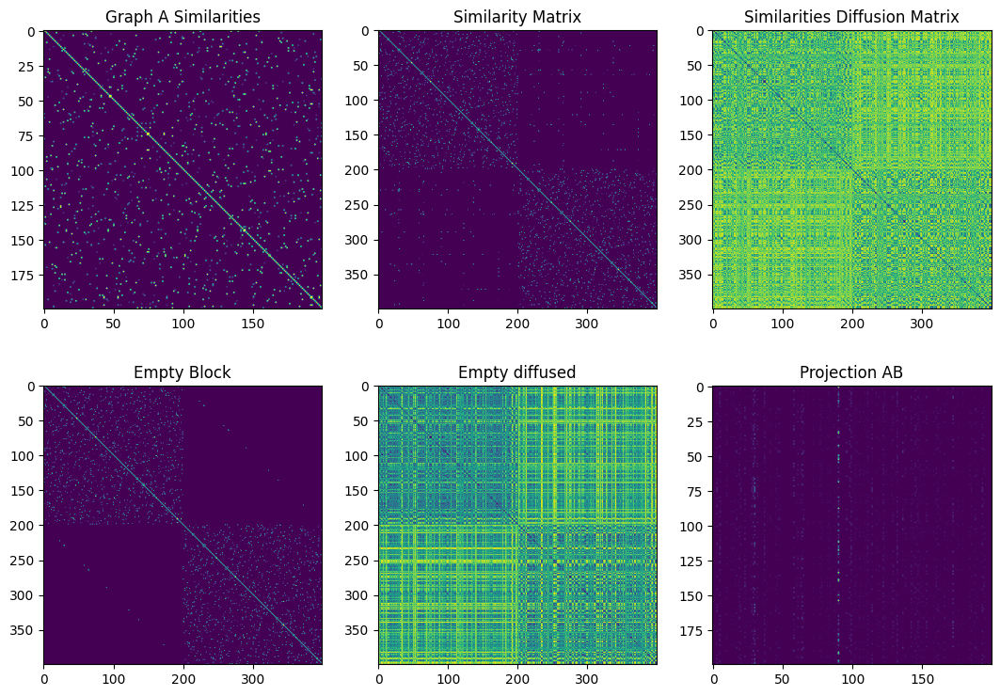

In [130]:
scurve_ECD.plot_graphs()

The No Page Rank graph


Model Stress: 20009757.350868244
ECD Cross Embedding: 0.925
ECD FOSCTTM: 0.095825


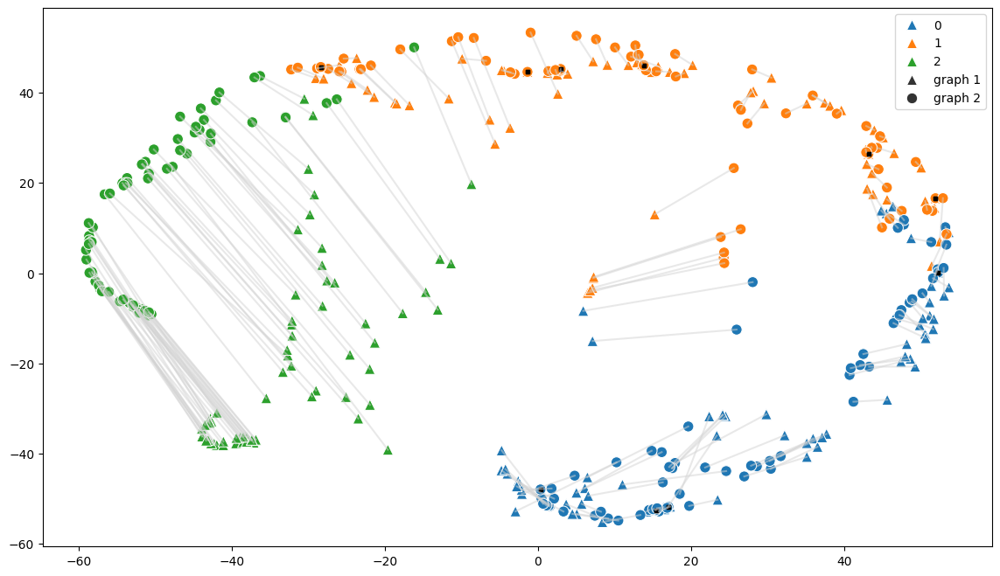

The Full Page Rank Graph
Model Stress: 2766206.2720318497
ECD Cross Embedding: 0.725
ECD FOSCTTM: 0.13925


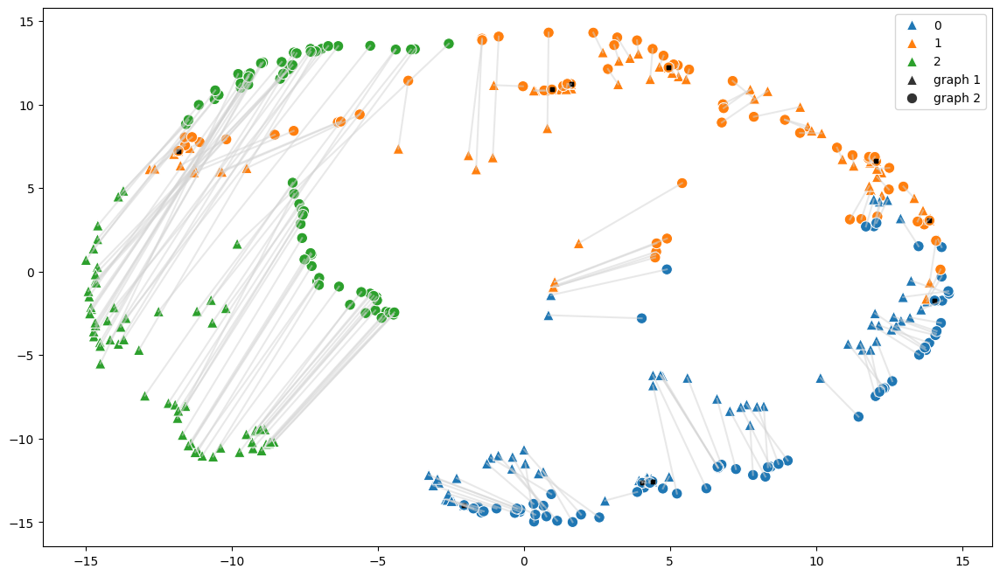

The Off-Diagonal Page Rank Graph
Model Stress: 3716421.599097689
ECD Cross Embedding: 0.84
ECD FOSCTTM: 0.17104999999999998


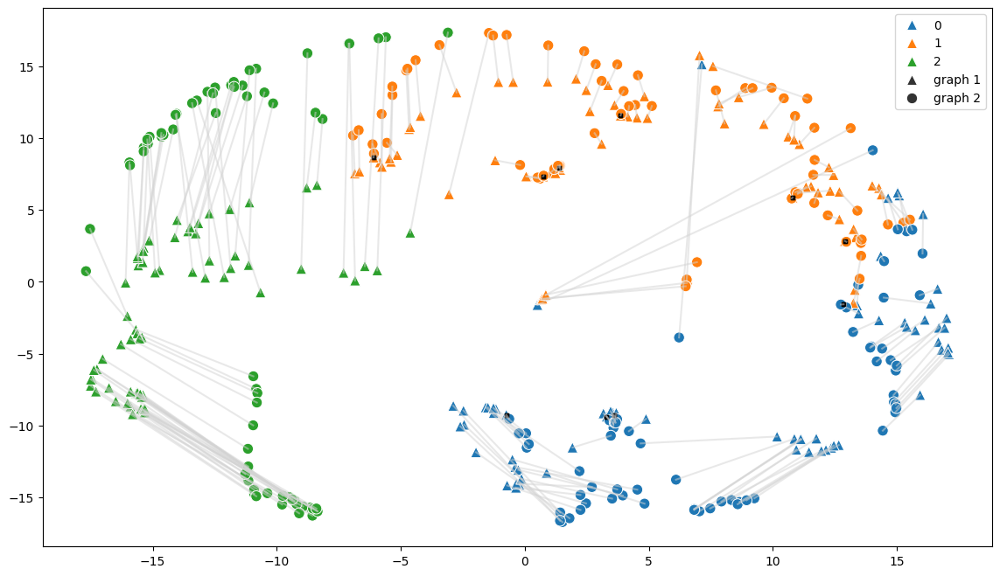

In [131]:
print("The No Page Rank graph")
scurve_ECD.plot_emb(Slabels, scurve_ECD.sim_diffusion_matrix)
print("The Full Page Rank Graph")
scurve_ECD2.plot_emb(Slabels, scurve_ECD2.sim_diffusion_matrix) 
print("The Off-Diagonal Page Rank Graph")
scurve_ECD3.plot_emb(Slabels, scurve_ECD3.sim_diffusion_matrix)

Model Stress: 51680.46387362016
ECD Cross Embedding: 0.625
ECD FOSCTTM: 0.310725


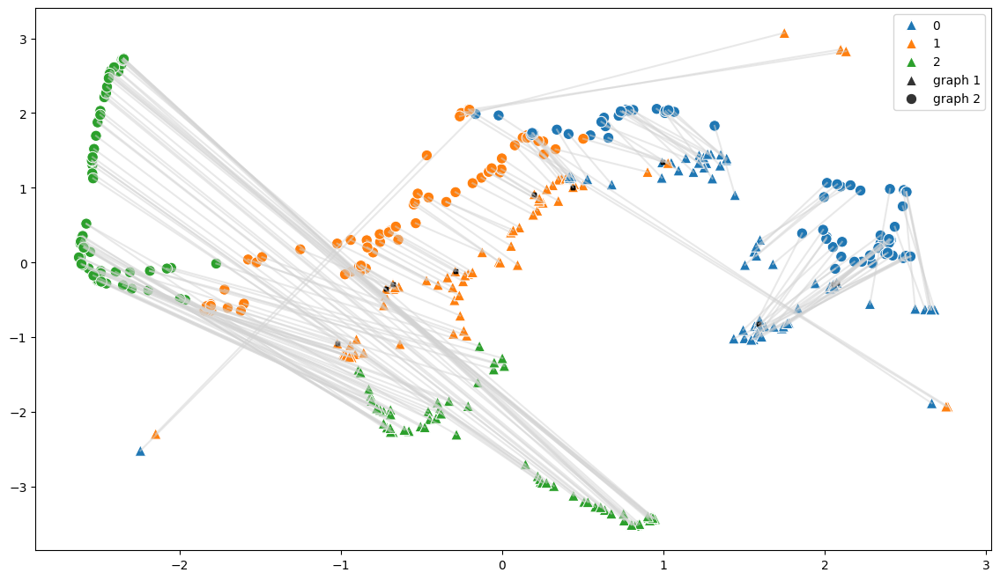

In [132]:
scurve_ECD.plot_emb(Slabels, scurve_ECD2.empty_diffused)

## M Nist Data

Note: These anchors are not actually representing the same point. Instead, these anchors are simply saying that a 6 connects to a 6, and so its almost like labels

1. -1 on t seems to do ok, though around 30 value for t seems a little better
2. KNN of 2 seems to be best. (This is because the graphtools seems to have a hard time distinguishing numbers as distances)
3. Around 20% known correspondences seems to be the sweet spot, which is a little higher

It seems like the off-diagonal linking helps this data

In [133]:
mnist_ECD = ECD(o1, o2, known_anchorsM[:40], t = -1, knn=4, link = "None")

/yunity/arusty/.local/lib/python3.10/site-packages/graphtools/graphs.py:122: UserWarning: Building a kNNGraph on data of shape (200, 784) is expensive. Consider setting n_pca.
  warnings.warn(
/yunity/arusty/.local/lib/python3.10/site-packages/graphtools/graphs.py:122: UserWarning: Building a kNNGraph on data of shape (200, 784) is expensive. Consider setting n_pca.
  warnings.warn(


Using optimal t value of 21
Using optimal t value of 30


In [134]:
mnist_ECD2 = ECD(o1, o2, known_anchorsM[:40], t = -1, knn=4, link = "full")

/yunity/arusty/.local/lib/python3.10/site-packages/graphtools/graphs.py:122: UserWarning: Building a kNNGraph on data of shape (200, 784) is expensive. Consider setting n_pca.
  warnings.warn(
/yunity/arusty/.local/lib/python3.10/site-packages/graphtools/graphs.py:122: UserWarning: Building a kNNGraph on data of shape (200, 784) is expensive. Consider setting n_pca.
  warnings.warn(


Using optimal t value of 21
Applying Page Ranking against the full matrix
Using optimal t value of 30
Applying Page Ranking against the full matrix


In [135]:
mnist_ECD3 = ECD(o1, o2, known_anchorsM[:40], t = -1, knn=4, link = "off-diagonal")

/yunity/arusty/.local/lib/python3.10/site-packages/graphtools/graphs.py:122: UserWarning: Building a kNNGraph on data of shape (200, 784) is expensive. Consider setting n_pca.
  warnings.warn(
/yunity/arusty/.local/lib/python3.10/site-packages/graphtools/graphs.py:122: UserWarning: Building a kNNGraph on data of shape (200, 784) is expensive. Consider setting n_pca.
  warnings.warn(


Using optimal t value of 21
Applying Rage Ranking against the off-diagonal parts of the matrix
Using optimal t value of 30
Applying Rage Ranking against the off-diagonal parts of the matrix


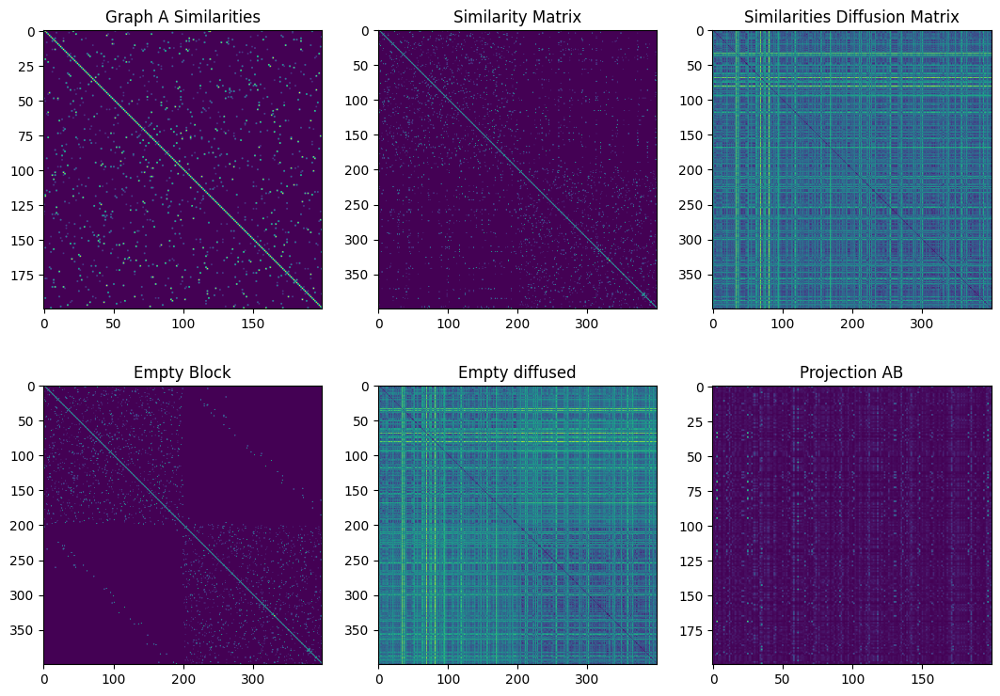

In [136]:
mnist_ECD.plot_graphs() #Note on here the empty graph isn't a straight line because points only coordinate to another, and aren't exactly the same point

In [137]:
#mnist_ECD.plot_Igraph() 

The No Page Rank graph
Model Stress: 2888.4885880102192
ECD Cross Embedding: 0.625
ECD FOSCTTM: 0.4956249999999999


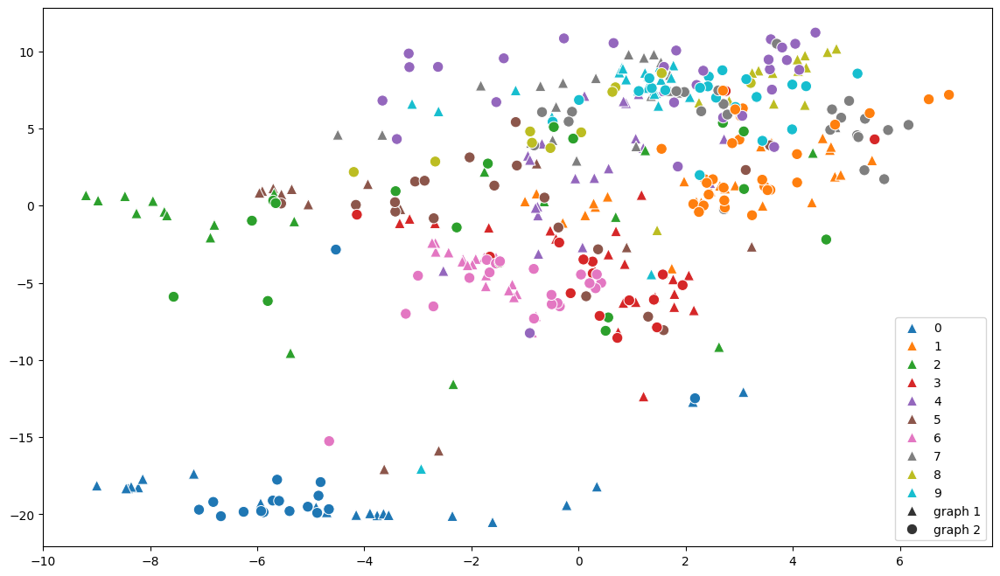

The FULL Page Rank graph
Model Stress: 763.100938869081
ECD Cross Embedding: 0.6
ECD FOSCTTM: 0.50865


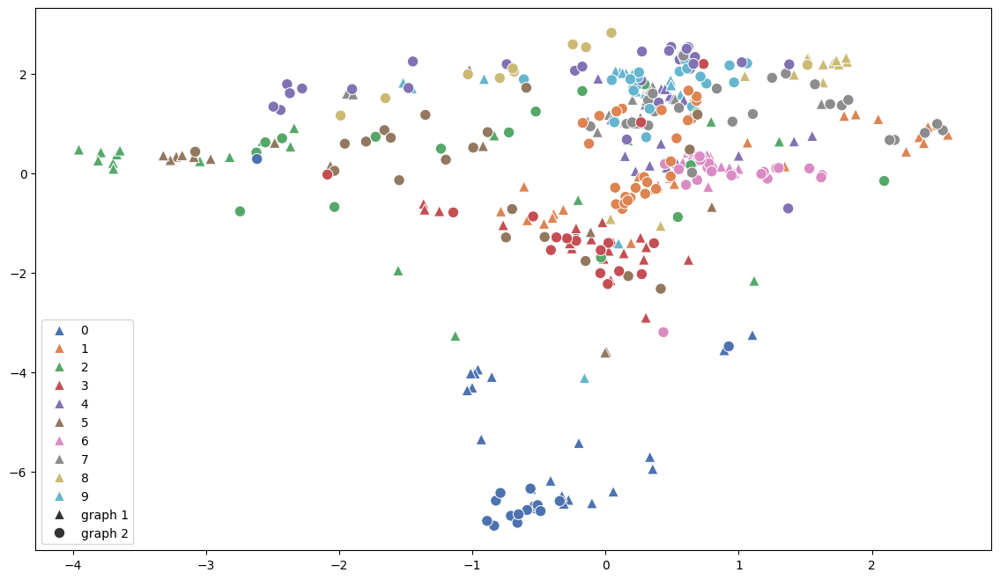

The Off-diagonal Page Rank graph
Model Stress: 814.667683418655
ECD Cross Embedding: 0.61
ECD FOSCTTM: 0.5085500000000001


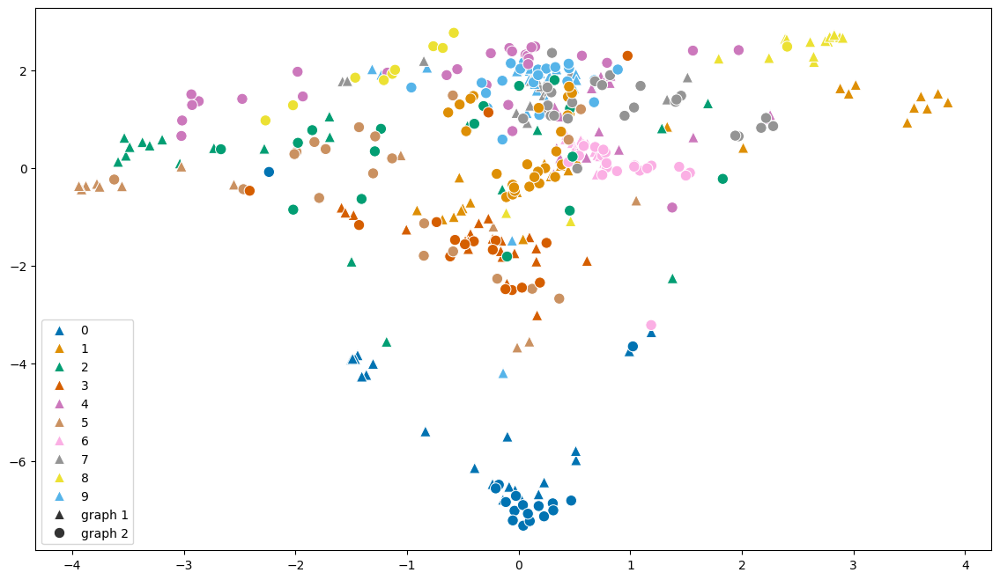

In [138]:
print("The No Page Rank graph")
mnist_ECD.plot_emb(labelsM, mnist_ECD.sim_diffusion_matrix, n_comp = 10, use_phate = False, show_lines=False, show_anchors = False)
print("The FULL Page Rank graph")
mnist_ECD2.plot_emb(labelsM, mnist_ECD2.sim_diffusion_matrix, n_comp = 10, use_phate = False, show_lines=False, show_anchors = False, palette= "deep")
print("The Off-diagonal Page Rank graph")
mnist_ECD3.plot_emb(labelsM, mnist_ECD3.sim_diffusion_matrix, n_comp = 10, use_phate = False, show_lines=False, show_anchors = False, palette= "colorblind")

Model Stress: 4680.279063034211
ECD Cross Embedding: 0.585
ECD FOSCTTM: 0.496775


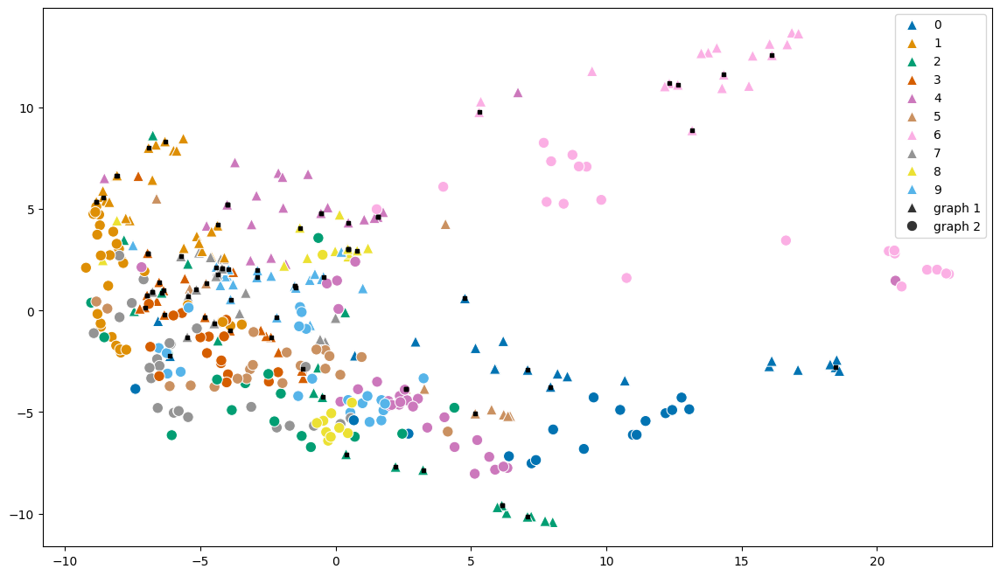

In [139]:
mnist_ECD.plot_emb(labelsM, mnist_ECD.empty_diffused, n_comp = 9, show_lines=False, show_anchors=True, palette= "colorblind")

## Covariate Data
1. A Higher knn (around 18 seems to do great)
2. -1 for t does good enough
3. Around 50% known correspondences give a decent split

Note: Using the old code for knn extra connections it took 9.3 minutes, and the new code took 2.4 seconds.

In [140]:
cov_ECD = ECD(mv_data_A, mv_data_B, known_anchorsC[:250], t = -1, knn=15, link = "off-diagonal") #Note, a higher KNN does make the sim matrix preform better but significantly takes more time
combined_labels = np.concatenate([mv_labels_A, mv_labels_B])

Using optimal t value of 10
Applying Rage Ranking against the off-diagonal parts of the matrix
Using optimal t value of 33
Applying Rage Ranking against the off-diagonal parts of the matrix


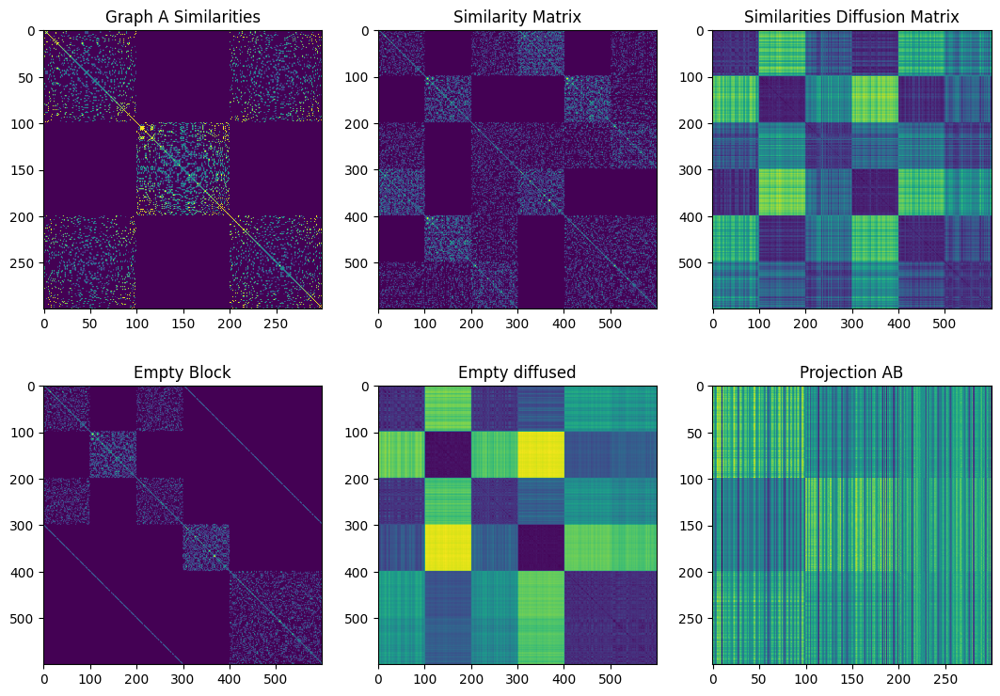

In [141]:
cov_ECD.plot_graphs()

In [142]:
#cov_ECD.plot_t_grid(cov_ECD.similarity_matrix, rate = 2)

Model Stress: 3810.9778058937836
ECD Cross Embedding: 0.6933333333333334
ECD FOSCTTM: 0.3138333333333334


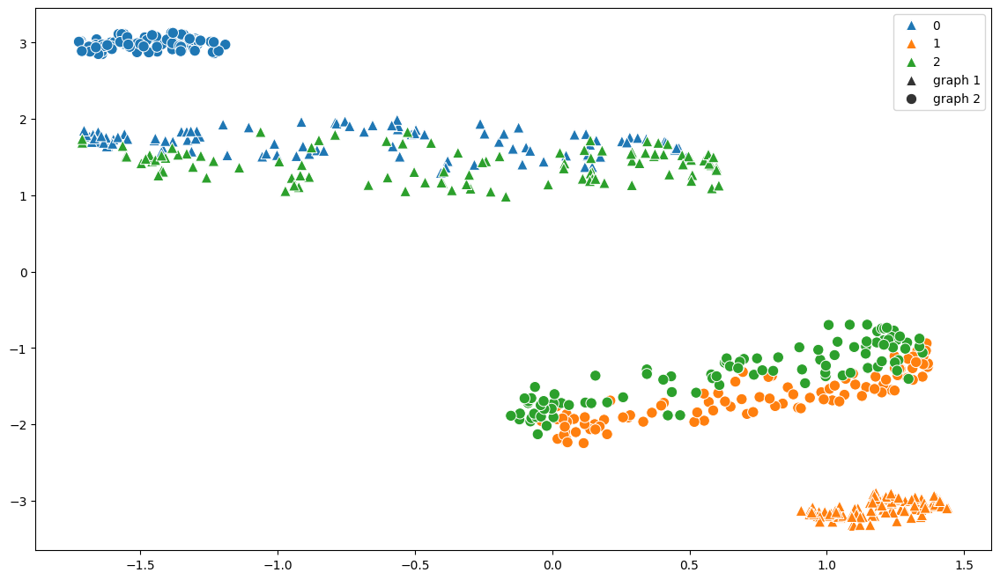

In [143]:
cov_ECD.plot_emb(combined_labels, cov_ECD.empty_diffused, use_phate = False, show_lines=False, show_anchors = False)

Model Stress: 1292.6814153494252
ECD Cross Embedding: 0.9233333333333333
ECD FOSCTTM: 0.13392222222222225


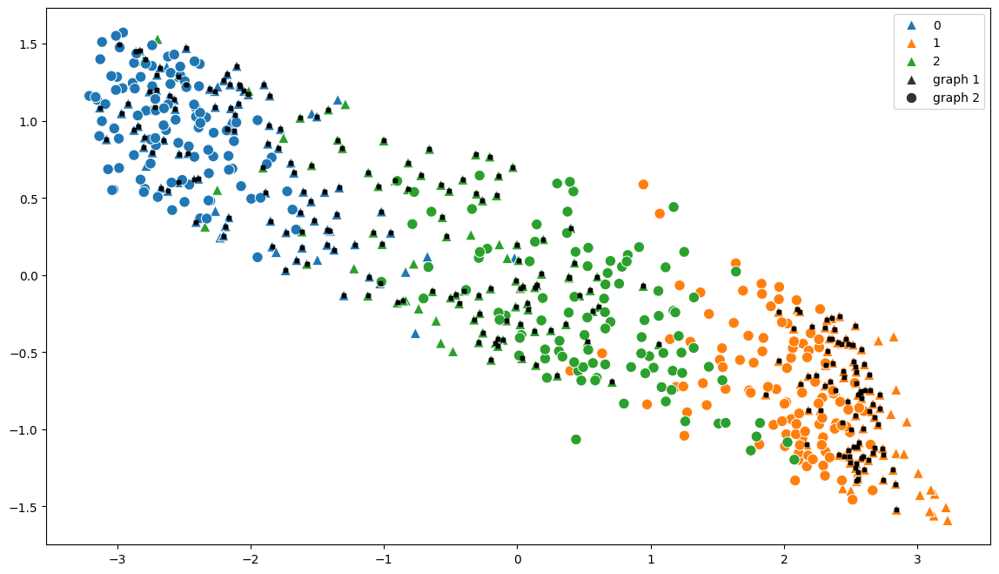

In [144]:
cov_ECD.plot_emb(combined_labels, cov_ECD.sim_diffusion_matrix, use_phate = False, show_lines=False, show_anchors=True)

## Wine Testing

This is showing how well the model can combine the same dataset represented by different features in each domain

Note, this probably doesn't preform well because elements with the same label as each other aren't actually more similar to each other than other points. (This is also reflected in some of the difficulty in MNIST data)

- Page ranking seems to help here
- The embedding itself does about the average of both of the splits, which is worse than the original data. However, the predicted features preforms significantly better, although it still notably worse than the unchanged (or split data)
- Both the Embedding and the predicted values preformed better on the NN test.

In [145]:
wine_ECD = ECD(wine_split_A, wine_split_B, wine_anchors[:50], t = -1, knn = 10, link = "off-diagonal")

Using optimal t value of 21
Applying Rage Ranking against the off-diagonal parts of the matrix
Using optimal t value of 29
Applying Rage Ranking against the off-diagonal parts of the matrix


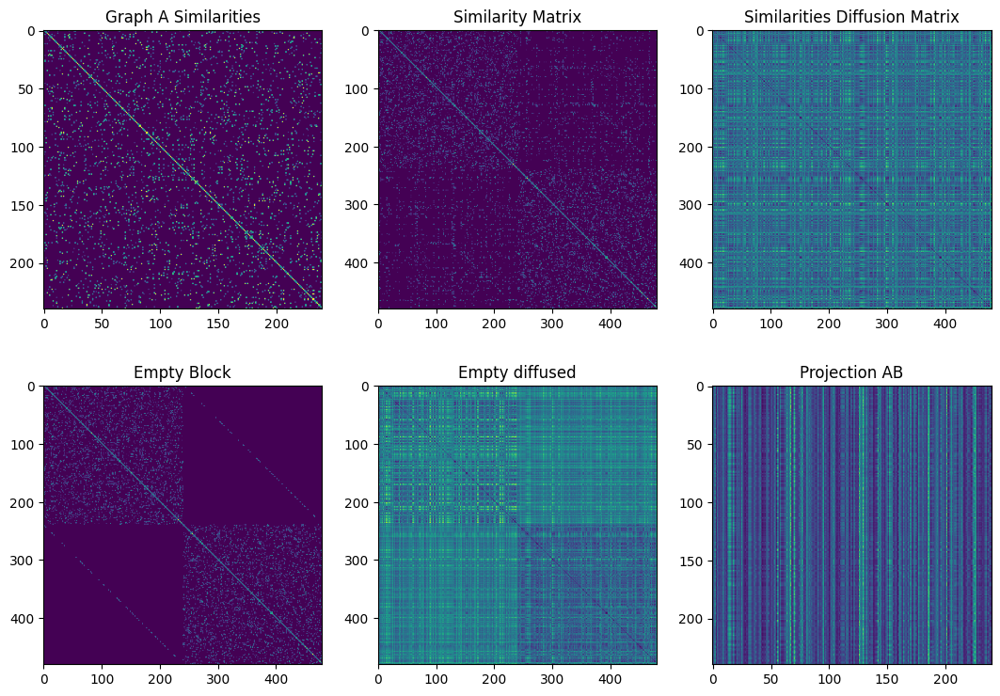

In [146]:
wine_ECD.plot_graphs()

Model Stress: 20734.15332172491
ECD Cross Embedding: 0.5375
ECD FOSCTTM: 0.26421875


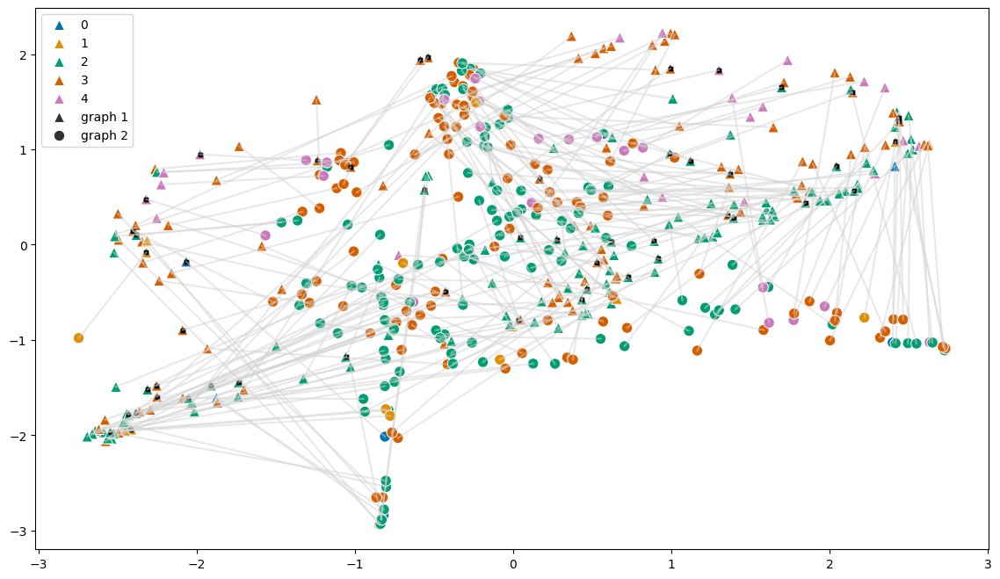

In [147]:
wine_ECD.plot_emb(wine_labels, wine_ECD.empty_diffused, n_comp = 2, show_lines = True, palette = "colorblind")

Model Stress: 65.1489724740422
ECD Cross Embedding: 0.5083333333333333
ECD FOSCTTM: 0.16727430555555553


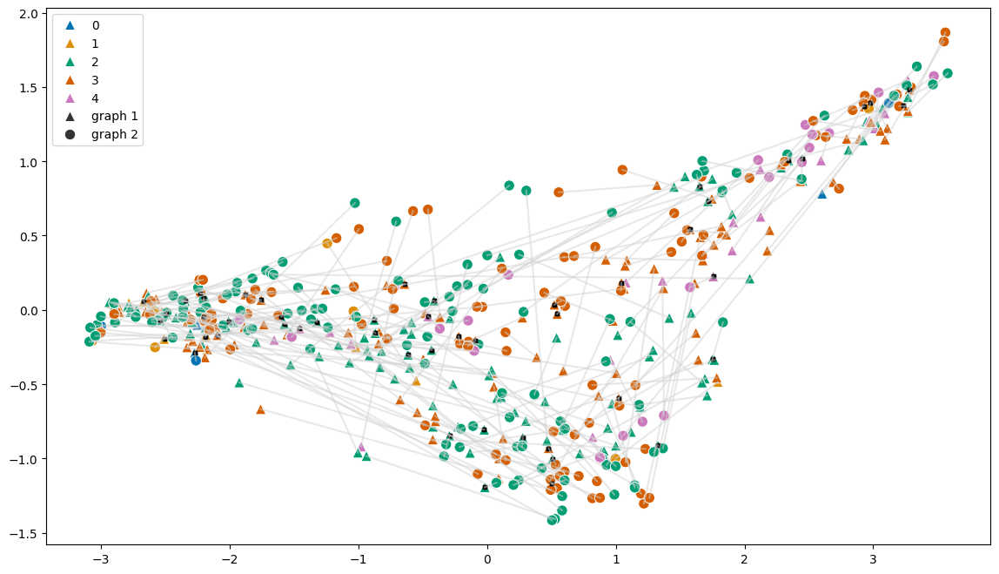

In [148]:
wine_ECD.plot_emb(wine_labels, wine_ECD.sim_diffusion_matrix, n_comp = 5, show_lines = True, palette = "colorblind")

Unchanged Data
Linear Regression R^2 score: 0.5972222222222222, and MSE score: 0.4444444444444444
KNN accuracy score: 0.6527777777777778
---------------------------------------------------
Split A
Linear Regression R^2 score: 0.5694444444444444, and MSE score: 0.5555555555555556
KNN accuracy score: 0.5694444444444444
---------------------------------------------------
Split B
Linear Regression R^2 score: 0.5138888888888888, and MSE score: 0.5277777777777778
KNN accuracy score: 0.5138888888888888
---------------------------------------------------
Embedding
Linear Regression R^2 score: 0.5416666666666666, and MSE score: 0.6041666666666666
KNN accuracy score: 0.5
---------------------------------------------------
Predicted Features
Linear Regression R^2 score: 0.5347222222222222, and MSE score: 0.5486111111111112
KNN accuracy score: 0.5347222222222222
---------------------------------------------------
The dropped labels test
Linear Regression R^2 score: 0.5520833333333334, and MSE scor

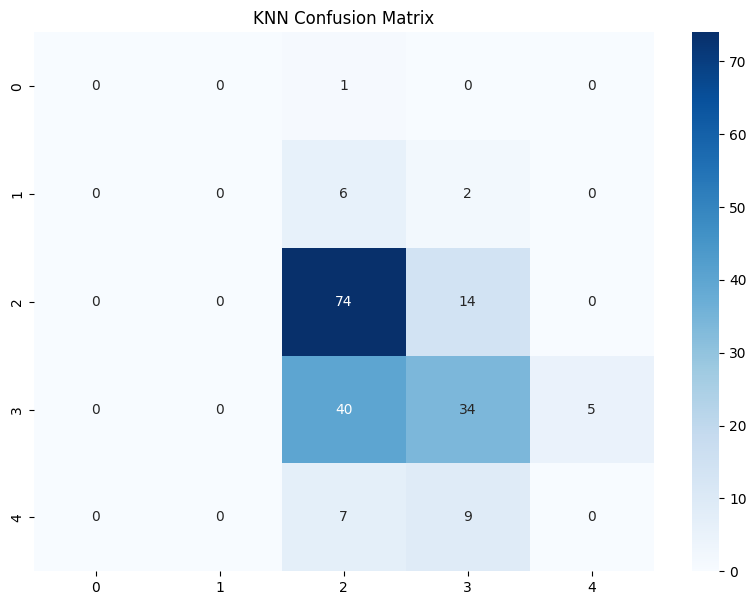

In [149]:
print("Unchanged Data")
knn_classifier_test(wine_features, wine_labels[int(len(wine_labels)/2):], show_confusion=False, knn = 10)

print("Split A")
knn_classifier_test(wine_split_A, wine_labels[int(len(wine_labels)/2):], show_confusion=False, knn = 10)

print("Split B")
knn_classifier_test(wine_split_B, wine_labels[int(len(wine_labels)/2):], show_confusion=False, knn = 10)

print("Embedding")
knn_classifier_test(wine_ECD.emb, wine_labels, show_confusion=False, knn = 10)

print("Predicted Features")
knn_classifier_test(wine_ECD.get_merged_data_set(), wine_labels, show_confusion=False, knn = 10)

#Create our own train test split where the test labels are coming from the important features
X_train, X_test, y_train, y_test = train_test_split(wine_ECD.emb[:wine_ECD.len_A, :], wine_labels[int(len(wine_labels)/2):], test_size = 0.8, random_state = 42)

#Now add the full labels and values from the unimportant set
X_train = np.concatenate([X_train, wine_ECD.emb[wine_ECD.len_A:, :]])
y_train = np.concatenate([y_train, wine_labels[int(len(wine_labels)/2):]])

print("The dropped labels test")
knn_classifier_test_with_data_split(X_train, X_test, y_train, y_test, show_confusion=True, knn =10)


In [150]:
#Since we are litterally changing the features to embedding, the neural network predictions probably are not the best way to test this
neural_network_test(wine_features, wine_labels[int(len(wine_labels)/2):], data_shape= (11,))
neural_network_test(wine_split_A, wine_labels[int(len(wine_labels)/2):], data_shape =(6,))
neural_network_test(wine_split_B, wine_labels[int(len(wine_labels)/2):], data_shape =(5,))
neural_network_test(wine_ECD.emb, wine_labels, data_shape =(5,))
neural_network_test(wine_ECD.get_merged_data_set(), wine_labels, data_shape =(11,))

/yunity/arusty/.local/lib/python3.10/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


ValueError: Dimensions must be equal, but are 32 and 3 for '{{node compile_loss/MSE/sub}} = Sub[T=DT_FLOAT](compile_loss/MSE/Cast, sequential_1/dense_2_1/Softmax)' with input shapes: [32], [32,3].

## Heart Data
This may not be good for similar reasons to the wine data. If the features don't explain the labels well, it might be difficult for our function to work with them

- The embedding preforms better than the split data sets. The predicted features does better than the embedding with Neural Networks (this might be because it has more data to train with), but worse with the KNN

In [ ]:
heart_ECD = ECD(heart_split_A, heart_split_B, heart_anchors[:10], t = -1, knn = 9, link = "full")

Using optimal t value of 15
Applying Page Ranking against the full matrix
Using optimal t value of 18
Applying Page Ranking against the full matrix


In [ ]:
heart_ECD.predict_feature().shape, heart_ECD.predict_feature(predict = "B").shape

((206, 1), (206, 3))

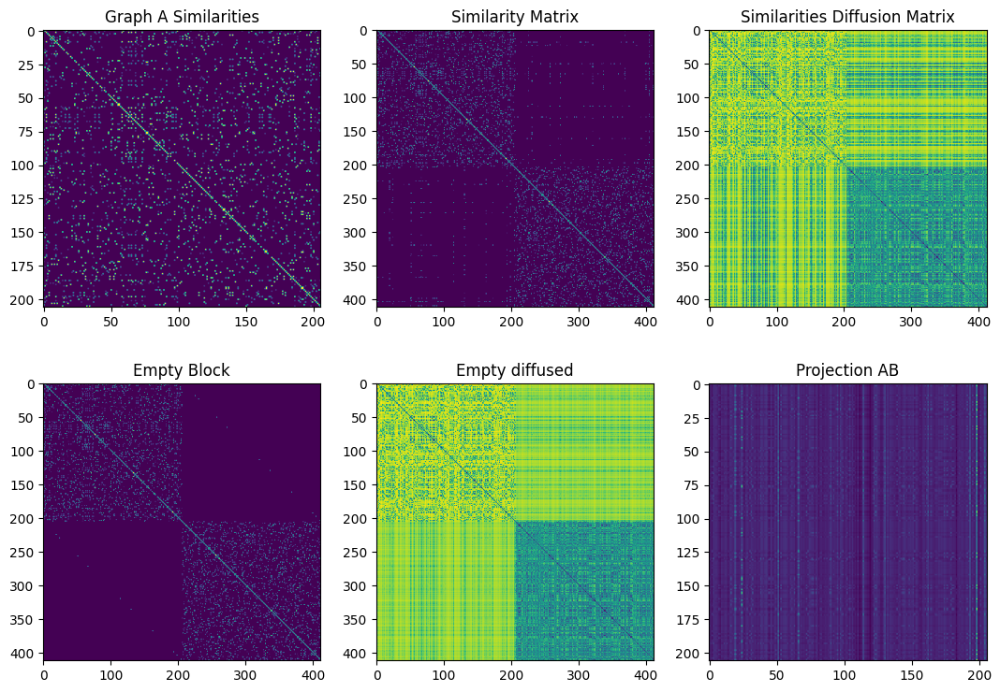

In [ ]:
heart_ECD.plot_graphs()

Model Stress: 556009.5000021821
ECD Cross Embedding: 0.616504854368932
ECD FOSCTTM: 0.49448581393156754


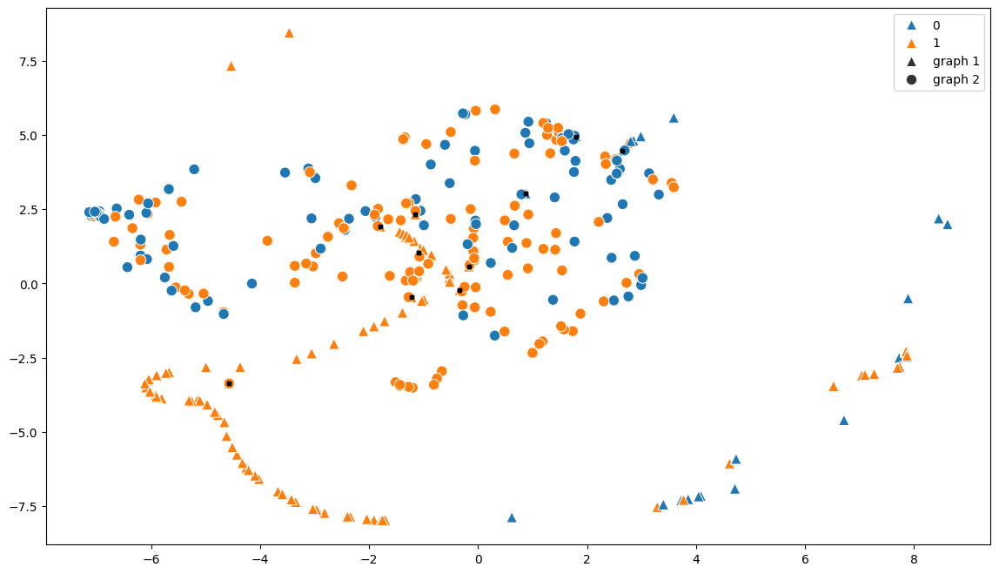

In [ ]:
heart_ECD.plot_emb(heart_labels, heart_ECD.sim_diffusion_matrix, n_comp = 2, show_lines = False)

Original Data
Linear Regression R^2 score: 0.6935483870967742, and MSE score: 0.3064516129032258
KNN accuracy score: 0.6451612903225806
---------------------------------------------------
Split A
Linear Regression R^2 score: 0.6451612903225806, and MSE score: 0.3548387096774194
KNN accuracy score: 0.8870967741935484
---------------------------------------------------
Split B
Linear Regression R^2 score: 0.6451612903225806, and MSE score: 0.3548387096774194
KNN accuracy score: 0.5161290322580645
---------------------------------------------------
Testing on the Embedding
Linear Regression R^2 score: 0.6370967741935484, and MSE score: 0.3629032258064516
KNN accuracy score: 0.7338709677419355
---------------------------------------------------
Testing on predicted data values
Linear Regression R^2 score: 0.5564516129032258, and MSE score: 0.4435483870967742
KNN accuracy score: 0.6048387096774194
---------------------------------------------------
The dropped labels test
Linear Regression 

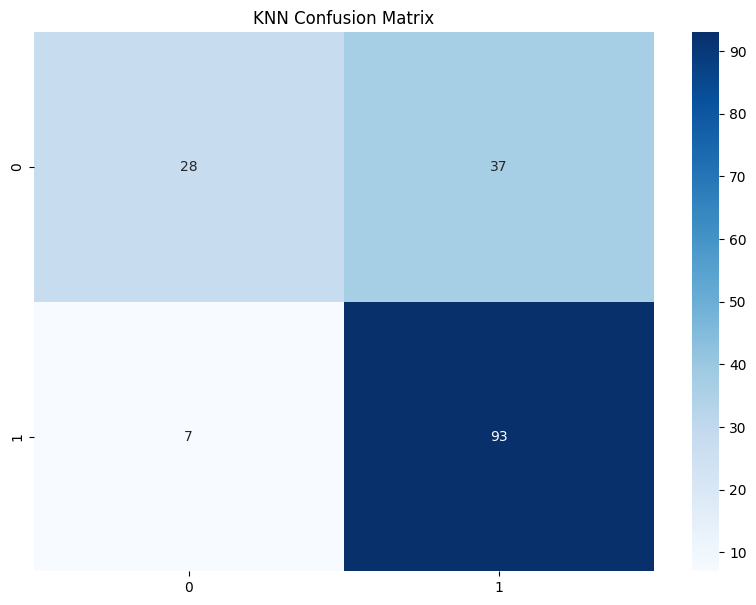

In [ ]:
print("Original Data")
knn_classifier_test(heart_features, heart_labels[int(len(heart_labels)/2):], show_confusion=False, knn = 9)

print("Split A")
knn_classifier_test(heart_split_A, heart_labels[int(len(heart_labels)/2):], show_confusion=False, knn = 9)

print("Split B")
knn_classifier_test(heart_split_B, heart_labels[int(len(heart_labels)/2):], show_confusion=False, knn = 9)

#Is this even a fair comparision? Should we be using the emb?
print("Testing on the Embedding")
knn_classifier_test(heart_ECD.emb, heart_labels, show_confusion=False, knn = 9)

print("Testing on predicted data values")
knn_classifier_test(heart_ECD.get_merged_data_set(), heart_labels, show_confusion=False, knn = 9)

#Create our own train test split where the test labels are coming from the important features
X_train, X_test, y_train, y_test = train_test_split(heart_ECD.emb[:heart_ECD.len_A, :], heart_labels[:int(len(heart_labels)/2)], test_size = 0.8, random_state = 42)

#Now add the full labels and values from the unimportant set
X_train = np.concatenate([X_train, heart_ECD.emb[heart_ECD.len_A:, :]])
y_train = np.concatenate([y_train, heart_labels[int(len(heart_labels)/2):]])

print("The dropped labels test")
knn_classifier_test_with_data_split(X_train, X_test, y_train, y_test, show_confusion=True, knn =9)

In [ ]:
list(range(0, 10))

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9]

In [ ]:
#Since we are litterally changing the features to embedding, the neural network predictions probably are not the best way to test this
neural_network_test(heart_features, heart_labels[int(len(heart_labels)/2):], data_shape= (8,))
neural_network_test(heart_split_A, heart_labels[int(len(heart_labels)/2):], data_shape =(1,))
neural_network_test(heart_split_B, heart_labels[int(len(heart_labels)/2):], data_shape =(3,))
neural_network_test(heart_ECD.emb, heart_labels, data_shape =(2,))
neural_network_test(heart_ECD.get_merged_data_set(), heart_labels, data_shape =(4,))

2/2 [==============================] - 0s 3ms/step - loss: 0.3254 - accuracy: 0.1667
Test loss: 0.3254264295101166, Test accuracy: 0.1666666716337204
2/2 [==============================] - 0s 3ms/step - loss: 0.3254 - accuracy: 0.4524
Test loss: 0.325396865606308, Test accuracy: 0.4523809552192688
2/2 [==============================] - 0s 3ms/step - loss: 0.3254 - accuracy: 0.2619
Test loss: 0.32540860772132874, Test accuracy: 0.261904776096344
3/3 [==============================] - 0s 2ms/step - loss: 0.3120 - accuracy: 0.2651
Test loss: 0.3120141923427582, Test accuracy: 0.2650602459907532
3/3 [==============================] - 0s 2ms/step - loss: 0.3119 - accuracy: 0.3614
Test loss: 0.3119145929813385, Test accuracy: 0.3614457845687866


### Heart with Missing Features in the important data Split
Split A had a score of 0.88 and B had a score of 0.51 

In [ ]:
heart_partial_ECD = ECD(heart_split_B, heart_split_A[:25], np.array(([10, 10], [1,1], [24,24], [6,6])), t = -1, knn = 9, link = "full") #Out of 200 samples

Using optimal t value of 22
Applying Page Ranking against the full matrix
Using optimal t value of 19
Applying Page Ranking against the full matrix


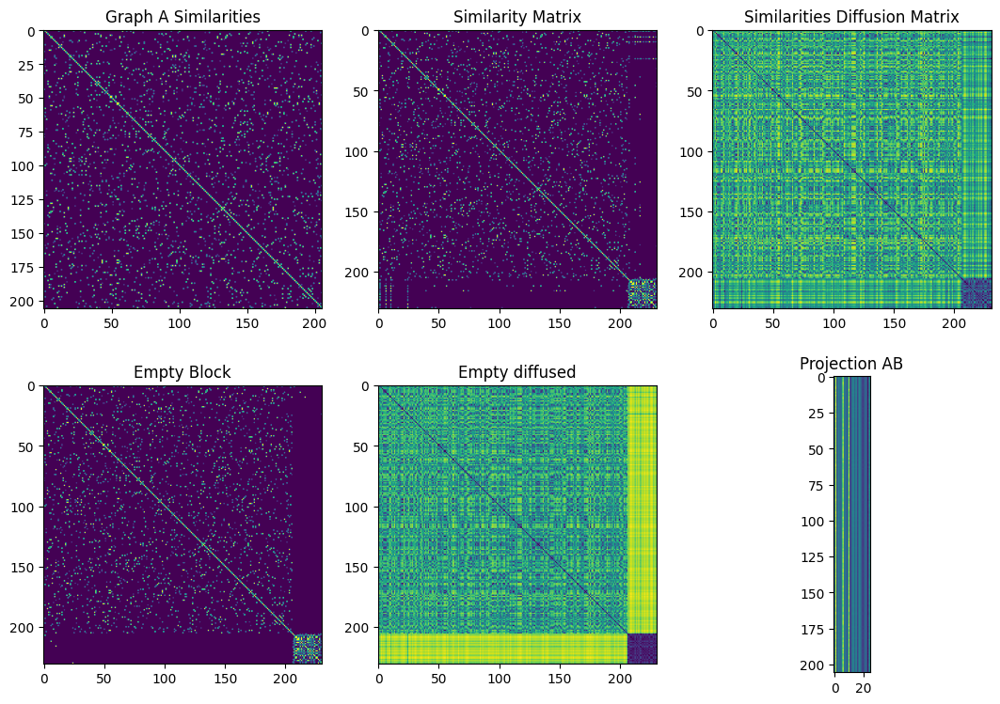

In [ ]:
heart_partial_ECD.plot_graphs()

Model Stress: 63.69346398342052
ECD Cross Embedding: 0.76
Can't compute FOSCTTM with different domain shapes.


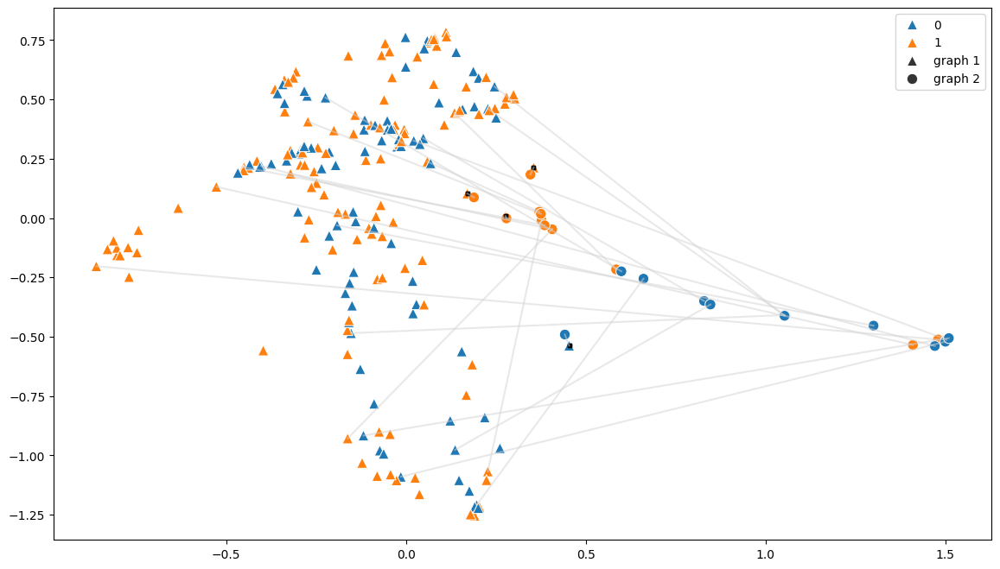

In [ ]:
heart_partial_ECD.plot_emb(heart_labels[:231], heart_partial_ECD.sim_diffusion_matrix, n_comp = 5)

In [ ]:
print("Original Data")
knn_classifier_test(heart_features, heart_labels[int(len(heart_labels)/2):], show_confusion=False, knn = 9)

print("Split A")
knn_classifier_test(heart_split_A[:25], heart_labels[:25], show_confusion=False, knn = 9)

print("Split B")
knn_classifier_test(heart_split_B, heart_labels[int(len(heart_labels)/2):], show_confusion=False, knn = 9)

print("Testing on the Embedding")
knn_classifier_test(heart_partial_ECD.emb, heart_labels[:231], show_confusion=False, knn = 9)

Original Data
Linear Regression R^2 score: 0.6935483870967742, and MSE score: 0.3064516129032258
KNN accuracy score: 0.6451612903225806
---------------------------------------------------
Split A
Linear Regression R^2 score: 0.5, and MSE score: 0.5
KNN accuracy score: 0.875
---------------------------------------------------
Split B
Linear Regression R^2 score: 0.6451612903225806, and MSE score: 0.3548387096774194
KNN accuracy score: 0.5161290322580645
---------------------------------------------------
Testing on the Embedding
Linear Regression R^2 score: 0.5428571428571428, and MSE score: 0.45714285714285713
KNN accuracy score: 0.5857142857142857
---------------------------------------------------


## Iris Split Data
This split seems to be great -> Especially with the added anchors

In [ ]:
iris_ECD = ECD(iris_split_A, iris_split_B, known_anchors[:150], t = -1, knn = 5)

Using optimal t value of 13
Using optimal t value of 18


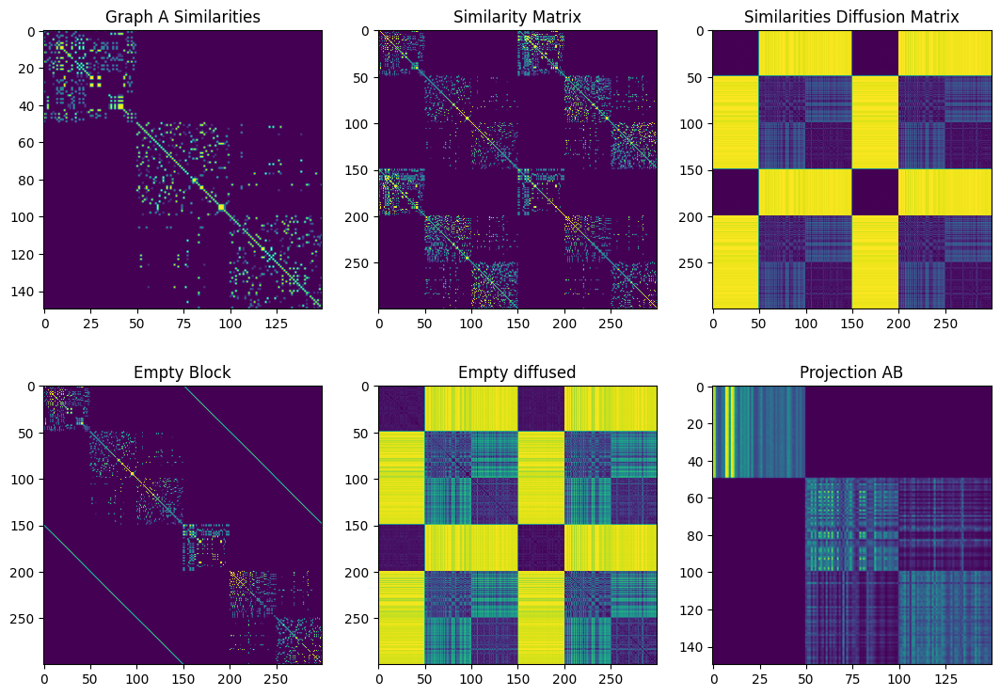

In [ ]:
iris_ECD.plot_graphs()

Model Stress: 321314.41845772136
ECD Cross Embedding: 0.96
ECD FOSCTTM: 0.04364444444444444


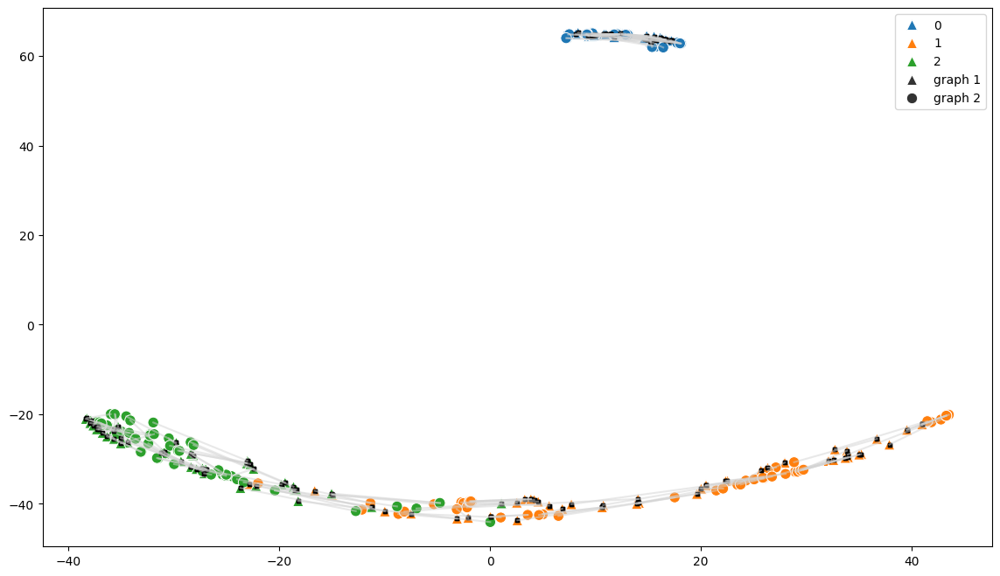

In [ ]:
iris_ECD.plot_emb(labels, iris_ECD.empty_diffused, use_phate = False)

Model Stress: 13458.217547754852
ECD Cross Embedding: 0.9666666666666667
ECD FOSCTTM: 0.018044444444444446


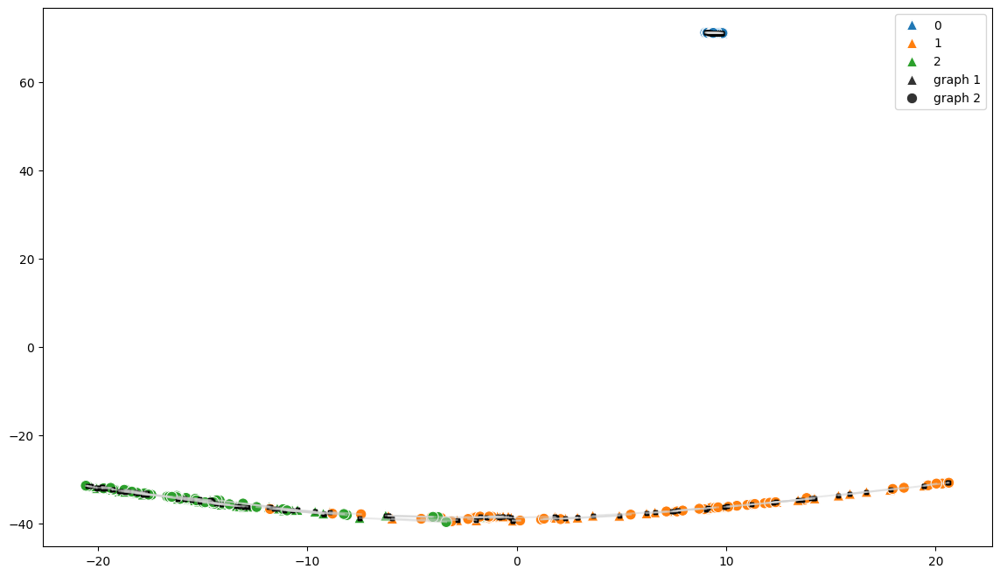

In [ ]:
iris_ECD.plot_emb(labels, iris_ECD.sim_diffusion_matrix, use_phate = False)

Linear Regression R^2 score: 0.9111111111111111, and MSE score: 0.08888888888888889
KNN accuracy score: 1.0
---------------------------------------------------
Linear Regression R^2 score: 0.9111111111111111, and MSE score: 0.08888888888888889
KNN accuracy score: 1.0
---------------------------------------------------
Linear Regression R^2 score: 0.9555555555555556, and MSE score: 0.044444444444444446
KNN accuracy score: 1.0
---------------------------------------------------
Linear Regression R^2 score: 0.9555555555555556, and MSE score: 0.044444444444444446
KNN accuracy score: 0.9555555555555556
---------------------------------------------------
Linear Regression R^2 score: 0.9333333333333333, and MSE score: 0.06666666666666667
KNN accuracy score: 0.9555555555555556
---------------------------------------------------


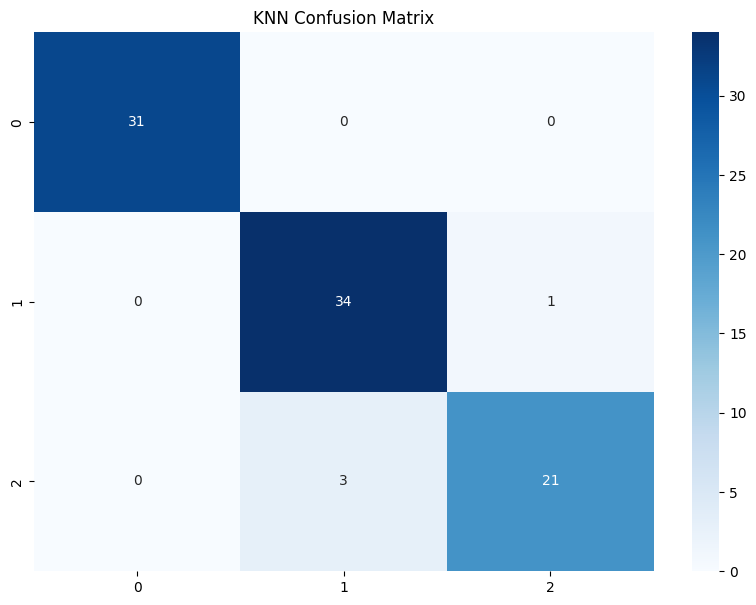

In [ ]:
knn_classifier_test(X, labels1, show_confusion=False, knn = 5)

knn_classifier_test(iris_split_A, labels1, show_confusion=False, knn = 5)

knn_classifier_test(iris_split_B, labels1, show_confusion=False, knn = 5)

#Is this even a fair comparision? Should we be using the emb?
knn_classifier_test(iris_ECD.emb, labels, show_confusion=False, knn = 5)
knn_classifier_test(iris_ECD.get_merged_data_set(), labels, show_confusion=True, knn = 5)

In [ ]:
#This is a very simple model, and so this likely isn't the best way
neural_network_test(X, labels1)
neural_network_test(iris_split_A, labels1, data_shape =(1,))
neural_network_test(iris_split_B, labels1, data_shape =(1,))
neural_network_test(iris_ECD.emb, labels, data_shape =(2,))
neural_network_test(iris_ECD.get_merged_data_set(), labels, data_shape =(2,))

1/1 [==============================] - 0s 91ms/step - loss: 1.1889 - accuracy: 0.3333
Test loss: 1.1889199018478394, Test accuracy: 0.3333333432674408
1/1 [==============================] - 0s 90ms/step - loss: 1.1889 - accuracy: 0.1667
Test loss: 1.1888896226882935, Test accuracy: 0.1666666716337204
1/1 [==============================] - 0s 105ms/step - loss: 1.1889 - accuracy: 0.8667
Test loss: 1.1888930797576904, Test accuracy: 0.8666666746139526
2/2 [==============================] - 0s 4ms/step - loss: 0.9224 - accuracy: 0.3167
Test loss: 0.9223617315292358, Test accuracy: 0.3166666626930237
2/2 [==============================] - 0s 3ms/step - loss: 0.9222 - accuracy: 0.1667
Test loss: 0.9222244024276733, Test accuracy: 0.1666666716337204


## Abalone Dataset

- The Predicted Values is greater on the NN and KNN tests, even compared to the embedding which is greater than the normal

In [ ]:
abalone_ECD = ECD(abalone_split_A, abalone_split_B, abalone_anchors[:175], t = -1, knn = 10)
abalone_ECD2 = ECD(abalone_split_A, abalone_split_B, abalone_anchors[:175], t = -1, knn = 10, link = "full")
abalone_ECD3 = ECD(abalone_split_A, abalone_split_B, abalone_anchors[:175], t = -1, knn = 10, link = "off-diagonal")

Using optimal t value of 18


Using optimal t value of 15
Using optimal t value of 18
Applying Page Ranking against the full matrix
Using optimal t value of 15
Applying Page Ranking against the full matrix
Using optimal t value of 18
Applying Rage Ranking against the off-diagonal parts of the matrix
Using optimal t value of 15
Applying Rage Ranking against the off-diagonal parts of the matrix


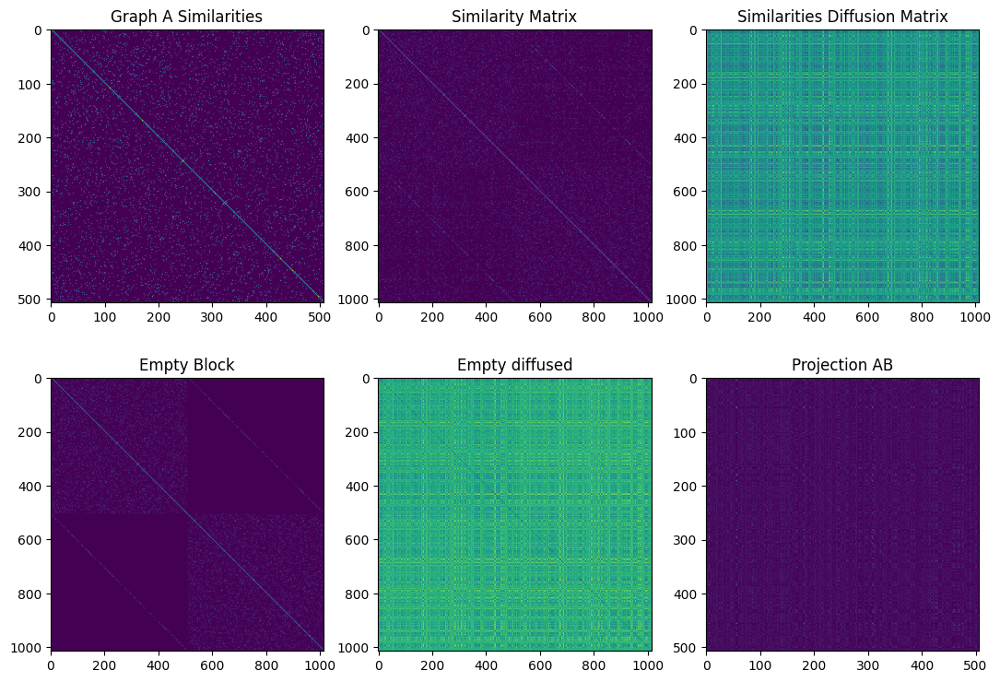

In [ ]:
abalone_ECD.plot_graphs()

No page ranking applied
Model Stress: 14539.78425313069
ECD Cross Embedding: 0.33727810650887574
ECD FOSCTTM: 0.012635723150060884


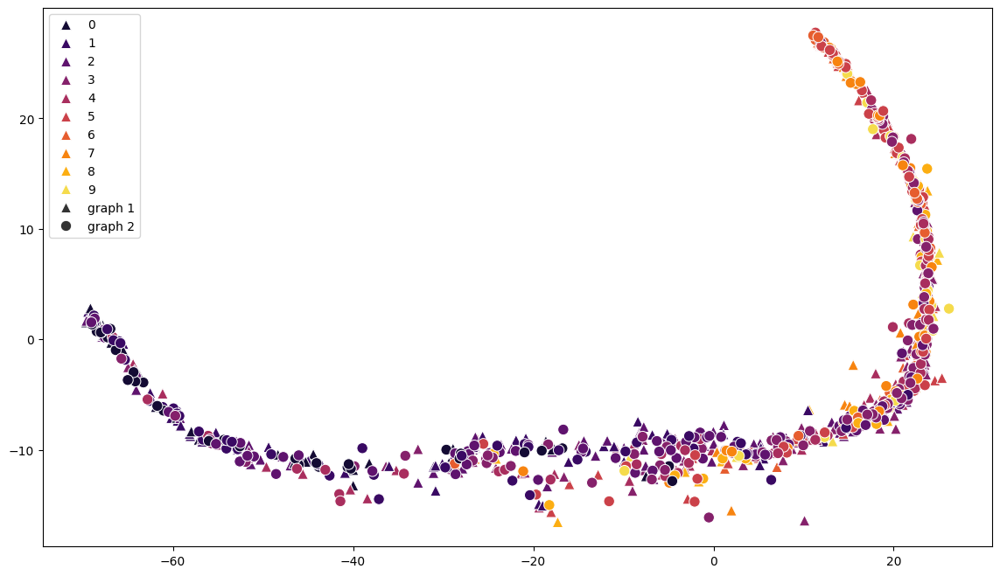

/Users/user/Desktop/Work/.conda/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Linear Regression R^2 score: 0.3180327868852459, and MSE score: 3.740983606557377
KNN accuracy score: 0.26557377049180325
---------------------------------------------------


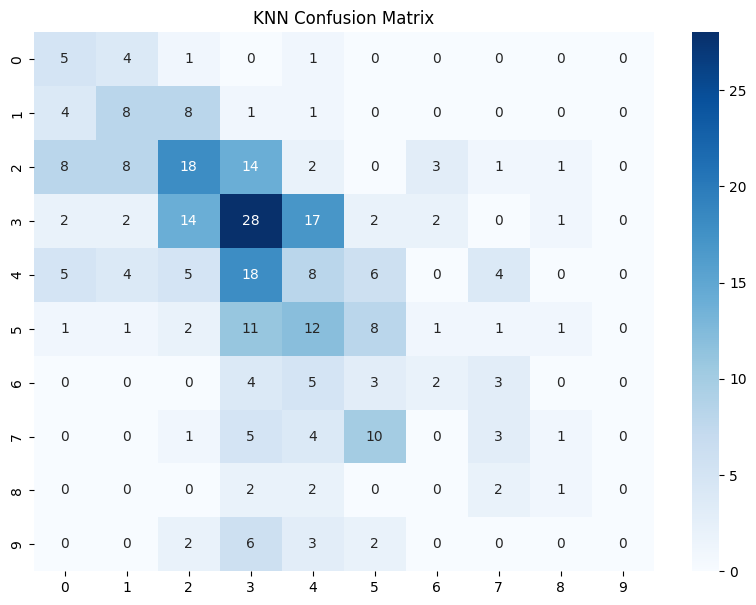

Full Page ranking applied
Model Stress: 2775.2044979162188
ECD Cross Embedding: 0.30177514792899407
ECD FOSCTTM: 0.05186559760979424


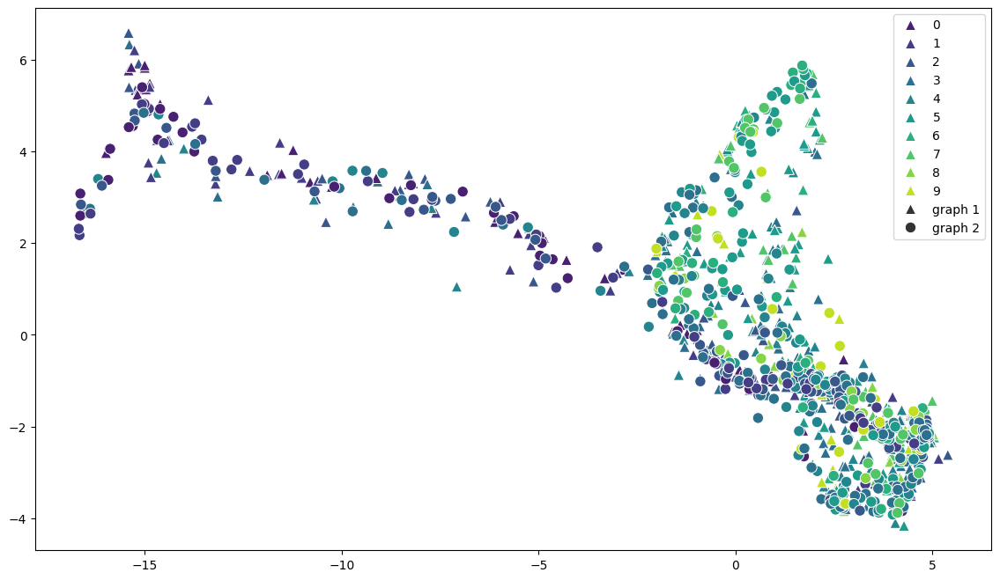

/Users/user/Desktop/Work/.conda/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Linear Regression R^2 score: 0.26229508196721313, and MSE score: 4.075409836065574
KNN accuracy score: 0.29508196721311475
---------------------------------------------------


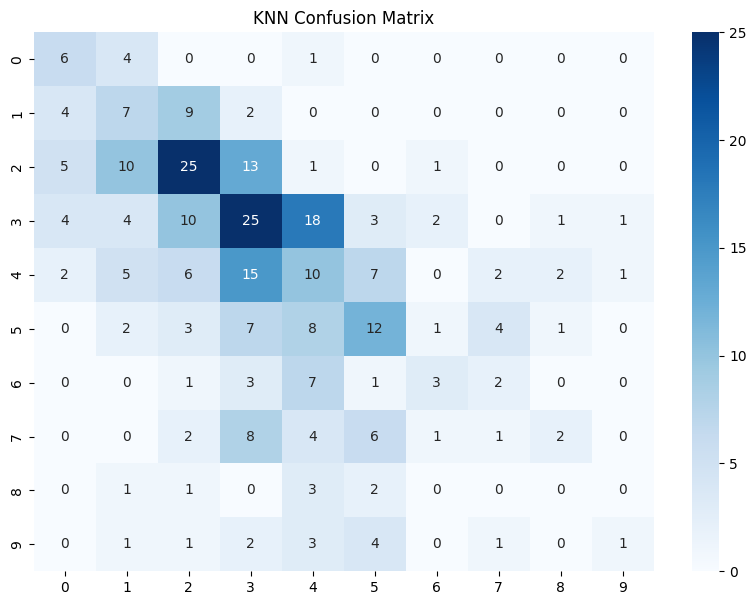

Off-diagonal Page Ranking applied
Model Stress: 3077.229112844316
ECD Cross Embedding: 0.2978303747534517
ECD FOSCTTM: 0.05192006193371692


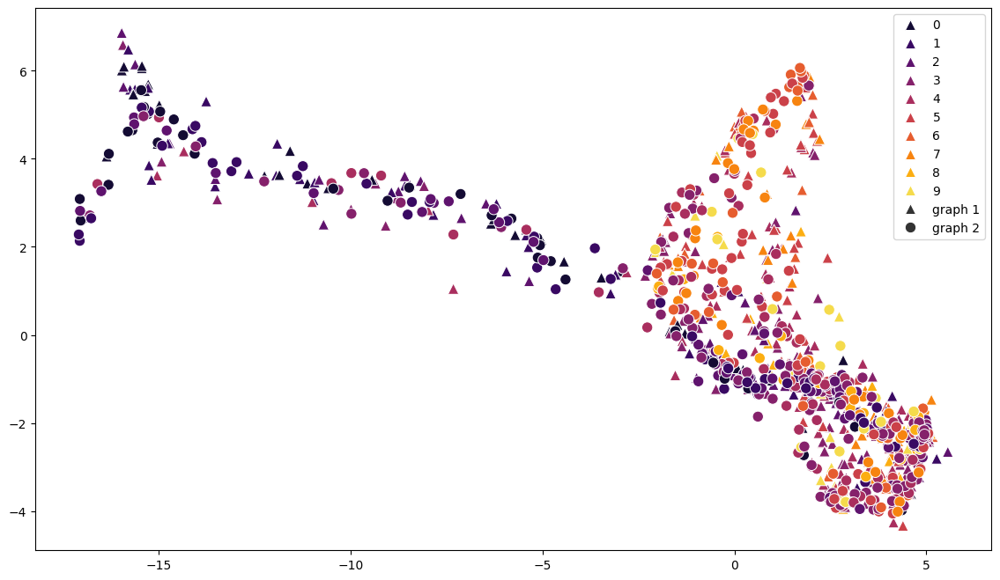

/Users/user/Desktop/Work/.conda/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Linear Regression R^2 score: 0.2721311475409836, and MSE score: 4.0950819672131145
KNN accuracy score: 0.3016393442622951
---------------------------------------------------


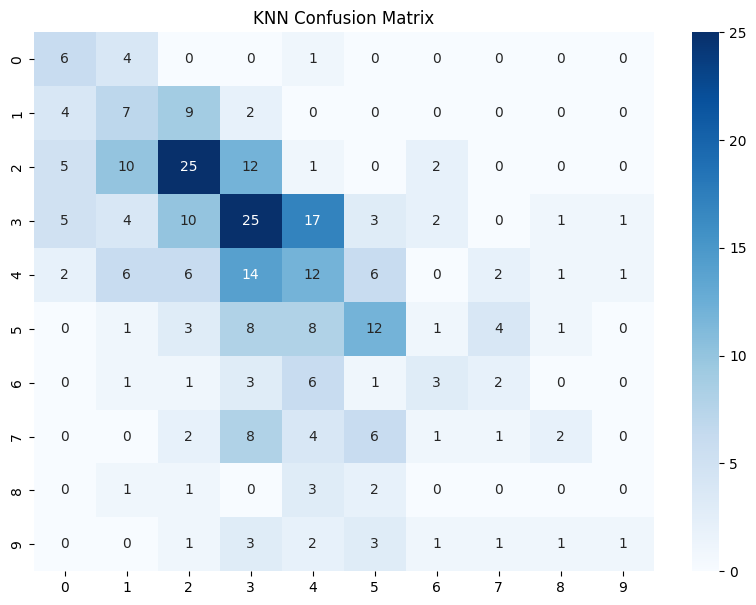

In [ ]:
print("No page ranking applied")
abalone_ECD.plot_emb(abalone_labels, abalone_ECD.sim_diffusion_matrix, n_comp = 8, show_lines = False, show_anchors = False,  palette = "inferno")
knn_classifier_test(abalone_ECD.emb, abalone_labels, show_confusion=True, knn = 10)

print("Full Page ranking applied")
abalone_ECD2.plot_emb(abalone_labels, abalone_ECD2.sim_diffusion_matrix, n_comp = 8, show_lines = False, show_anchors = False, palette = "viridis")
knn_classifier_test(abalone_ECD2.emb, abalone_labels, show_confusion=True, knn = 10)

print("Off-diagonal Page Ranking applied")
abalone_ECD3.plot_emb(abalone_labels, abalone_ECD3.sim_diffusion_matrix, n_comp = 8, show_lines = False, show_anchors = False,  palette = "inferno")
knn_classifier_test(abalone_ECD3.emb, abalone_labels, show_confusion=True, knn = 10)

In [ ]:
#abalone_ECD.test_projection(abalone_labels)

In [ ]:
print("Original Data")
knn_classifier_test(abalone_features, abalone_labels[int(len(abalone_labels)/2):], show_confusion=False, knn = 10)

print("Split A")
knn_classifier_test(abalone_split_A, abalone_labels[int(len(abalone_labels)/2):], show_confusion=False, knn = 10)

print("Split B")
knn_classifier_test(abalone_split_B, abalone_labels[int(len(abalone_labels)/2):], show_confusion=False, knn = 10)

#We can visually see from the confusion matrix that the combined does much better!
print("The No linked embedding")
knn_classifier_test(abalone_ECD.emb, abalone_labels, show_confusion=False, knn = 10)

#print("Just with the similarity Matrix")
#knn_classifier_test(abalone_ECD.sim_diffusion_matrix, abalone_labels, show_confusion=False, knn = 10)

print("Using Predicted Features (This is an attempt to get a better train test split)")
knn_classifier_test(abalone_ECD.get_merged_data_set(), abalone_labels, show_confusion=False, knn = 10)

#Create our own train test split where the test labels are coming from the important features
X_train, X_test, y_train, y_test = train_test_split(abalone_ECD.emb[:abalone_ECD.len_A, :], abalone_labels[int(len(abalone_labels)/2):], test_size = 1, random_state = 42)

#Now add the full labels and values from the unimportant set
X_train = np.concatenate([X_train, abalone_ECD.emb[abalone_ECD.len_A:, :]])
y_train = np.concatenate([y_train, abalone_labels[int(len(abalone_labels)/2):]])

print("The dropped labels test")
knn_classifier_test_with_data_split(X_train, X_test, y_train, y_test, show_confusion=False, knn =10)

Original Data
Linear Regression R^2 score: 0.24836601307189543, and MSE score: 4.209150326797386
KNN accuracy score: 0.26143790849673204
---------------------------------------------------
Split A
Linear Regression R^2 score: 0.24183006535947713, and MSE score: 4.045751633986928
KNN accuracy score: 0.2679738562091503
---------------------------------------------------
Split B
Linear Regression R^2 score: 0.26143790849673204, and MSE score: 4.34640522875817
KNN accuracy score: 0.23529411764705882
---------------------------------------------------
The No linked embedding


AttributeError: 'ECD' object has no attribute 'emb'

In [ ]:
#Since we are litterally changing the features to embedding, the neural network predictions probably are not the best way to test this
neural_network_test(abalone_features, abalone_labels[int(len(abalone_labels)/2):], data_shape= (8,))
neural_network_test(abalone_split_A, abalone_labels[int(len(abalone_labels)/2):], data_shape =(4,))
neural_network_test(abalone_split_B, abalone_labels[int(len(abalone_labels)/2):], data_shape =(4,))
neural_network_test(abalone_ECD.emb, abalone_labels, data_shape =(8,))
neural_network_test(abalone_ECD2.emb, abalone_labels, data_shape =(8,))
neural_network_test(abalone_ECD3.emb, abalone_labels, data_shape =(8,))
neural_network_test(abalone_ECD.get_merged_data_set(), abalone_labels, data_shape = (8,))

4/4 [==============================] - 0s 2ms/step - loss: 16.5882 - accuracy: 0.1176
Test loss: 16.588237762451172, Test accuracy: 0.11764705926179886
4/4 [==============================] - 0s 2ms/step - loss: 16.5882 - accuracy: 0.1176
Test loss: 16.58823585510254, Test accuracy: 0.11764705926179886
4/4 [==============================] - 0s 2ms/step - loss: 16.5882 - accuracy: 0.1275
Test loss: 16.58823585510254, Test accuracy: 0.12745098769664764
7/7 [==============================] - 0s 1ms/step - loss: 18.3318 - accuracy: 0.0887
Test loss: 18.33182716369629, Test accuracy: 0.08866994827985764
7/7 [==============================] - 0s 1ms/step - loss: 18.3312 - accuracy: 0.1330
Test loss: 18.33121681213379, Test accuracy: 0.13300491869449615
7/7 [==============================] - 0s 1ms/step - loss: 18.3312 - accuracy: 0.0837
Test loss: 18.331235885620117, Test accuracy: 0.08374384045600891
7/7 [==============================] - 0s 1ms/step - loss: 18.3311 - accuracy: 0.1034
Test l

### Abalone Tests Summary
No Page Rank | Full Page Rank | Off-diagonal Page Rank 
> FOSCTTM SCORES
-  0.0523 - - - - - 0.0497 - - - - - - 0.0501
> KNN Test Scores
-  0.2524 - - - - - 0.2491 - - - - - - 0.2525

## Removal of features

Using this cancer dataset: https://www.kaggle.com/datasets/erdemtaha/cancer-data

In [ ]:
cancerDF = pd.read_csv("Cancer_Data.csv")
cancerDF.drop(["Unnamed: 32", "id"], axis = 1, inplace = True)
cancerDF.head()

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,...,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


In [ ]:
cancerDF.drop("diagnosis", axis=1, inplace=False).corr()
#Features with high Correlation to important features of 6,7 are: 0, 2, 3, 5

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
radius_mean,1.000000,0.323782,0.997855,0.987357,0.170581,0.506124,0.676764,0.822529,0.147741,-0.311631,...,0.969539,0.297008,0.965137,0.941082,0.119616,0.413463,0.526911,0.744214,0.163953,0.007066
texture_mean,0.323782,1.000000,0.329533,0.321086,-0.023389,0.236702,0.302418,0.293464,0.071401,-0.076437,...,0.352573,0.912045,0.358040,0.343546,0.077503,0.277830,0.301025,0.295316,0.105008,0.119205
perimeter_mean,0.997855,0.329533,1.000000,0.986507,0.207278,0.556936,0.716136,0.850977,0.183027,-0.261477,...,0.969476,0.303038,0.970387,0.941550,0.150549,0.455774,0.563879,0.771241,0.189115,0.051019
area_mean,0.987357,0.321086,0.986507,1.000000,0.177028,0.498502,0.685983,0.823269,0.151293,-0.283110,...,0.962746,0.287489,0.959120,0.959213,0.123523,0.390410,0.512606,0.722017,0.143570,0.003738
smoothness_mean,0.170581,-0.023389,0.207278,0.177028,1.000000,0.659123,0.521984,0.553695,0.557775,0.584792,...,0.213120,0.036072,0.238853,0.206718,0.805324,0.472468,0.434926,0.503053,0.394309,0.499316
compactness_mean,0.506124,0.236702,0.556936,0.498502,0.659123,1.000000,0.883121,0.831135,0.602641,0.565369,...,0.535315,0.248133,0.590210,0.509604,0.565541,0.865809,0.816275,0.815573,0.510223,0.687382
concavity_mean,0.676764,0.302418,0.716136,0.685983,0.521984,0.883121,1.000000,0.921391,0.500667,0.336783,...,0.688236,0.299879,0.729565,0.675987,0.448822,0.754968,0.884103,0.861323,0.409464,0.514930
concave points_mean,0.822529,0.293464,0.850977,0.823269,0.553695,0.831135,0.921391,1.000000,0.462497,0.166917,...,0.830318,0.292752,0.855923,0.809630,0.452753,0.667454,0.752399,0.910155,0.375744,0.368661
symmetry_mean,0.147741,0.071401,0.183027,0.151293,0.557775,0.602641,0.500667,0.462497,1.000000,0.479921,...,0.185728,0.090651,0.219169,0.177193,0.426675,0.473200,0.433721,0.430297,0.699826,0.438413
fractal_dimension_mean,-0.311631,-0.076437,-0.261477,-0.283110,0.584792,0.565369,0.336783,0.166917,0.479921,1.000000,...,-0.253691,-0.051269,-0.205151,-0.231854,0.504942,0.458798,0.346234,0.175325,0.334019,0.767297


In [ ]:
cancer_features, cancer_labels = dataprep(cancerDF.sample(frac=0.852, random_state= 42), label_col_idx=0) 

#Generate anchors
rand_ints_cancer = random.sample(range(len(cancer_features)), len(cancer_features)) #The second number here determines how many Known anchors we want
cancer_anchors = np.vstack([rand_ints_cancer, rand_ints_cancer]).T

len(cancer_features), cancer_labels.shape

(485, (485,))

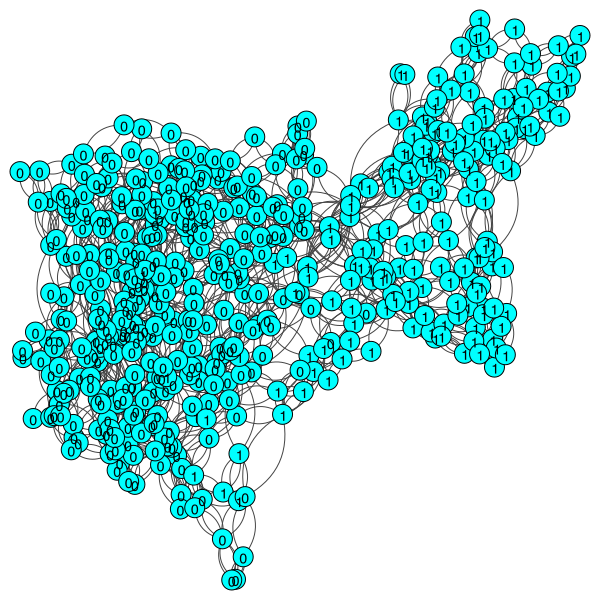

In [ ]:
#All features graph -- We see that there seems to be deterministic features to seperate the two classes well
cancer_test_graph = graphtools.Graph(cancer_features, knn = 2, decay = 40)
ig.plot(cancer_test_graph.to_igraph(), vertex_color = ["cyan"], vertex_label = list(cancer_labels))


In [ ]:
#Using only the mean features
cancer_features = cancer_features[:, [0,1,2,3,4,5,6,7,8,9]]
print_feature_importance(cancer_features, cancer_labels)

Feature 9, Importance: -0.0010
Feature 8, Importance: -0.0003
Feature 4, Importance: 0.0017
Feature 2, Importance: 0.0089
Feature 5, Importance: 0.0093
Feature 1, Importance: 0.0124
Feature 0, Importance: 0.0144
Feature 3, Importance: 0.0196
Feature 6, Importance: 0.0230
Feature 7, Importance: 0.0323


In [ ]:
#Features with high Correlation to 6 and 7
#Our goal is to split the data so the important features are in one set, and the unimportant that have covariance with the other in the other set
cancer_split_important = cancer_features[:, [3, 6, 7]]
cancer_split_unimportant = cancer_features[:, [2, 5]] #3 and 0 are also highly correlated with 6,7: but they have more feature importance. 2 Is very highly correlated with 3

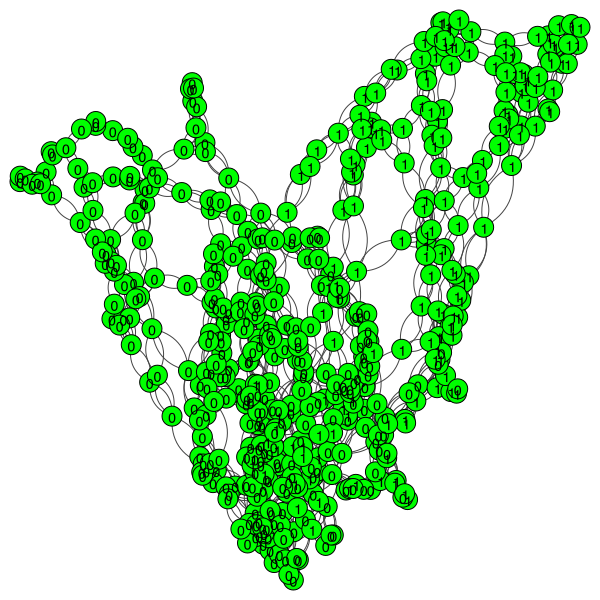

In [ ]:
#Split features graph -- We see that the graph connections are a little worse, but that there is still distinction of areas of connection
cancer_import_graph = graphtools.Graph(cancer_split_important, knn = 3, decay = 40)
ig.plot(cancer_import_graph.to_igraph(), vertex_color = ["green"], vertex_label = list(cancer_labels))

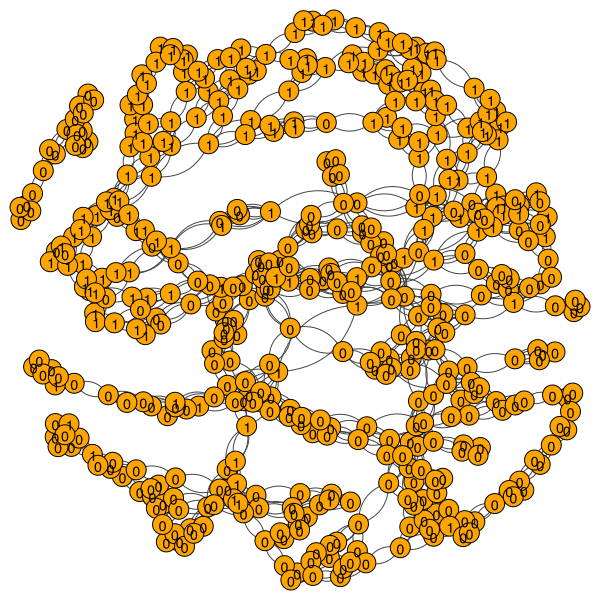

In [ ]:
#Split features graph -- We see that the graph connections are definitely worse, but that there is still distinction of areas of connection
cancer_unimport_graph = graphtools.Graph(cancer_split_unimportant, knn = 3, decay = 40)
ig.plot(cancer_unimport_graph.to_igraph(), vertex_color = ["orange"], vertex_label = list(cancer_labels))

In [ ]:
#Second split methodology 
#Our goal is to split the data so the important features are in one set, and the unimportant that have covariance with the other in the other set
cancer_split_important2 = cancer_features[:, [7]]
cancer_split_unimportant2 = cancer_features[:, [2, 0, 5]] #We are seeing if having differing amounts of kept features afffects the importance of the split

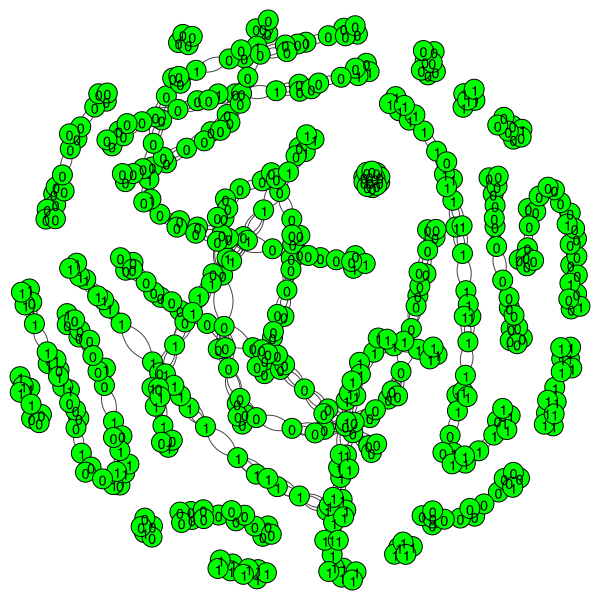

In [ ]:
#Split features graph -- We see that the graph connections are definitely worse, but that there is still distinction of areas of connection
cancer_import_graph = graphtools.Graph(cancer_split_important2, knn = 3, decay = 40)
ig.plot(cancer_import_graph.to_igraph(), vertex_color = ["green"], vertex_label = list(cancer_labels))

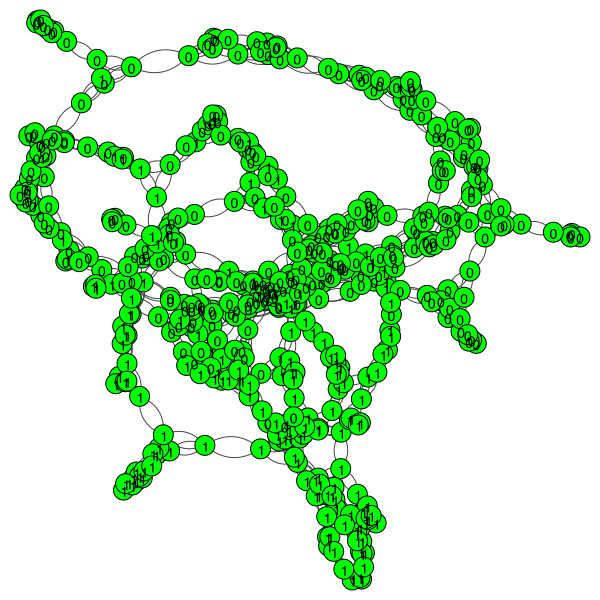

In [ ]:
#Split features graph -- We see that the graph connections are definitely worse, but that there is still distinction of areas of connection
cancer_import_graph = graphtools.Graph(cancer_split_unimportant2, knn = 3, decay = 40)
ig.plot(cancer_import_graph.to_igraph(), vertex_color = ["green"], vertex_label = list(cancer_labels))

In [ ]:
cancer_labels_combined = np.concatenate([cancer_labels, cancer_labels])

### Removal of Features Tests

Notes:
- When we reduce it down to one feature in one dataset and keep another dataset with multiple, the embedding becomes more like the dataset with only one feature. In a way, this seems to emphasis the importance of that feature over all the other features

In [ ]:
cancer_ECD = ECD(cancer_split_important, cancer_split_unimportant, cancer_anchors[:45], t = -1, link = "None", knn = 10)

Using optimal t value of 19
Using optimal t value of 19


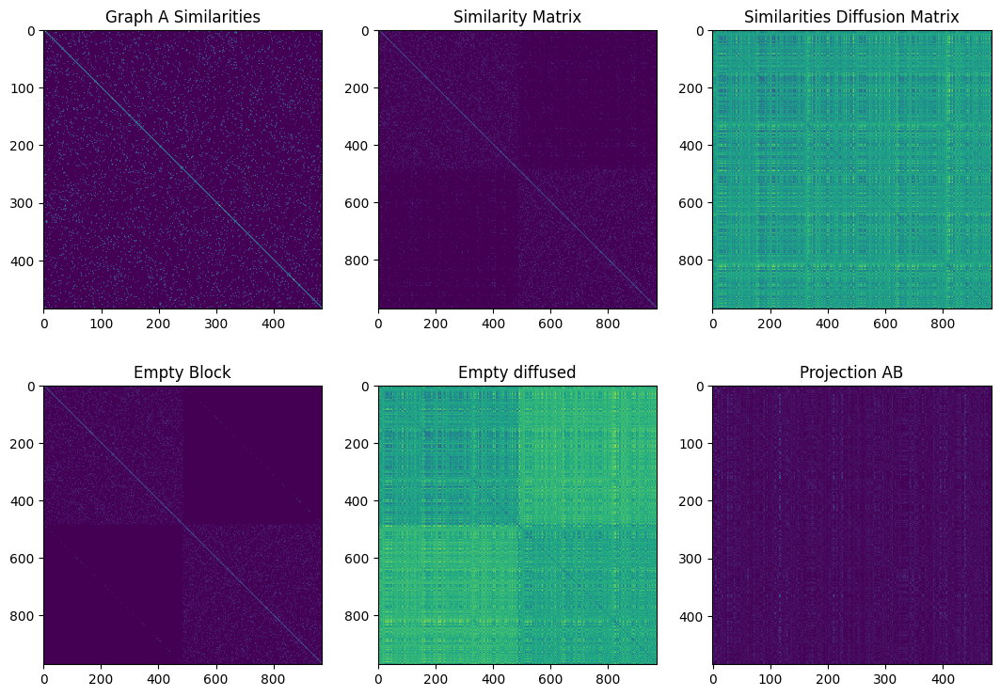

In [ ]:
cancer_ECD.plot_graphs()

Model Stress: 43393357.0817284
ECD Cross Embedding: 0.8865979381443299
ECD FOSCTTM: 0.059032840897013494


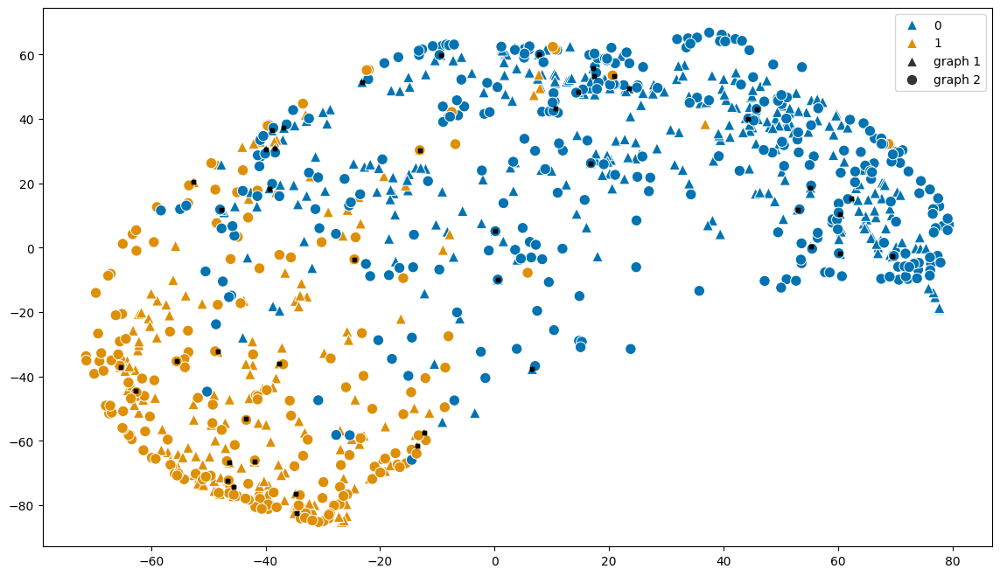

In [ ]:
cancer_ECD.plot_emb(cancer_labels_combined, cancer_ECD.sim_diffusion_matrix, n_comp = 2, show_lines = False, palette = "colorblind")

Using optimal t value of 33
Using optimal t value of 58
Model Stress: 34453047.628742225
ECD Cross Embedding: 0.845360824742268
ECD FOSCTTM: 0.22534169412264854


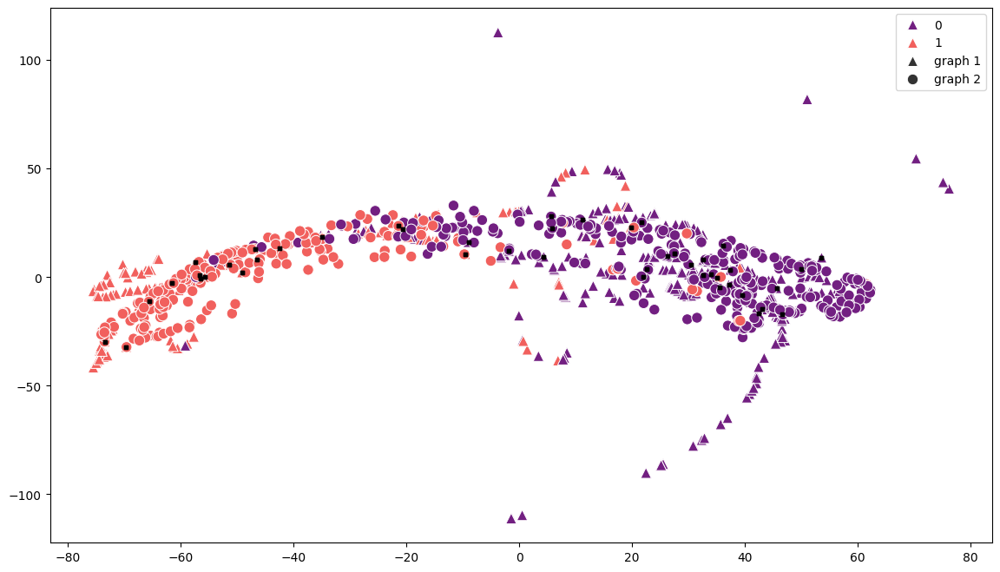

In [ ]:
cancer2_ECD = ECD(cancer_split_important2, cancer_split_unimportant2, cancer_anchors[:45], t = -1, link = "None", knn = 10)
cancer2_ECD.plot_emb(cancer_labels_combined, cancer2_ECD.sim_diffusion_matrix, n_comp = 2, show_lines = False, palette = "magma")

In [ ]:
#Try it on the tests
KNN = 4
print("Original Data")
knn_classifier_test(cancer_features, cancer_labels, show_confusion=False, knn = KNN)

print("Split A (Important Features)")
knn_classifier_test(cancer_split_important, cancer_labels, show_confusion=False, knn = KNN)

print("Split B (Unimportant Features)")
knn_classifier_test(cancer_split_unimportant, cancer_labels, show_confusion=False, knn = KNN)

#We can visually see from the confusion matrix that the combined does much better!
print("Our Embedding with multiple important features -- No Page Link applied")
knn_classifier_test(cancer_ECD.emb, cancer_labels_combined , show_confusion=False, knn = KNN)

print("Our Embedding with multiple unimportant features -- No Page Link applied")
knn_classifier_test(cancer2_ECD.emb, cancer_labels_combined , show_confusion=False, knn = KNN)

Original Data
Linear Regression R^2 score: 0.910958904109589, and MSE score: 0.08904109589041095
KNN accuracy score: 0.9383561643835616
---------------------------------------------------
Split A (Important Features)
Linear Regression R^2 score: 0.8972602739726028, and MSE score: 0.10273972602739725
KNN accuracy score: 0.9178082191780822
---------------------------------------------------
Split B (Unimportant Features)
Linear Regression R^2 score: 0.8767123287671232, and MSE score: 0.1232876712328767
KNN accuracy score: 0.8904109589041096
---------------------------------------------------
Our Embedding with multiple important features -- No Page Link applied
Linear Regression R^2 score: 0.9106529209621993, and MSE score: 0.08934707903780069
KNN accuracy score: 0.9037800687285223
---------------------------------------------------
Our Embedding with multiple unimportant features -- No Page Link applied
Linear Regression R^2 score: 0.9106529209621993, and MSE score: 0.08934707903780069


### Dropping Labels Test

The dropped labels test
Linear Regression R^2 score: 0.8930041152263375, and MSE score: 0.10699588477366255
KNN accuracy score: 0.8847736625514403
---------------------------------------------------


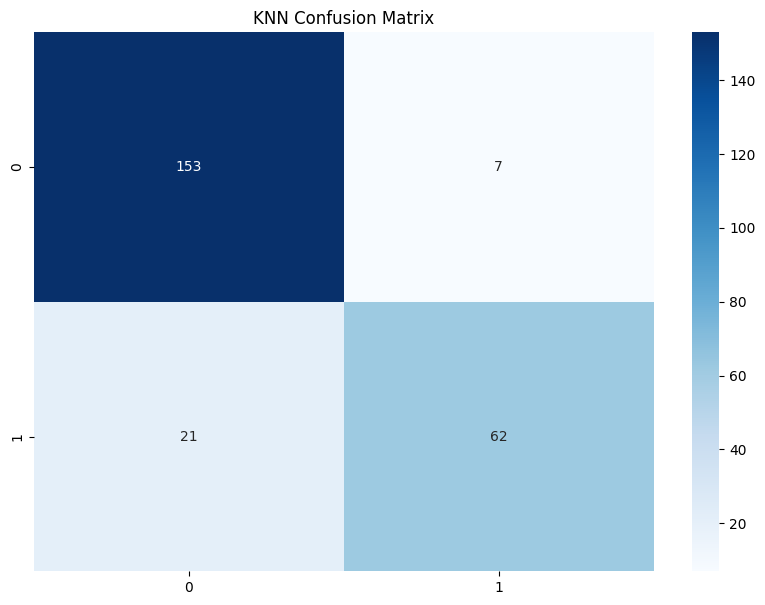

In [ ]:
#Create our own train test split where the test labels are coming from the important features
X_train, X_test, y_train, y_test = train_test_split(cancer2_ECD.emb[:cancer2_ECD.len_A, :], cancer_labels, test_size = 0.5, random_state = 42)

#Now add the full labels and values from the unimportant set
X_train = np.concatenate([X_train, cancer2_ECD.emb[cancer2_ECD.len_A:, :]])
y_train = np.concatenate([y_train, cancer_labels])

print("The dropped labels test")
knn_classifier_test_with_data_split(X_train, X_test, y_train, y_test, show_confusion=True, knn =KNN)

Original Data
Linear Regression R^2 score: 0.910958904109589, and MSE score: 0.08904109589041095
KNN accuracy score: 0.9452054794520548
---------------------------------------------------
Split A (Important Features)
Linear Regression R^2 score: 0.8972602739726028, and MSE score: 0.10273972602739725
KNN accuracy score: 0.910958904109589
---------------------------------------------------
Split B (Unimportant Features)
Linear Regression R^2 score: 0.8767123287671232, and MSE score: 0.1232876712328767
KNN accuracy score: 0.8835616438356164
---------------------------------------------------
The dropped labels test
Linear Regression R^2 score: 0.8930041152263375, and MSE score: 0.10699588477366255
KNN accuracy score: 0.8930041152263375
---------------------------------------------------


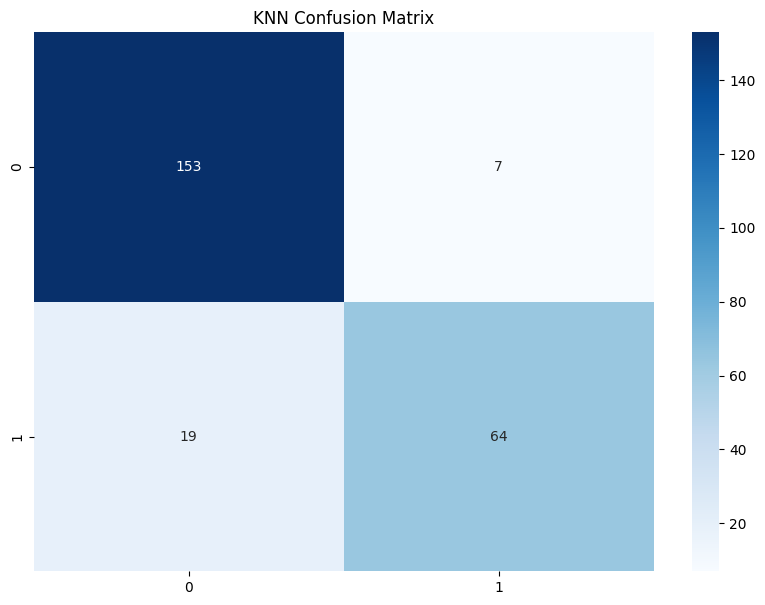

In [ ]:
#Try it on the tests
print("Original Data")
knn_classifier_test(cancer_features, cancer_labels, show_confusion=False, knn = 10)

print("Split A (Important Features)")
knn_classifier_test(cancer_split_important, cancer_labels, show_confusion=False, knn = 10)

print("Split B (Unimportant Features)")
knn_classifier_test(cancer_split_unimportant, cancer_labels, show_confusion=False, knn = 10)

print("The dropped labels test")
knn_classifier_test_with_data_split(X_train, X_test, y_train, y_test, show_confusion=True, knn =10)

# Random Code trials below

The following cells are with the water dataset: https://www.kaggle.com/datasets/nayanack/water-probability

In [ ]:
dataA = np.array([[1,0], [2,1], [0,1], [0,2], [2,1.5]])
dataB = np.array([[0,0], [0.5,1], [0.7,1], [1,2], [0.3,1.2]])
tests = ECD(dataA, dataB, known_anchors=np.array([[1,1]]), knn = 2)

Using optimal t value of 5
Using optimal t value of 11


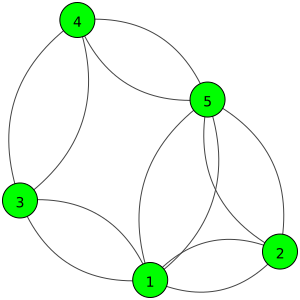

In [ ]:
Sx = graphtools.Graph(dataA, knn = 2, decay = 40) #Knn is the number of how many nearest neighbors it finds
Sy = graphtools.Graph(dataB, knn = 2, decay = 40) #Decay is the rate of alpha decay (Which means the farther it gets the less similar they are)

# sending to igraph objects for more functionality
sx = Sx.to_igraph()
sy = Sy.to_igraph()

ig.plot(sx, vertex_color=['green'], vertex_size = 35, vertex_label= range(1, 6), bbox = (300,300))

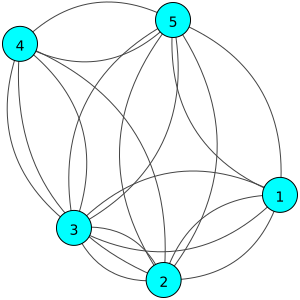

In [ ]:
ig.plot(sy, vertex_color=['cyan'], vertex_size = 35, vertex_label= range(1, 6), bbox = (300,300))

In [ ]:
sx = sx.disjoint_union(sy)
sx.add_edge(1, 6)

igraph.Edge(<igraph.Graph object at 0x7f41c41c5f40>, 30, {'weight': None})

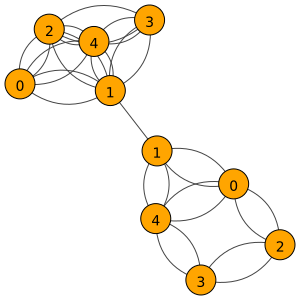

In [ ]:
ig.plot(sx, vertex_color=['orange'], vertex_size = 30, vertex_label= range(0, 5), bbox = (300,300))

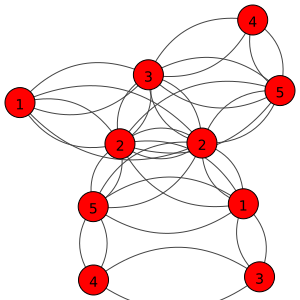

In [ ]:
ig.plot(tests.merge_graphs().to_igraph(), vertex_color=['red'], vertex_size = 30, vertex_label= range(1, 6), bbox = (300,300))

The best T value is 1 with a FOSCTTM of 0


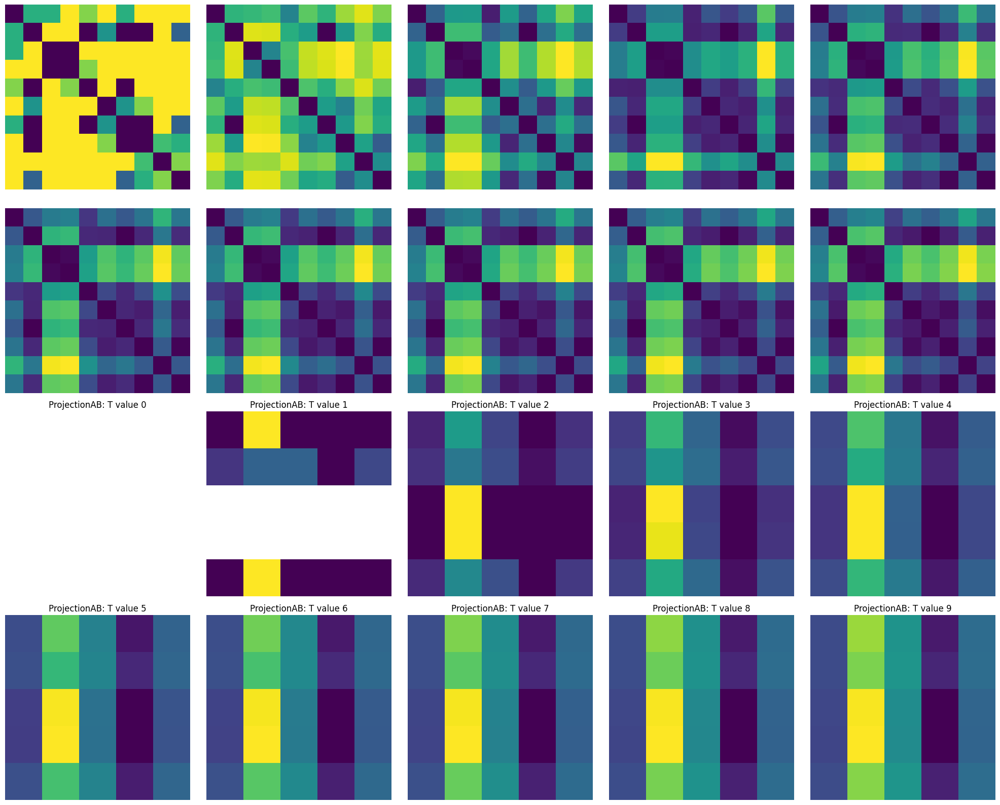

In [ ]:
tests.plot_t_grid(tests.similarity_matrix, rate = 1)